In [11]:
import pandas as pd
import sklearn
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.feature_extraction.text import TfidfVectorizer
import emot
import re
import numpy as np
from collections import defaultdict
from sklearn.decomposition import PCA
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.decomposition import LatentDirichletAllocation
from sklearn.preprocessing import MinMaxScaler
import csv
from sklearn.cluster import KMeans
from wordcloud import WordCloud
import nltk
from nltk.corpus import stopwords
nltk.download('stopwords')

[nltk_data] Downloading package stopwords to
[nltk_data]     /home/rgordon/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


True

In [12]:
# create dictionary of terms with valence, arousal, and dominance rankings

file_name = '/joy/joyData/WordRankings/NRC-VAD-Lexicon.txt'

terms = {}
va = []
ar = []
do = []
counter=0 

# read words file and store valence, arousal, and dominance in a dictionary
with open(file_name, 'r') as f:
    lines=f.readlines()
    
    for row in lines:
        row_=row.split("\t")
        try:
            terms[row_[0]] = counter
            va.append(float(row_[1]))
            ar.append(float(row_[2]))
            do.append(float(row_[3]))
            counter +=1
        except:
            print(row_)

            
'''          
# create a list of all emojis in the dataset

df = pd.read_csv('/joy/joyData/allData')
    
emoji_vocab = []
emot_obj = emot.core.emot()  
for tweet in df['content']:
    emot_dict = emot_obj.emoji(tweet) 
    emojis = emot_dict['value']
    for emoji in emojis:
        if emoji not in emoji_vocab:
            emoji_vocab.append(emoji)
            
            

# add emojis to terms vocabulary
for emoji in emoji_vocab:
    terms[emoji] = counter
    va.append(float(0))
    ar.append(float(0))
    do.append(float(0))
    counter += 1
    
'''    

"          \n# create a list of all emojis in the dataset\n\ndf = pd.read_csv('/joy/joyData/allData')\n    \nemoji_vocab = []\nemot_obj = emot.core.emot()  \nfor tweet in df['content']:\n    emot_dict = emot_obj.emoji(tweet) \n    emojis = emot_dict['value']\n    for emoji in emojis:\n        if emoji not in emoji_vocab:\n            emoji_vocab.append(emoji)\n            \n            \n\n# add emojis to terms vocabulary\nfor emoji in emoji_vocab:\n    terms[emoji] = counter\n    va.append(float(0))\n    ar.append(float(0))\n    do.append(float(0))\n    counter += 1\n    \n"

In [4]:
# vectorization
df = pd.read_csv('/joy/joyData/allData')

count_vectorizer = CountVectorizer(vocabulary=terms, ngram_range=(1,2))
count_vectors = count_vectorizer.fit_transform(df['clean_tweet'].values.astype('U')).toarray()

tfidf_vectorizer = TfidfVectorizer(vocabulary=terms, ngram_range=(1,2))
tfidf_vectors = tfidf_vectorizer.fit_transform(df['clean_tweet'].values.astype('U')).toarray()


In [5]:
# functions to remove unnecessary data

def remove_zeros(vectors):
    
    #print the shape of the original matrix
    print("original matrix size", vectors.shape)

    #mark all-zero columns
    mask = (vectors == 0).all(0)

    # Find the indices of these columns (we might need those)
    column_indices = np.where(mask)[0]

    # Update vectors to only include the columns where non-zero values occur.
    vectors = vectors[:,~mask]

    #print the shape of the new vector matrix
    print("compact matrix size", vectors.shape)
    
    return vectors

def remove_sparse_rows(vectors, n_words):
    return vectors[np.count_nonzero(vectors==0, axis=1) < vectors.shape[1]-n_words]

In [6]:
# CLUSTERING FUNCTIONS

# selecting best value for k
def best_k(vectors):
    
    Sum_of_squared_distances = []
    k = range(4,15)
    for num_clusters in k :
        kmeans = KMeans(n_clusters=num_clusters, max_iter = 1000)
        kmeans.fit(vectors)
        Sum_of_squared_distances.append(kmeans.inertia_)
 
    plt.plot(k,Sum_of_squared_distances,'bx-')
    plt.xlabel('Values of K') 
    plt.ylabel('Sum of squared distances/Inertia') 
    plt.title('Best Number of Clusters')
    plt.show()
    
    
# clustering
def clust(vectors, k):
    model = KMeans(n_clusters=k, init='k-means++', max_iter=1000, n_init=10)
    kmeans_vectors = model.fit_predict(vectors)


    #let's plot the PCA 
    pca = PCA(2)
    pca.fit(vectors)
    docs_pca = pca.transform(vectors)


    plt.figure(figsize = (8, 8))
    plt.grid()
    sns.scatterplot(x=docs_pca[:, 0], y=docs_pca[:, 1], hue=kmeans_vectors, palette=sns.color_palette("bright", k))
    plt.show()
    
    return model


# create word clouds
def word_clouds(base_vectors, clust_model, k):

    k_ = clust_model.predict(base_vectors)

    result={'cluster':k_,'data':df['clean_tweet']}
    result=pd.DataFrame(result)


    stopWords = stopwords.words('english')
    stopWords.extend(['joy', 'amp', 'happy', 'people', 'love', 'chicago', 'time', 'much', 'thank', 'bring', 'day'])

    for k in range(0,k):
       print("Cluster {}\n".format(k))
       s=result[result.cluster==k]
       text=s['data'].str.cat(sep=' ')
       text=' '.join([word for word in text.split() if word.lower() not in stopWords])
       wordcloud = WordCloud(max_font_size=50, max_words=100, background_color="white").generate(text)
  
       plt.figure()
       plt.imshow(wordcloud, interpolation="bilinear")
       plt.axis("off")
       plt.show()

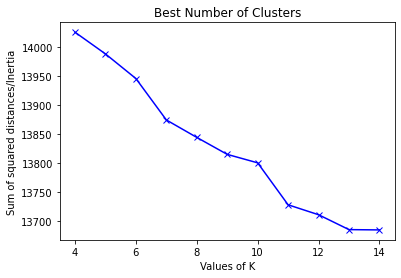

In [6]:
# TFIDF VECTORS CLUSTERING COMPARISON
a = remove_sparse_rows(tfidf_vectors, 1)

tfidf_vectors.shape, a.shape

# selecting best value for k
best_k(a)

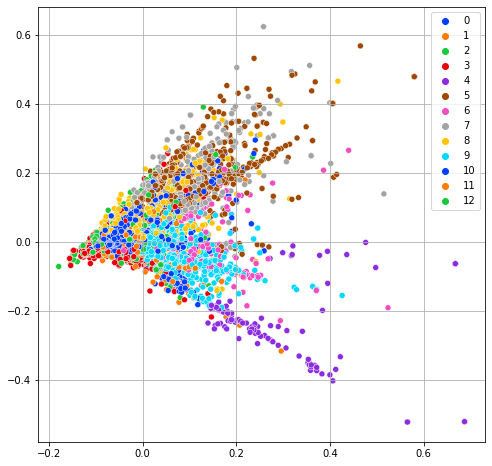

Cluster 0



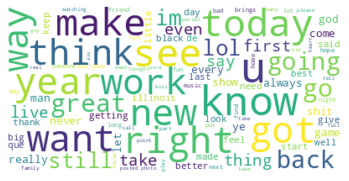

Cluster 1



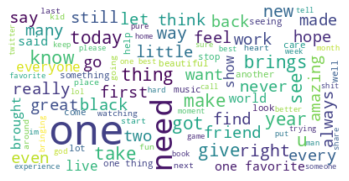

Cluster 2



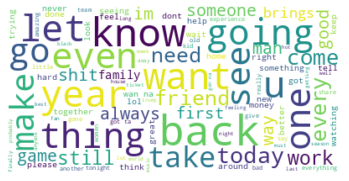

Cluster 3



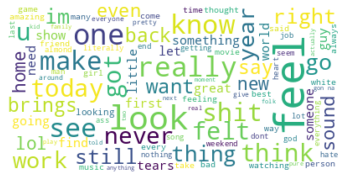

Cluster 4



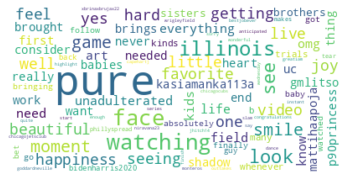

Cluster 5



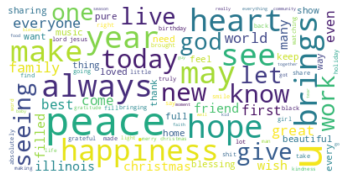

Cluster 6



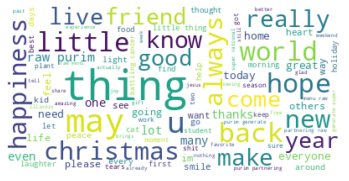

Cluster 7



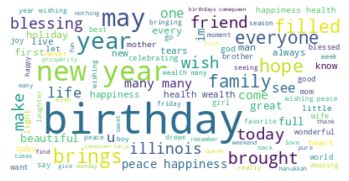

Cluster 8



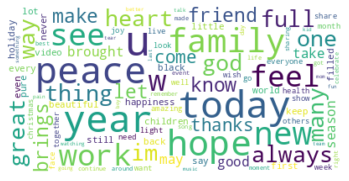

Cluster 9



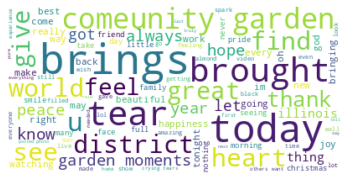

Cluster 10



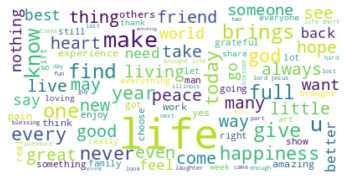

Cluster 11



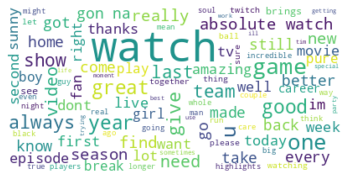

Cluster 12



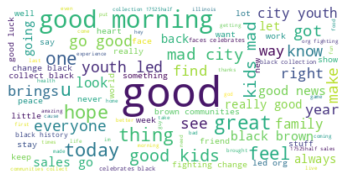

In [7]:
# clustering on tfidf vectors with sparse rows with only 1 word removed
a_model = clust(a, k=13)
word_clouds(tfidf_vectors, a_model, k=13)

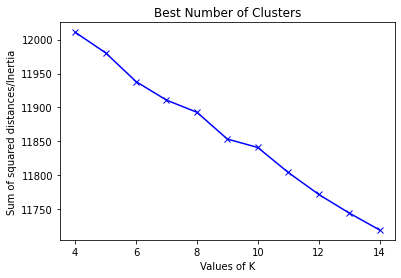

In [8]:
b = remove_sparse_rows(tfidf_vectors, 2)

tfidf_vectors.shape, b.shape

# selecting best value for k
best_k(b)

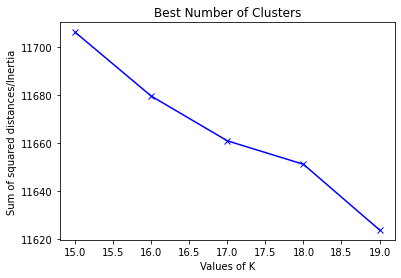

In [10]:
Sum_of_squared_distances = []
k = range(15,20)
for num_clusters in k :
    kmeans = KMeans(n_clusters=num_clusters, max_iter = 1000)
    kmeans.fit(b)
    Sum_of_squared_distances.append(kmeans.inertia_)
 
plt.plot(k,Sum_of_squared_distances,'bx-')
plt.xlabel('Values of K') 
plt.ylabel('Sum of squared distances/Inertia') 
plt.title('Best Number of Clusters')
plt.show()

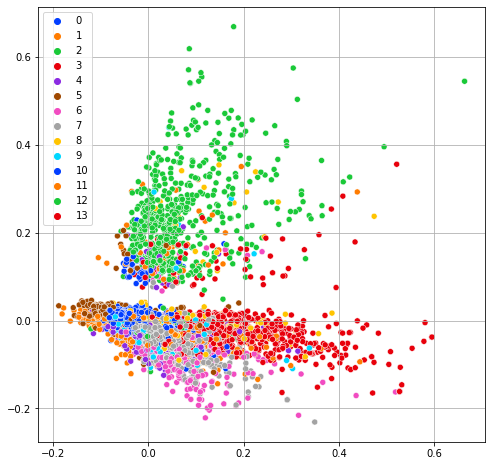

Cluster 0



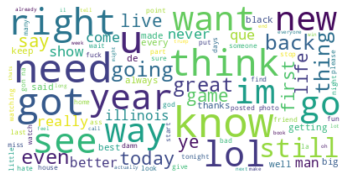

Cluster 1



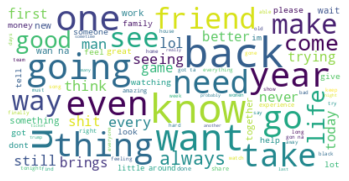

Cluster 2



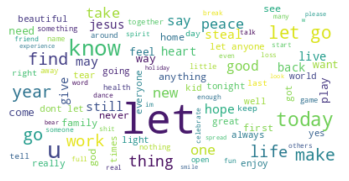

Cluster 3



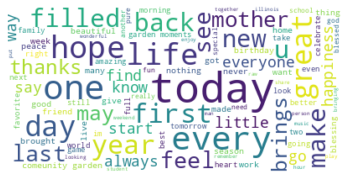

Cluster 4



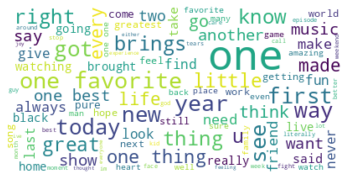

Cluster 5



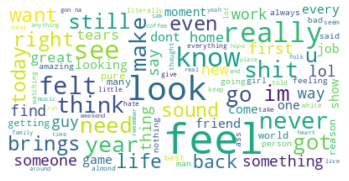

Cluster 6



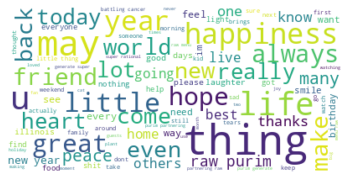

Cluster 7



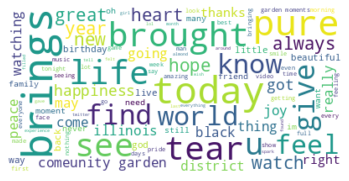

Cluster 8



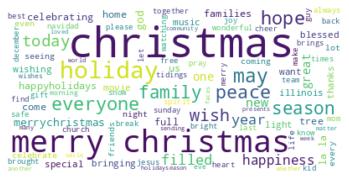

Cluster 9



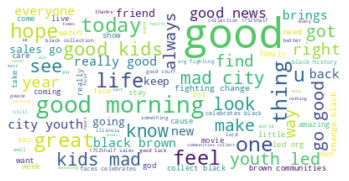

Cluster 10



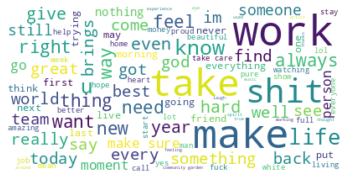

Cluster 11



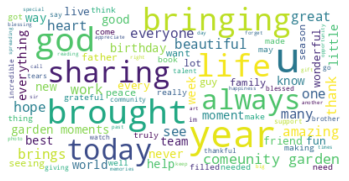

Cluster 12



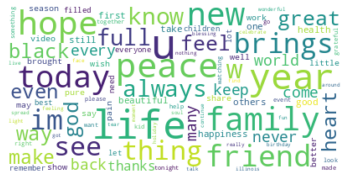

Cluster 13



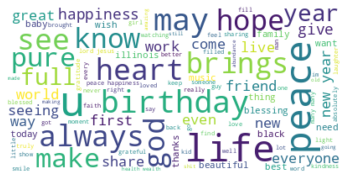

In [11]:
# clustering on tfidf vectors with sparse rows with only 2 words removed
b_model = clust(b, k=14)
word_clouds(tfidf_vectors, b_model, k=14)

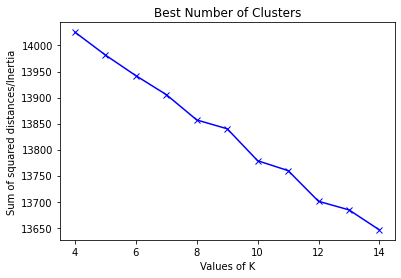

In [7]:
c = remove_sparse_rows(tfidf_vectors, 1)

tfidf_vectors.shape, c.shape

# selecting best value for k
best_k(c)

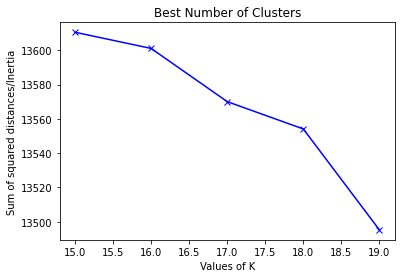

In [8]:
Sum_of_squared_distances = []
k = range(15,20)
for num_clusters in k :
    kmeans = KMeans(n_clusters=num_clusters, max_iter = 1000)
    kmeans.fit(c)
    Sum_of_squared_distances.append(kmeans.inertia_)
 
plt.plot(k,Sum_of_squared_distances,'bx-')
plt.xlabel('Values of K') 
plt.ylabel('Sum of squared distances/Inertia') 
plt.title('Best Number of Clusters')
plt.show()

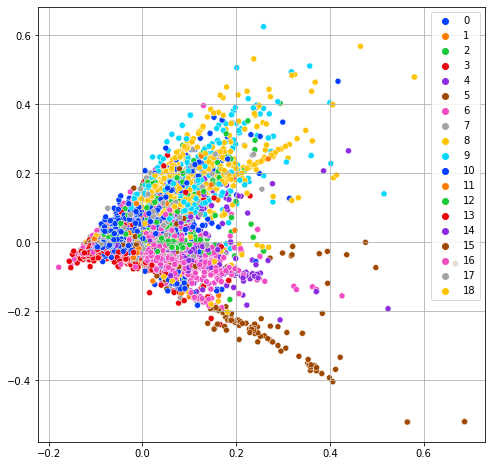

Cluster 0



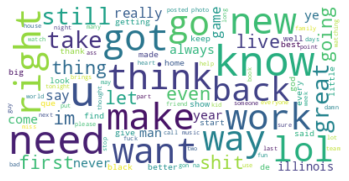

Cluster 1



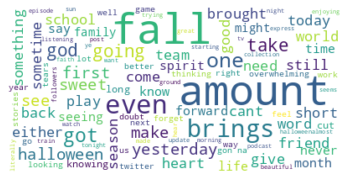

Cluster 2



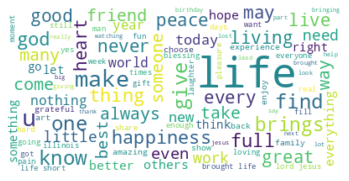

Cluster 3



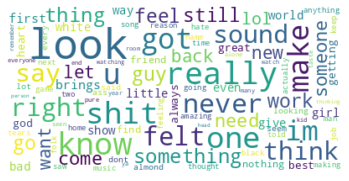

Cluster 4



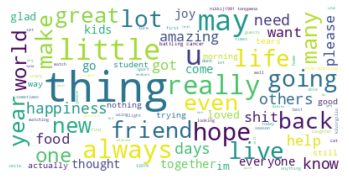

Cluster 5



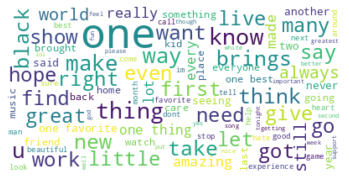

Cluster 6



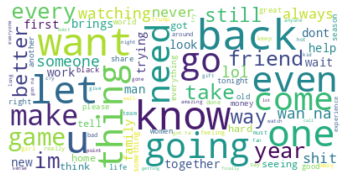

Cluster 7



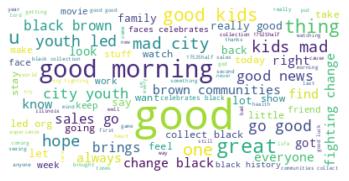

Cluster 8



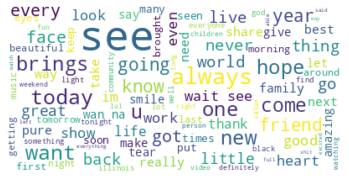

Cluster 9



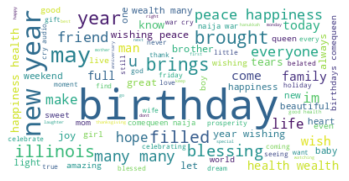

Cluster 10



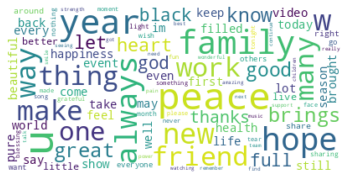

Cluster 11



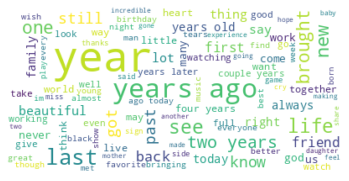

Cluster 12



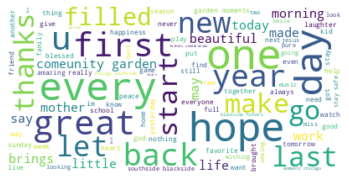

Cluster 13



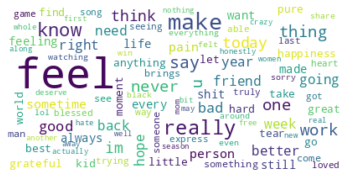

Cluster 14



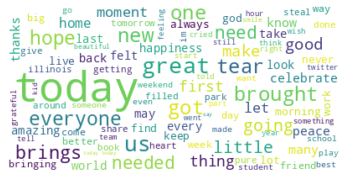

Cluster 15



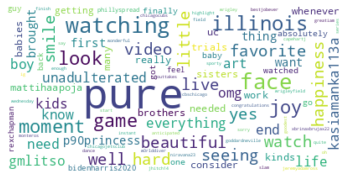

Cluster 16



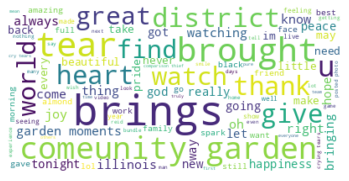

Cluster 17



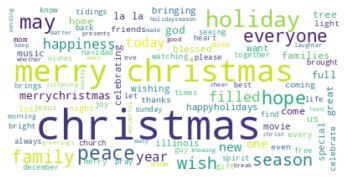

Cluster 18



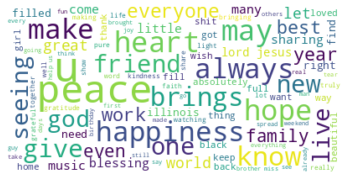

In [10]:
# clustering on tfidf vectors with sparse rows with only 3 words removed
c_model = clust(c, k=19)
word_clouds(tfidf_vectors, c_model, k=19)

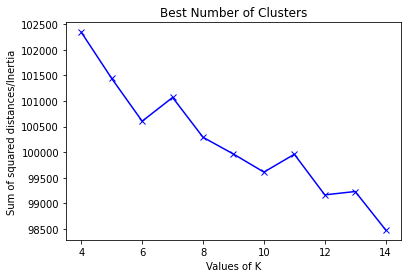

In [7]:
# COUNT VECTORS CLUSTERING COMPARISON
x = remove_sparse_rows(count_vectors, 1)

count_vectors.shape, x.shape

# selecting best value for k
best_k(x)

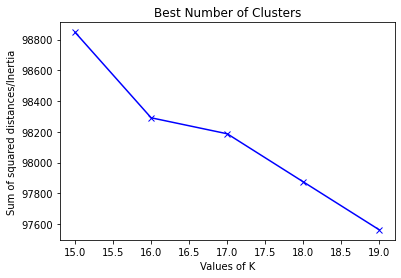

In [8]:
Sum_of_squared_distances = []
k = range(15,20)
for num_clusters in k :
    kmeans = KMeans(n_clusters=num_clusters, max_iter = 1000)
    kmeans.fit(x)
    Sum_of_squared_distances.append(kmeans.inertia_)
 
plt.plot(k,Sum_of_squared_distances,'bx-')
plt.xlabel('Values of K') 
plt.ylabel('Sum of squared distances/Inertia') 
plt.title('Best Number of Clusters')
plt.show()

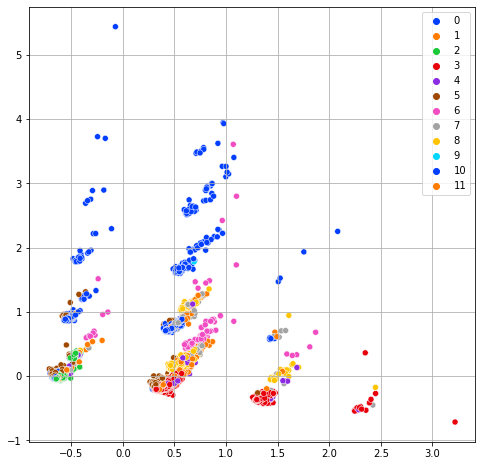

Cluster 0



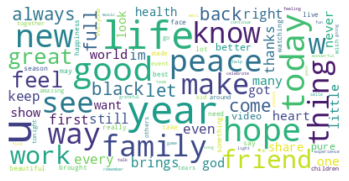

Cluster 1



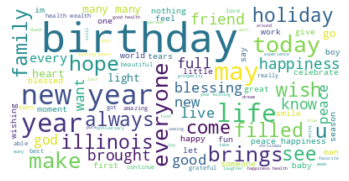

Cluster 2



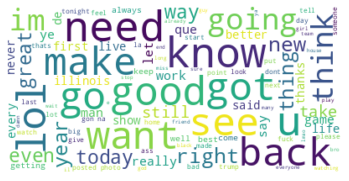

Cluster 3



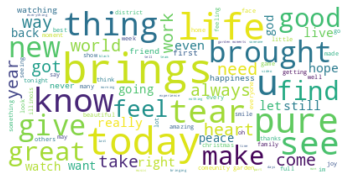

Cluster 4



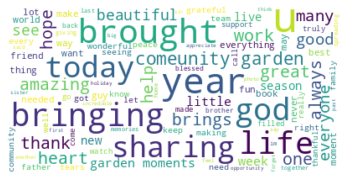

Cluster 5



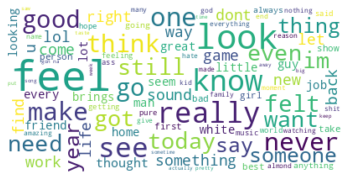

Cluster 6



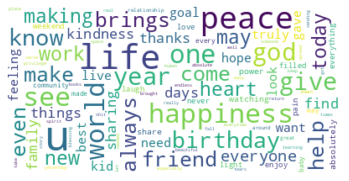

Cluster 7



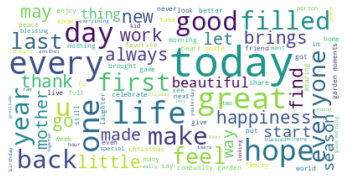

Cluster 8



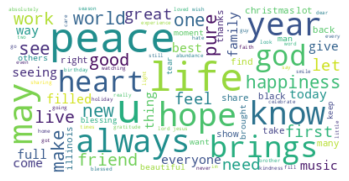

Cluster 9



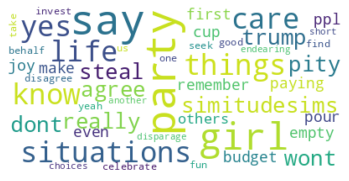

Cluster 10



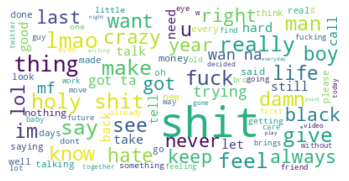

Cluster 11



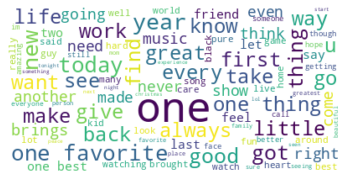

In [10]:
# clustering on count vectors with sparse rows with only 1 word removed
x_model = clust(x, k=12)
word_clouds(count_vectors, x_model, k=12)

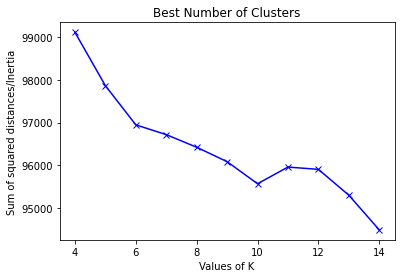

In [10]:
y = remove_sparse_rows(count_vectors, 2)

count_vectors.shape, y.shape

# selecting best value for k
best_k(y)

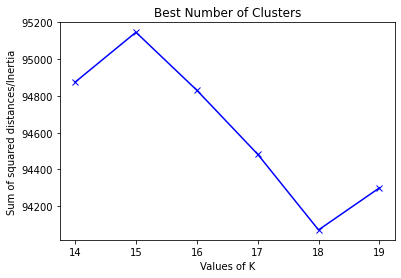

In [12]:
Sum_of_squared_distances = []
k = range(14,20)
for num_clusters in k :
    kmeans = KMeans(n_clusters=num_clusters, max_iter = 1000)
    kmeans.fit(y)
    Sum_of_squared_distances.append(kmeans.inertia_)
 
plt.plot(k,Sum_of_squared_distances,'bx-')
plt.xlabel('Values of K') 
plt.ylabel('Sum of squared distances/Inertia') 
plt.title('Best Number of Clusters')
plt.show()

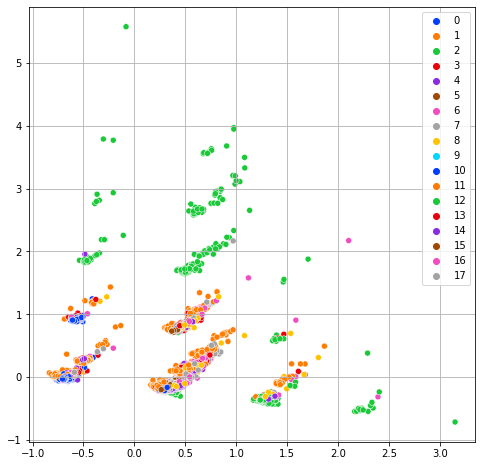

Cluster 0



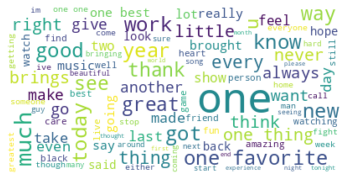

Cluster 1



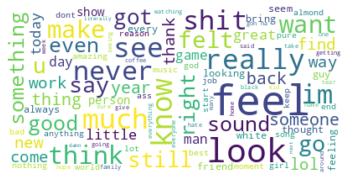

Cluster 2



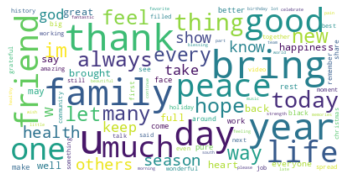

Cluster 3



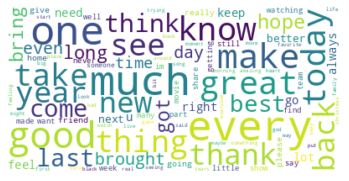

Cluster 4



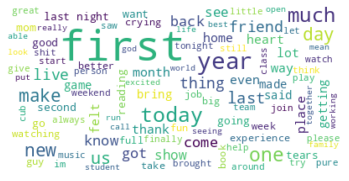

Cluster 5



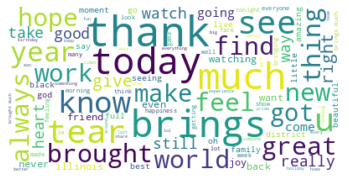

Cluster 6



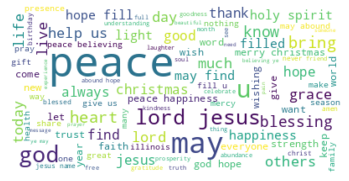

Cluster 7



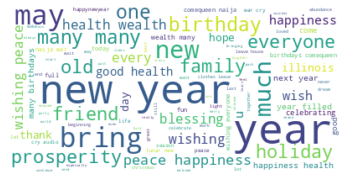

Cluster 8



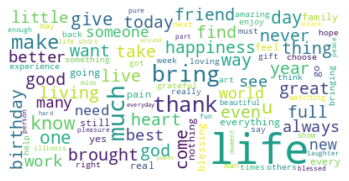

Cluster 9



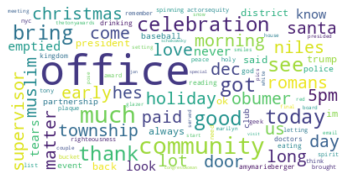

Cluster 10



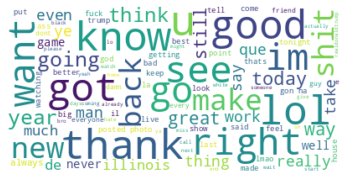

Cluster 11



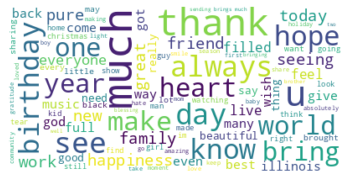

Cluster 12



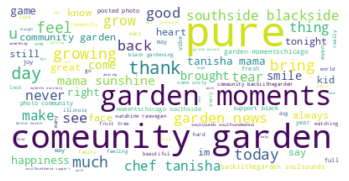

Cluster 13



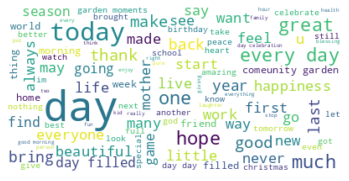

Cluster 14



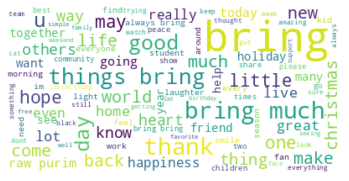

Cluster 15



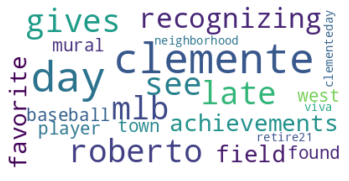

Cluster 16



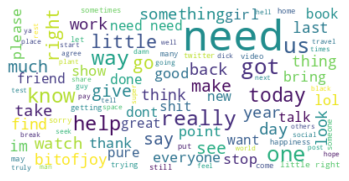

Cluster 17



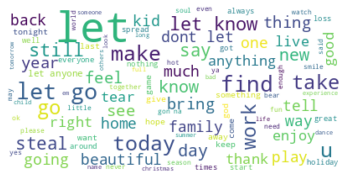

In [13]:
# clustering on count vectors with sparse rows with only 2 words removed
y_model = clust(y, k=18)
word_clouds(count_vectors, y_model, k=18)

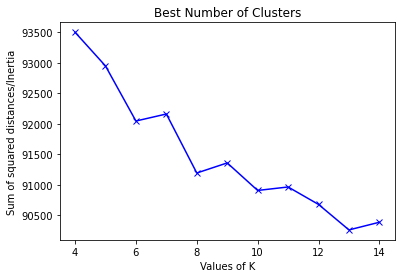

In [7]:
z = remove_sparse_rows(count_vectors, 3)

count_vectors.shape, z.shape

# selecting best value for k
best_k(z)

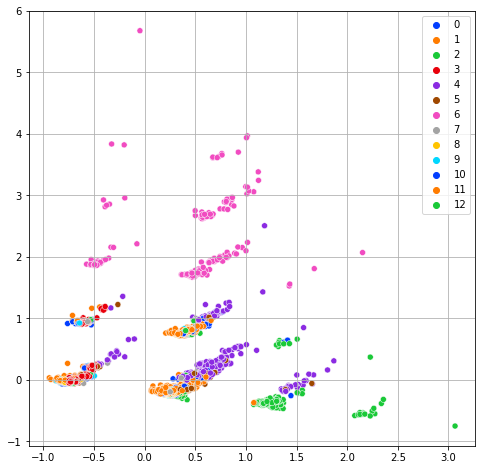

Cluster 0



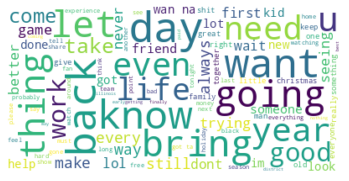

Cluster 1



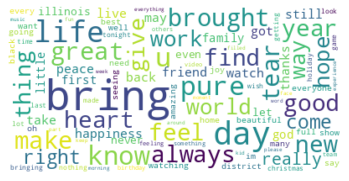

Cluster 2



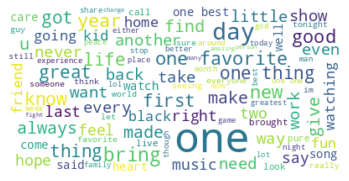

Cluster 3



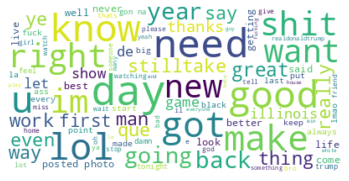

Cluster 4



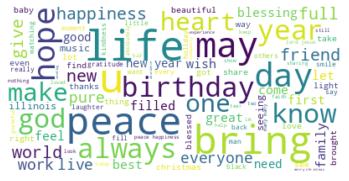

Cluster 5



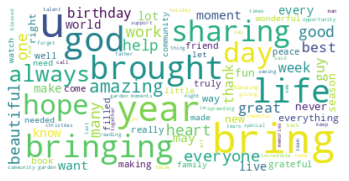

Cluster 6



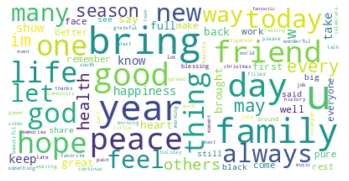

Cluster 7



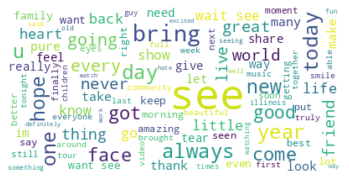

Cluster 8



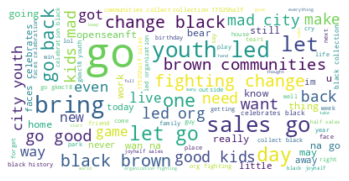

Cluster 9



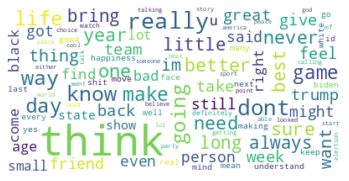

Cluster 10



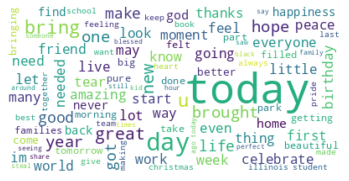

Cluster 11



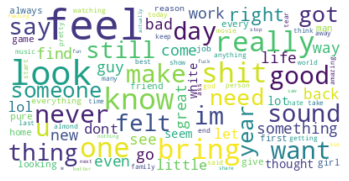

Cluster 12



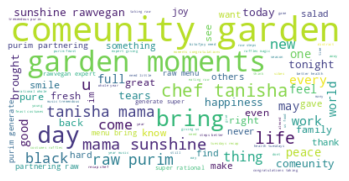

In [8]:
# clustering on count vectors with sparse rows with only 2 words removed
z_model = clust(z, k=13)
word_clouds(count_vectors, z_model, k=13)

In [18]:
def do_pca(vectors):

    # PCA
    pca = PCA(2)
    pca.fit(vectors)
    docs_pca = pca.transform(vectors)

    plt.figure(figsize = (8, 8))
    plt.grid()
    
    sns.scatterplot(x=docs_pca[:, 0], y = docs_pca[:, 1], hue=df['ijoy'])
    plt.show()
    #plt.savefig('Word Freq.png') 

In [19]:
# transfrom weights and add one to each value
ar  = np.array(ar)+1
do  = np.array(do)+1
va  = np.array(va)+1

# create weighted vectors
va_vectors= remove_zeros(tfidf_vectors*va)
ar_vectors= remove_zeros(tfidf_vectors*ar)
do_vectors= remove_zeros(tfidf_vectors*do)

ValueError: operands could not be broadcast together with shapes (18226,8353) (19971,) 

In [23]:
n_zeros = np.count_nonzero(tfidf_vectors==0, axis = 1, where=)


array([8342, 8348, 8349, ..., 8349, 8350, 8351])

In [24]:
n_zeros.shape

(18226,)

In [26]:
tfidf_vectors.shape

(18226, 8353)

In [31]:
a = tfidf_vectors[np.count_nonzero(tfidf_vectors==0, axis = 1) < 8352]
a.shape

(14377, 8353)

In [28]:
a[0]

array([0., 0., 0., ..., 0., 0., 0.])

In [21]:
count = 0
for i in range (8353):
    if tfidf_vectors[0][i] ==0:
        count +=1
print(count)
    

8342


original matrix size (18226, 8353)
compact matrix size (18226, 8353)
original matrix size (18226, 8353)
compact matrix size (18226, 8353)


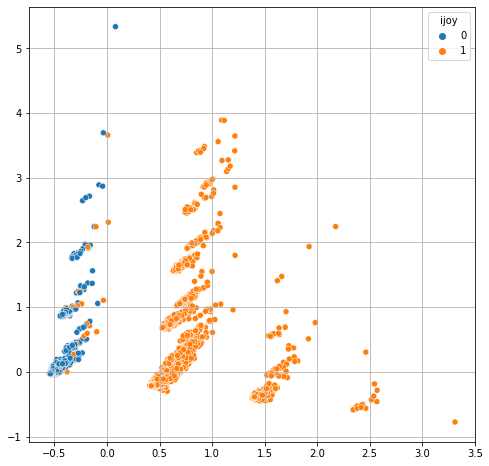

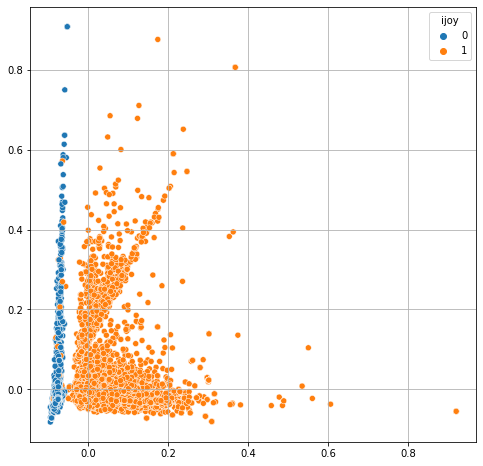

In [20]:
# remove zeros from vectors
count_vectors = remove_zeros(count_vectors)
tfidf_vectors = remove_zeros(tfidf_vectors)

# compare tfidf and count vectorizers
do_pca(count_vectors)
do_pca(tfidf_vectors)

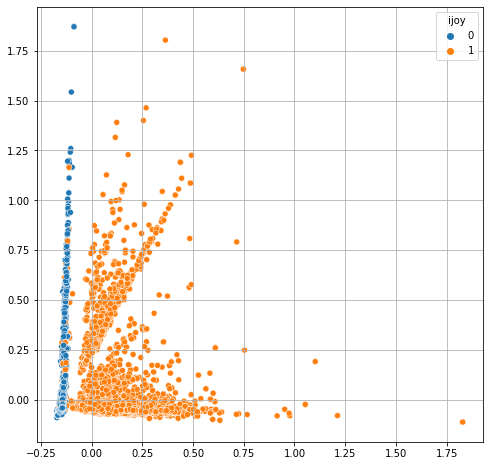

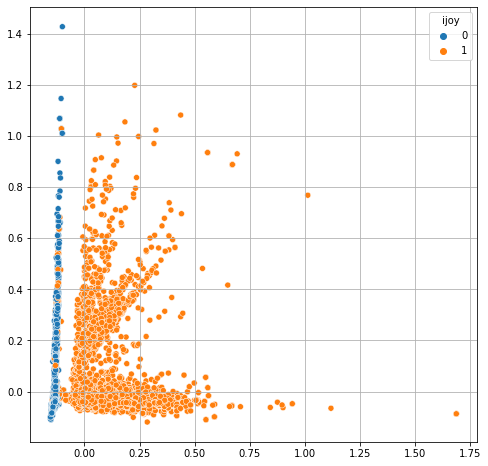

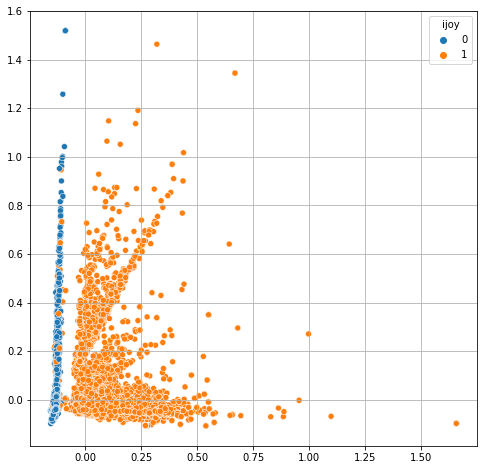

In [7]:
# PCA weighted for valence, arousal, and dominance
do_pca(va_vectors)
do_pca(ar_vectors)
do_pca(do_vectors)

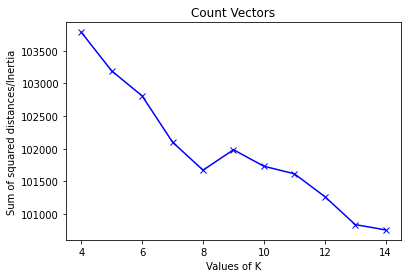

In [61]:
# selecting best value for k with count vectors
Sum_of_squared_distances = []
k = range(4,15)
for num_clusters in k :
    kmeans = KMeans(n_clusters=num_clusters, max_iter = 1000)
    kmeans.fit(count_vectors)
    Sum_of_squared_distances.append(kmeans.inertia_)
 
plt.plot(k,Sum_of_squared_distances,'bx-')
plt.xlabel('Values of K') 
plt.ylabel('Sum of squared distances/Inertia') 
plt.title('Count Vectors')
plt.show()

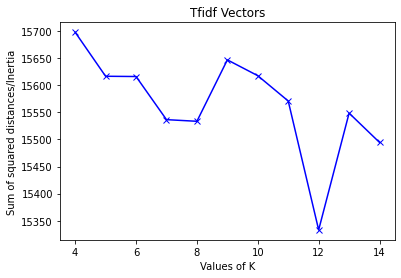

In [62]:
# selecting best value for k with tfidf vectors
Sum_of_squared_distances = []
k = range(4,15)
for num_clusters in k :
    kmeans = KMeans(n_clusters=num_clusters, max_iter = 1000)
    kmeans.fit(tfidf_vectors)
    Sum_of_squared_distances.append(kmeans.inertia_)
 
plt.plot(k,Sum_of_squared_distances,'bx-')
plt.xlabel('Values of K') 
plt.ylabel('Sum of squared distances/Inertia') 
plt.title('Tfidf Vectors')
plt.show()

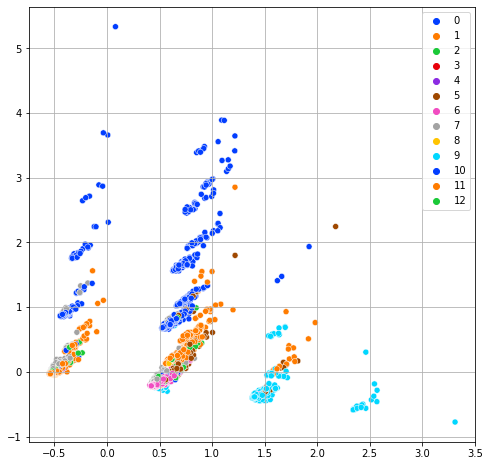

In [25]:
# K means clustering on count vectors
model = KMeans(n_clusters=13, init='k-means++', max_iter=1000, n_init=10)
kmeans_vectors = model.fit_predict(count_vectors)


#let's plot the PCA 
pca = PCA(2)
pca.fit(count_vectors)
docs_pca = pca.transform(count_vectors)

plt.figure(figsize = (8, 8))
plt.grid()
sns.scatterplot(x=docs_pca[:, 0], y=docs_pca[:, 1], hue=kmeans_vectors, palette=sns.color_palette("bright", 13))
plt.show()

[nltk_data] Downloading package stopwords to
[nltk_data]     /home/rgordon/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


Cluster 0



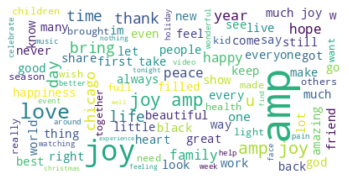

Cluster 1



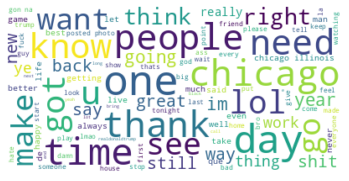

Cluster 2



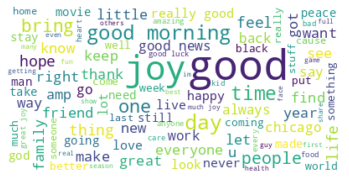

Cluster 3



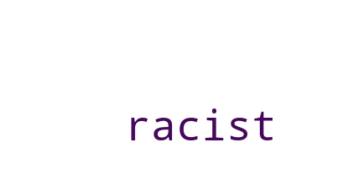

Cluster 4



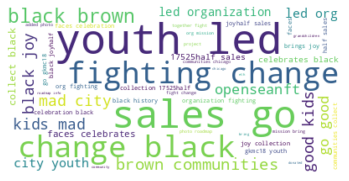

Cluster 5



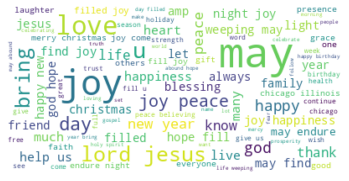

Cluster 6



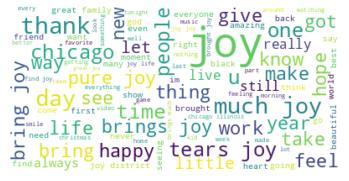

Cluster 7



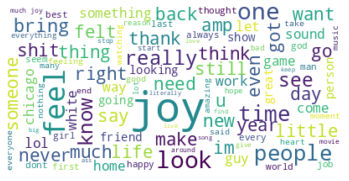

Cluster 8



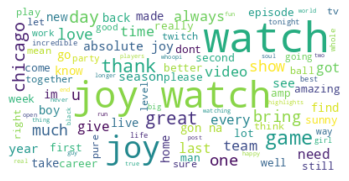

Cluster 9



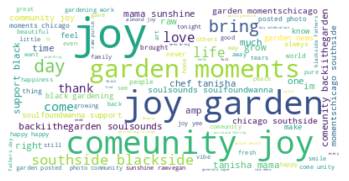

Cluster 10



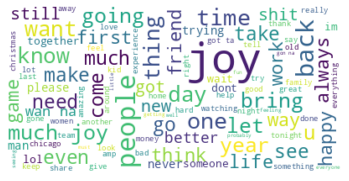

Cluster 11



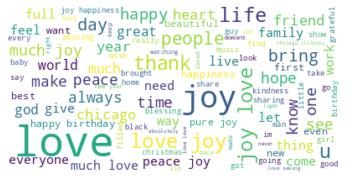

Cluster 12



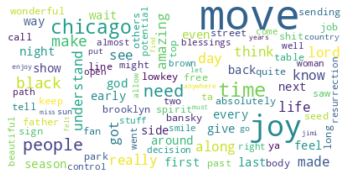

In [26]:
# create word clouds for count vectors clustering

result={'cluster':kmeans_vectors,'data':df['clean_tweet']}


result=pd.DataFrame(result)

nltk.download('stopwords')

stopWords = stopwords.words('english')
stopWords.extend(['today', 'subject', 'ftp', 'newsgroup'])

for k in range(0,13):
   print("Cluster {}\n".format(k))
   s=result[result.cluster==k]
   text=s['data'].str.cat(sep=' ')
   text=' '.join([word for word in text.split() if word.lower() not in stopWords])
   wordcloud = WordCloud(max_font_size=50, max_words=100, background_color="white").generate(text)
  
   plt.figure()
   plt.imshow(wordcloud, interpolation="bilinear")
   plt.axis("off")
   plt.savefig('WordCloud-Cluster{}.png'.format(k))
   plt.show()

In [27]:
result[result.cluster==3]

,cluster,data
8352,3,racist racist racist racist racist racist racist


In [8]:
# Topic Modeling Function

def plot_top_words(model, feature_names, n_top_words, title):
    fig, axes = plt.subplots(2, 2, figsize = (25, 15), sharex = True)
    axes = axes.flatten()
    for topic_idx, topic in enumerate(model.components_):
        top_features_ind = topic.argsort()[: -n_top_words - 1: -1]
        top_features = [feature_names[i] for i in top_features_ind]
        weights = topic[top_features_ind]
        ax = axes[topic_idx]
        ax.barh(top_features, weights, height=0.7)
        ax.set_title(f"Topic {topic_idx + 1}", fontdict={"fontsize": 20})
        ax.invert_yaxis()
        ax.tick_params(axis="both", which="major", labelsize=15)
        for i in "top right left".split():
            ax.spines[i].set_visible(False)
        fig.suptitle(title, fontsize=40)

    plt.subplots_adjust(top=0.90, bottom=0.05, wspace=0.90, hspace=0.3)
    plt.show()
    #plt.savefig('JoyTopics.png')

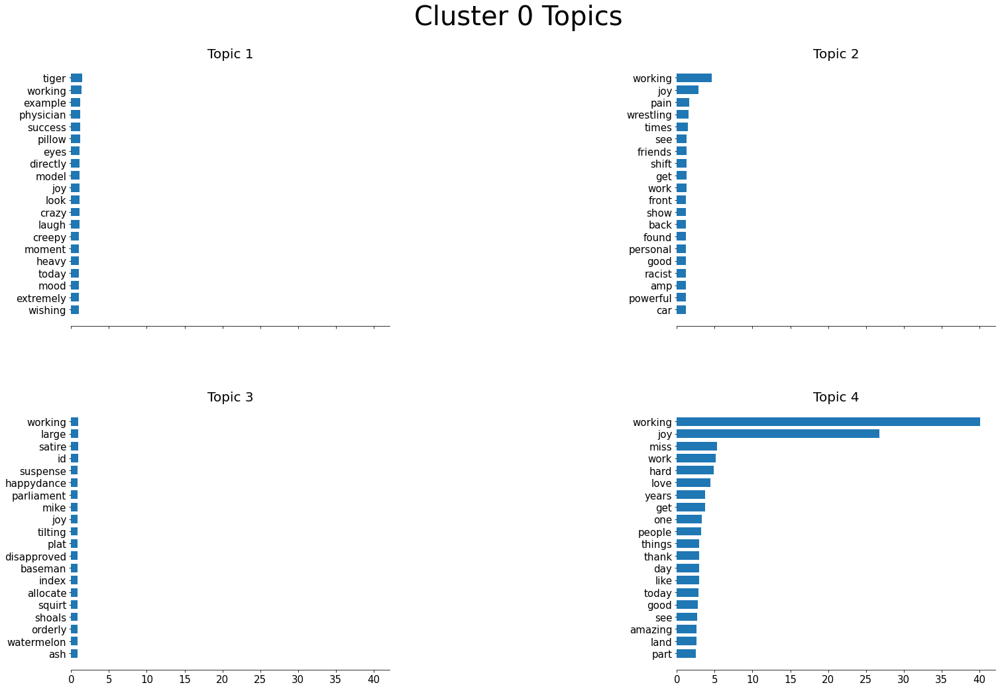

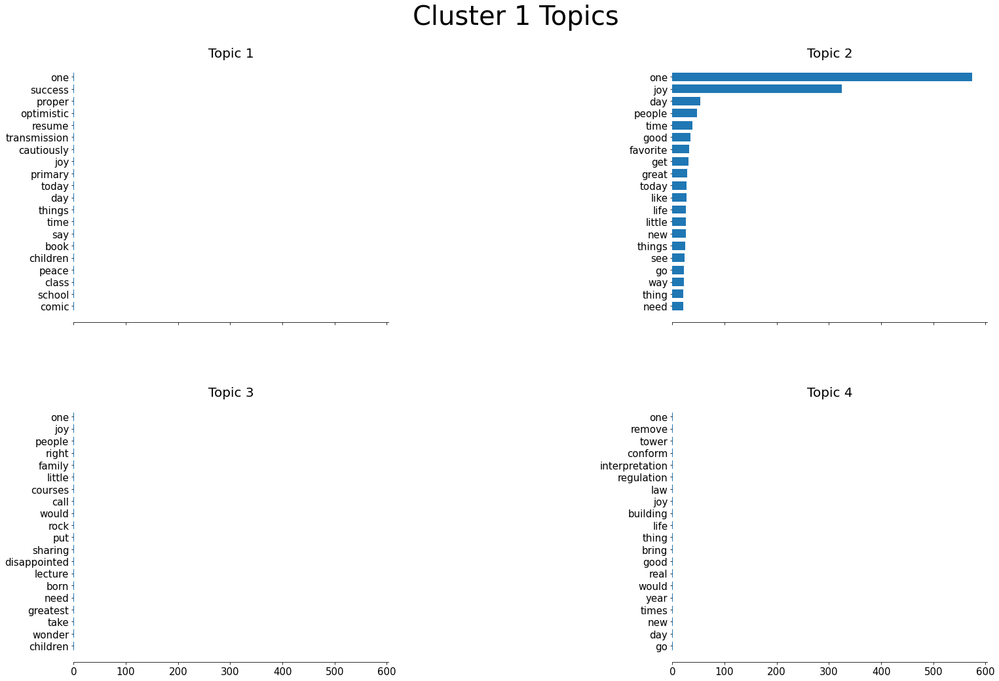

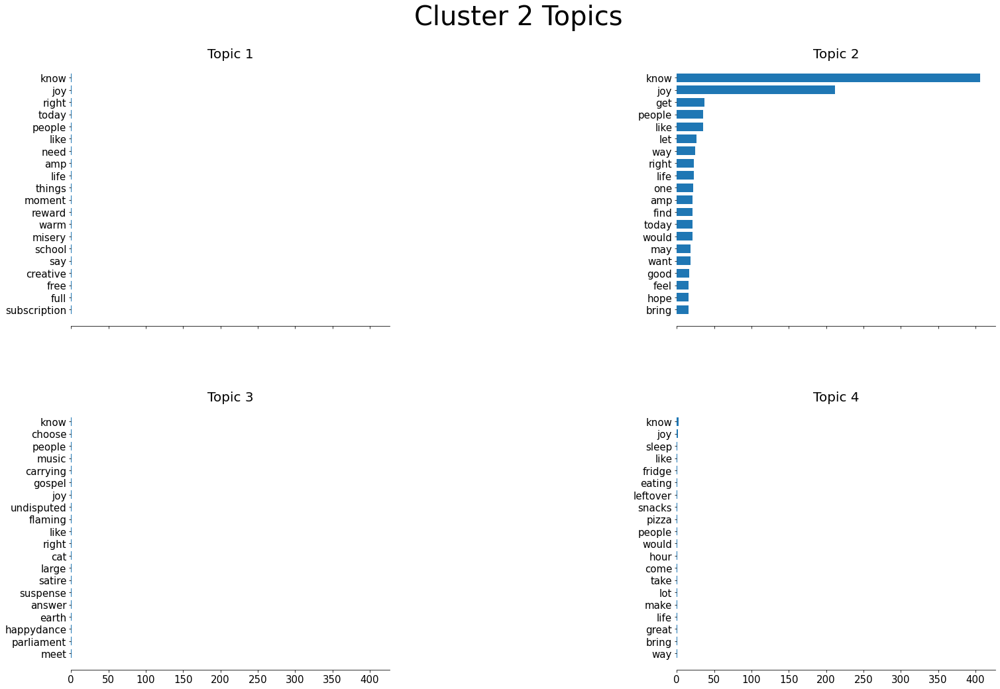

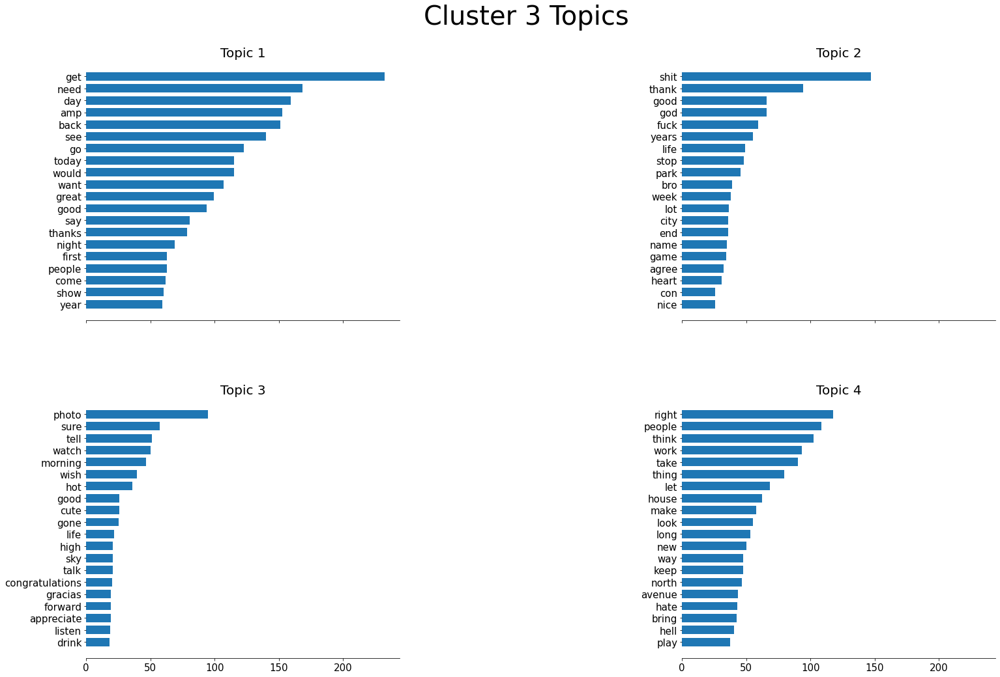

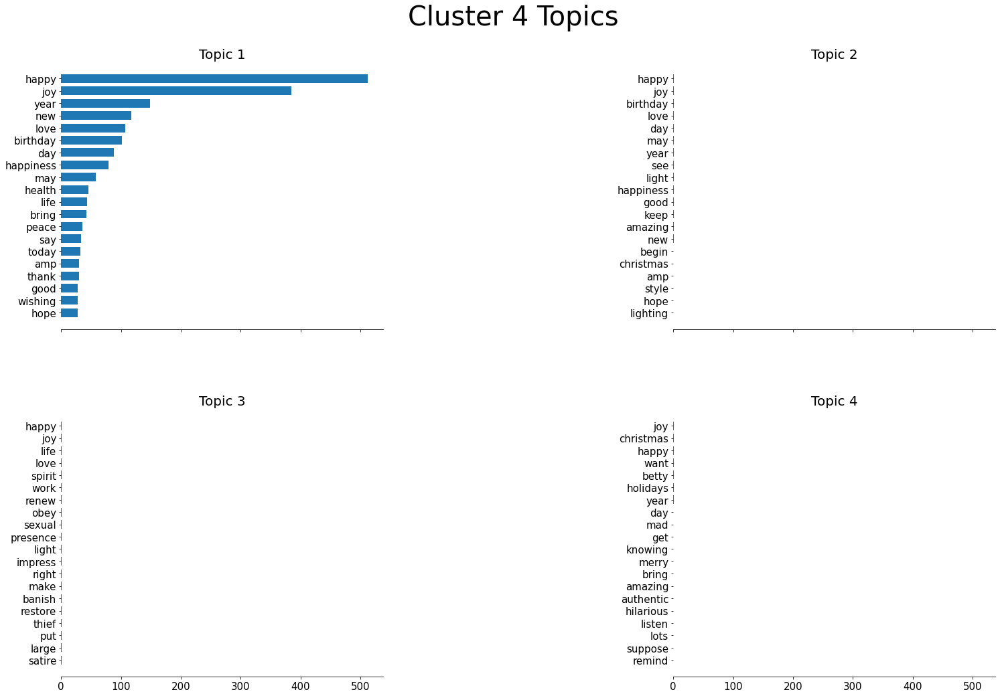

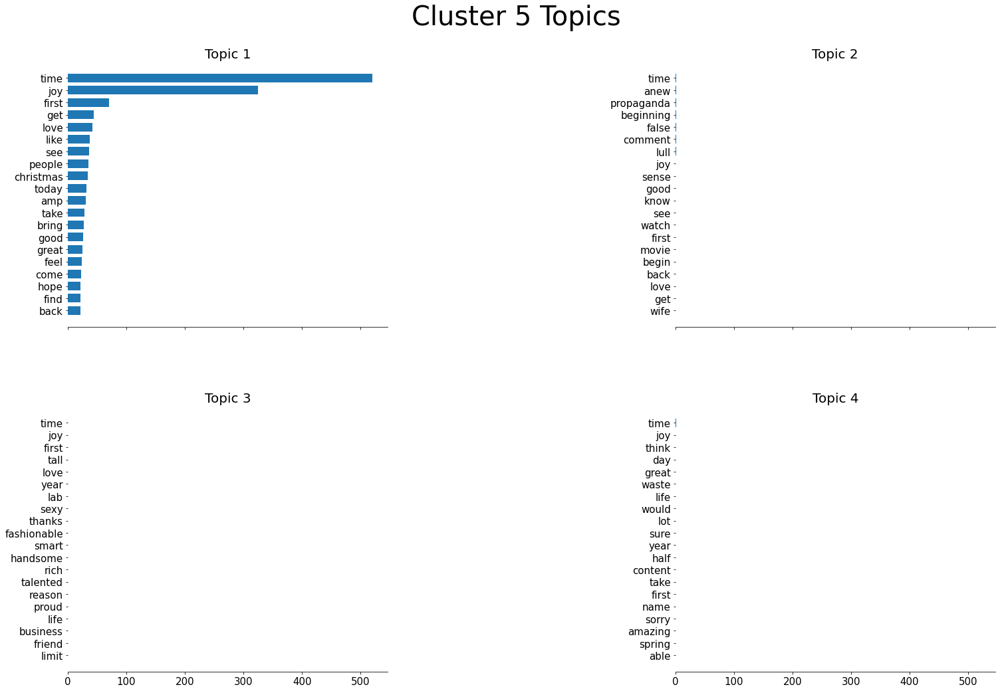

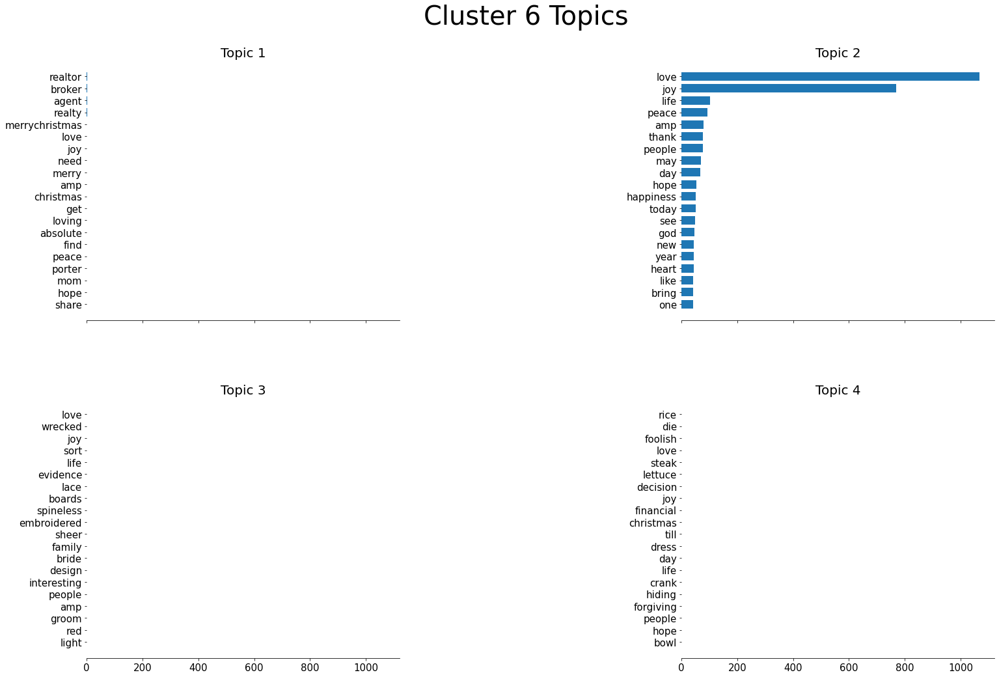

/opt/anaconda/miniconda3/envs/joy/lib/python3.8/site-packages/sklearn/decomposition/_lda.py:861: RuntimeWarning: overflow encountered in exp
  return np.exp(-1.0 * perword_bound)


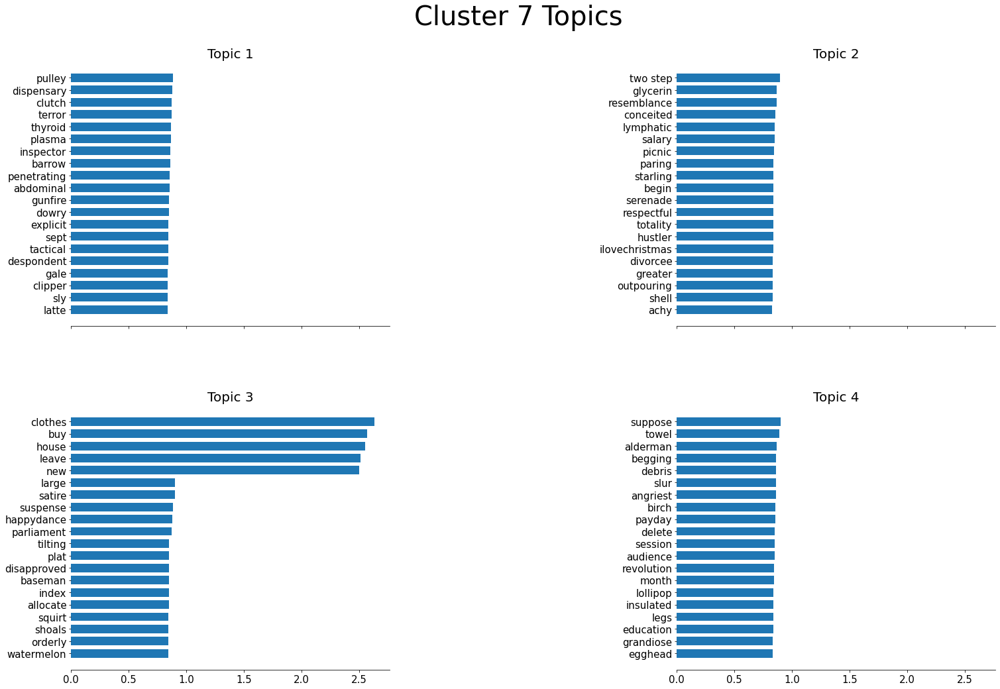

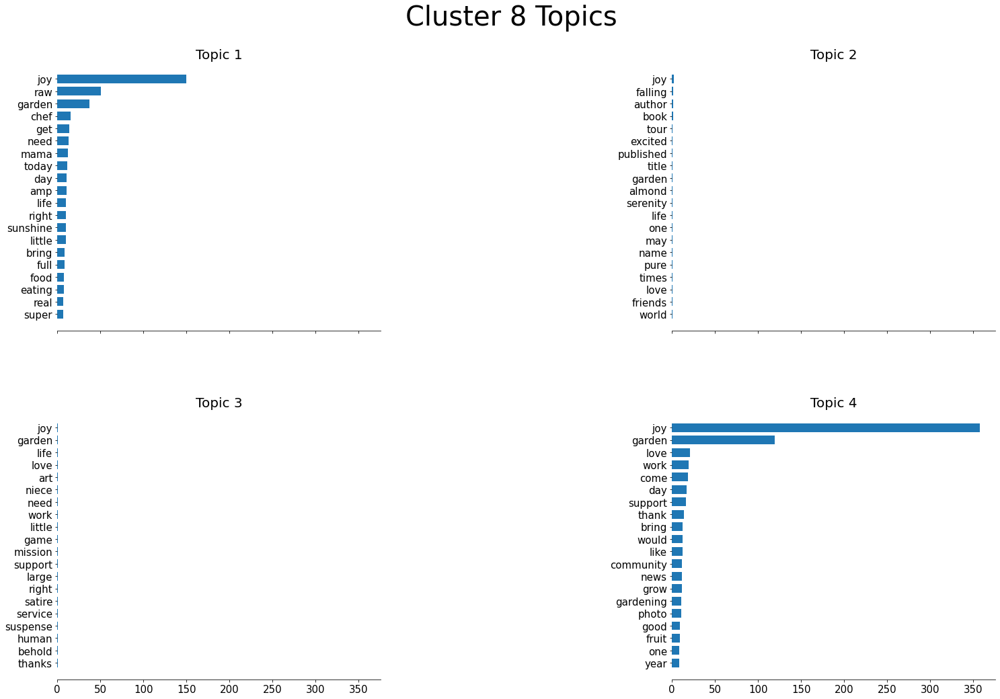

/opt/anaconda/miniconda3/envs/joy/lib/python3.8/site-packages/sklearn/decomposition/_lda.py:861: RuntimeWarning: overflow encountered in exp
  return np.exp(-1.0 * perword_bound)


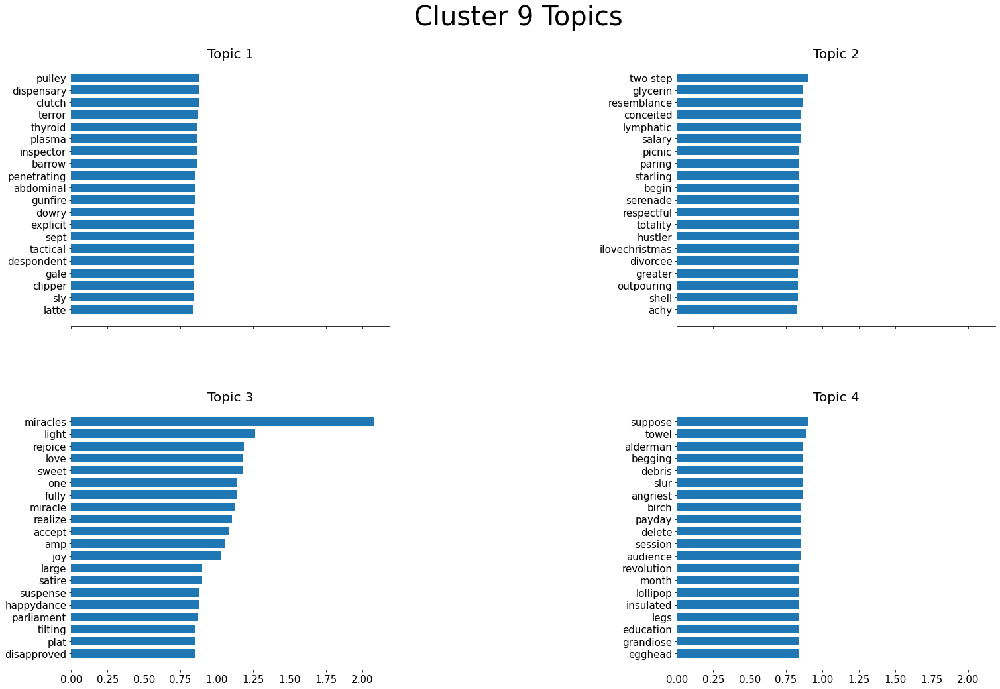

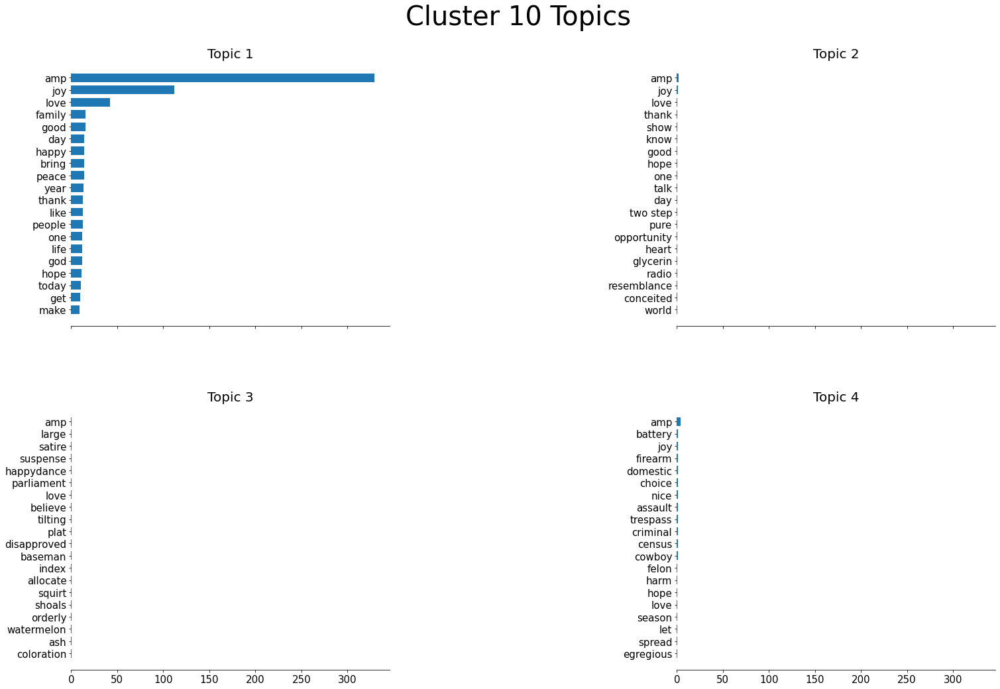

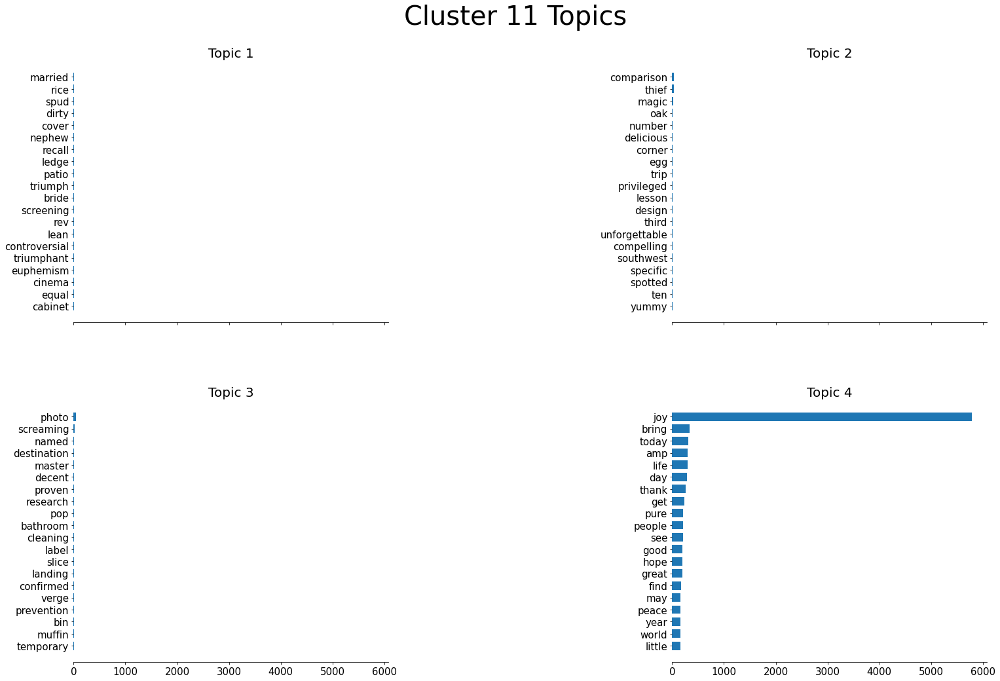

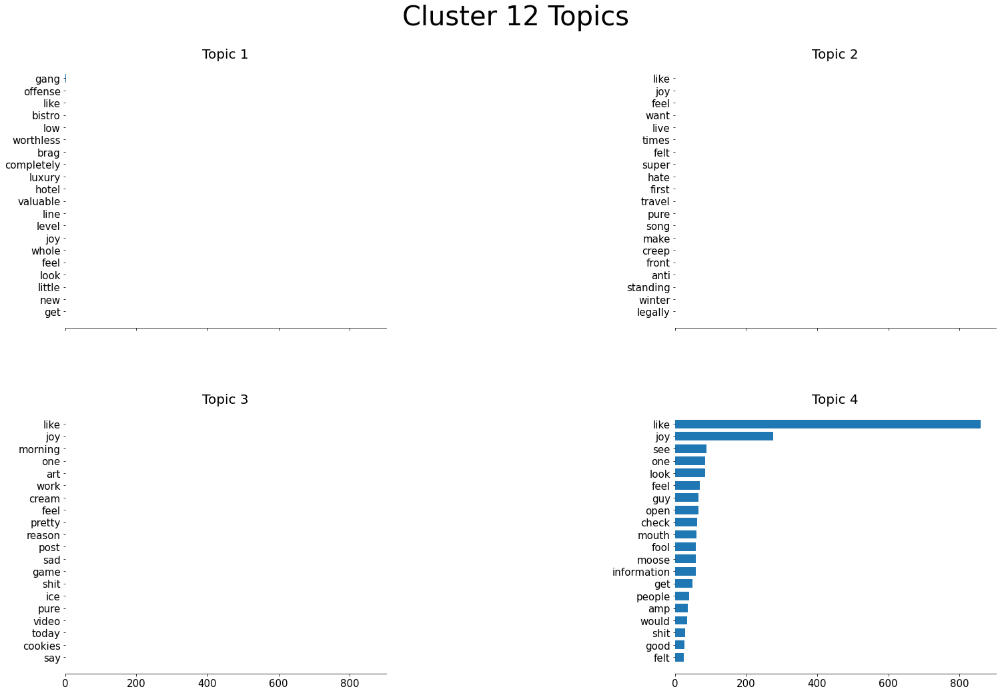

In [9]:
# Topic Modeling for count vectors

result={'cluster':kmeans_vectors,'data':df['clean_tweet']}

result=pd.DataFrame(result)


for k in range(0,13):

    # extract a given cluster
    s=result[result.cluster==k]

    # perform topic modeling on a cluster
    vectorizer = CountVectorizer(vocabulary = terms, ngram_range=(1,2))
    vectors = vectorizer.fit_transform(s['data'].values.astype('U'))

    lda_model = LatentDirichletAllocation(
        n_components = 3,
        max_iter = 1000,
        learning_method = 'online',
        learning_offset = 50,
        random_state = 32
    )
    
    lda_vectors = lda_model.fit(vectors)
    
    n_top_words = 20
    feature_names = vectorizer.get_feature_names_out()
    
    title = "Cluster {} Topics".format(k)
    plot_top_words(lda_model, feature_names, n_top_words, title)
    

   

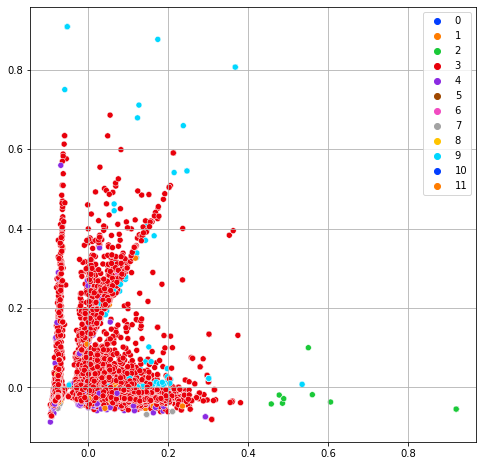

In [10]:
# K means clustering on tfidf vectors
model = KMeans(n_clusters=12, init='k-means++', max_iter=1000, n_init=10)
kmeans_vectors = model.fit_predict(tfidf_vectors)


#let's plot the PCA 
pca = PCA(2)
pca.fit(tfidf_vectors)
docs_pca = pca.transform(tfidf_vectors)


plt.figure(figsize = (8, 8))
plt.grid()
sns.scatterplot(x=docs_pca[:, 0], y=docs_pca[:, 1], hue=kmeans_vectors, palette=sns.color_palette("bright", 12))
plt.show()


Cluster 0



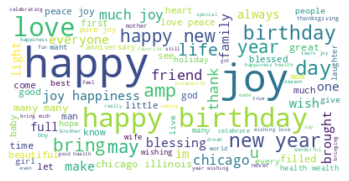

Cluster 1



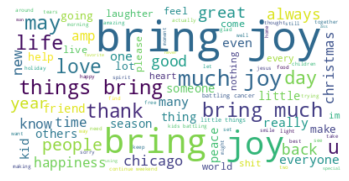

Cluster 2



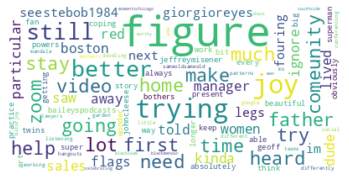

Cluster 3



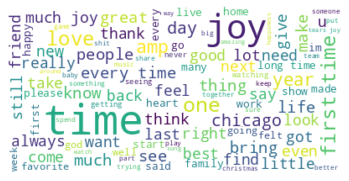

Cluster 4



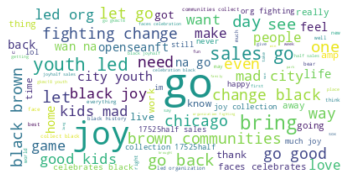

Cluster 5



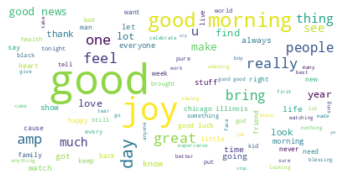

Cluster 6



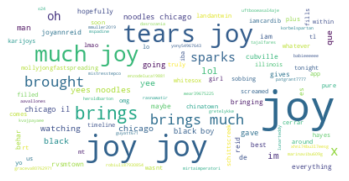

Cluster 7



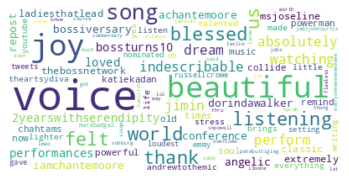

Cluster 8



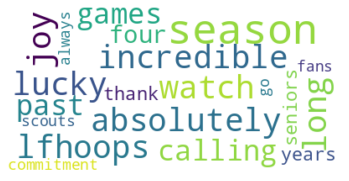

Cluster 9



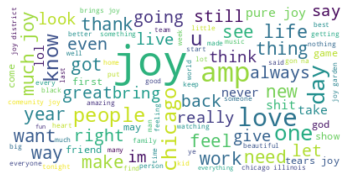

Cluster 10



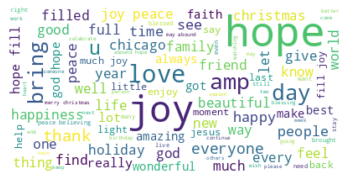

Cluster 11



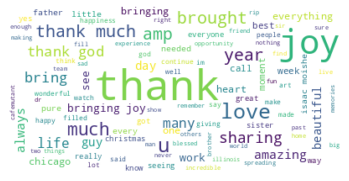

In [13]:
# create word clouds for tfidf vectors clustering

result={'cluster':kmeans_vectors,'data':df['clean_tweet']}


result=pd.DataFrame(result)

for k in range(0,12):
   print("Cluster {}\n".format(k))
   s=result[result.cluster==k]
   text=s['data'].str.cat(sep=' ')
   text=' '.join([word for word in text.split() if word.lower() not in stopWords])
   wordcloud = WordCloud(max_font_size=50, max_words=100, background_color="white").generate(text)
  
   plt.figure()
   plt.imshow(wordcloud, interpolation="bilinear")
   plt.axis("off")
   plt.show()

   cluster                                               data
0        9  scenes weekend progress lincolnpark new build ...
1        9  joy guides always come attached need ask guide...
2        9  asked anything name ask receive joy completejo...
3        1           things bring joy finding new anime binge
4        9  miss luca much really constant source joy ’ be...
       cluster                                               data
0            9  scenes weekend progress lincolnpark new build ...
1            9  joy guides always come attached need ask guide...
2            9  asked anything name ask receive joy completejo...
4            9  miss luca much really constant source joy ’ be...
5            9  sports amazing another tough night humanity ir...
...        ...                                                ...
18221        9  pengepandatante coastlieberian nontoxickids si...
18222        9                                          happening
18223        9                 chi

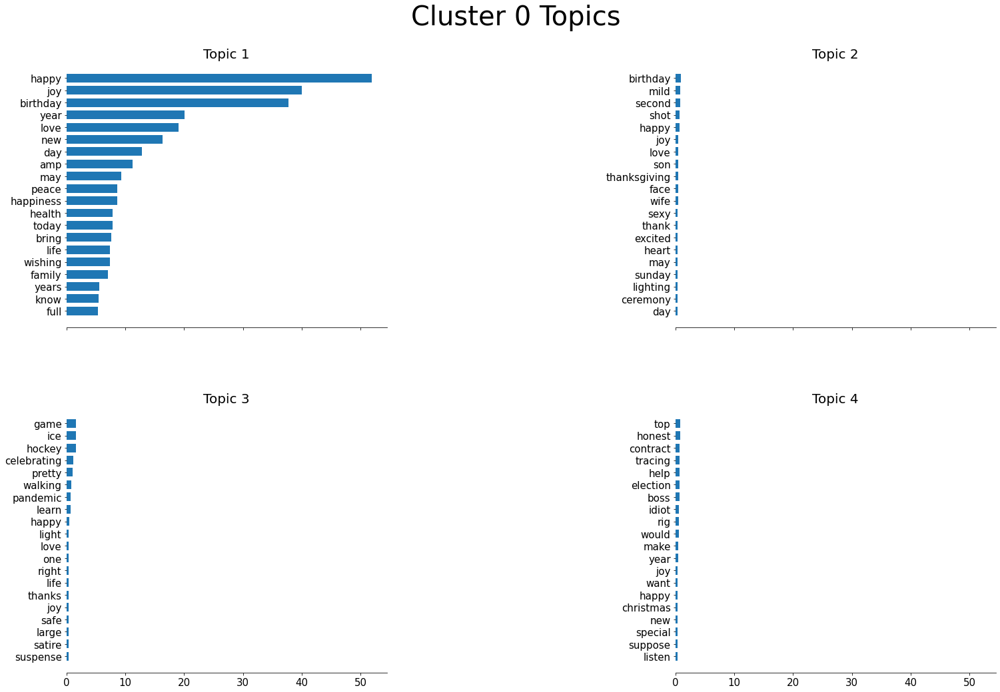

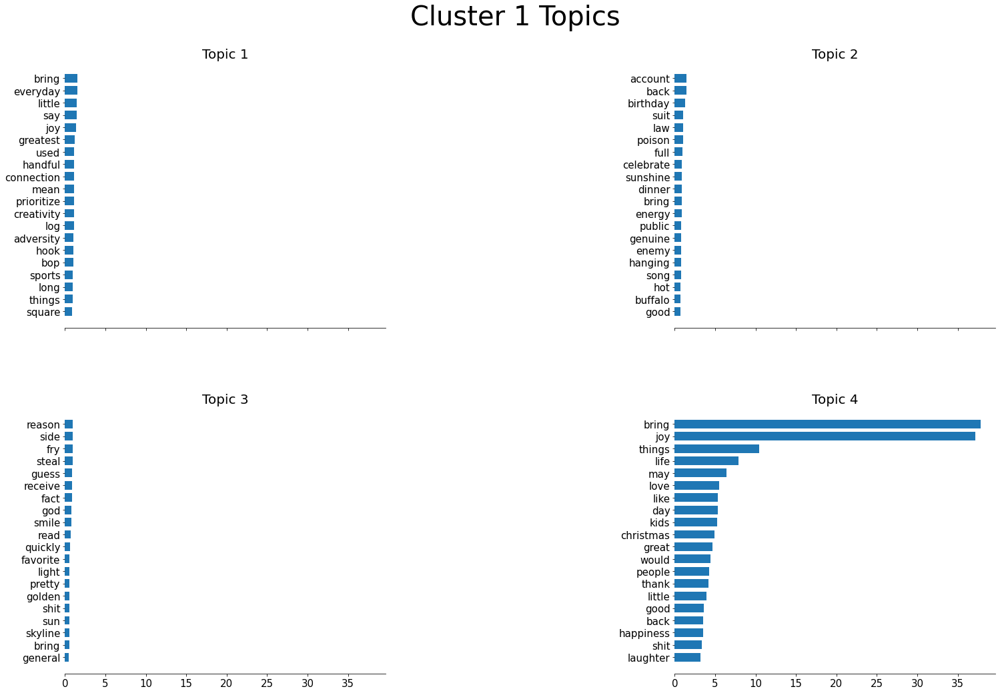

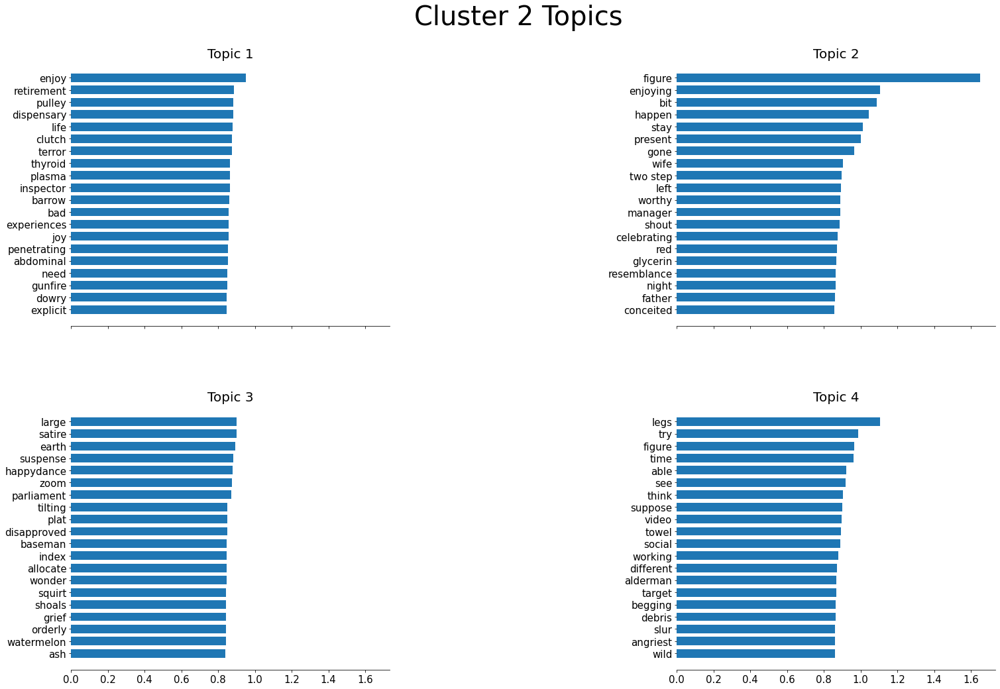

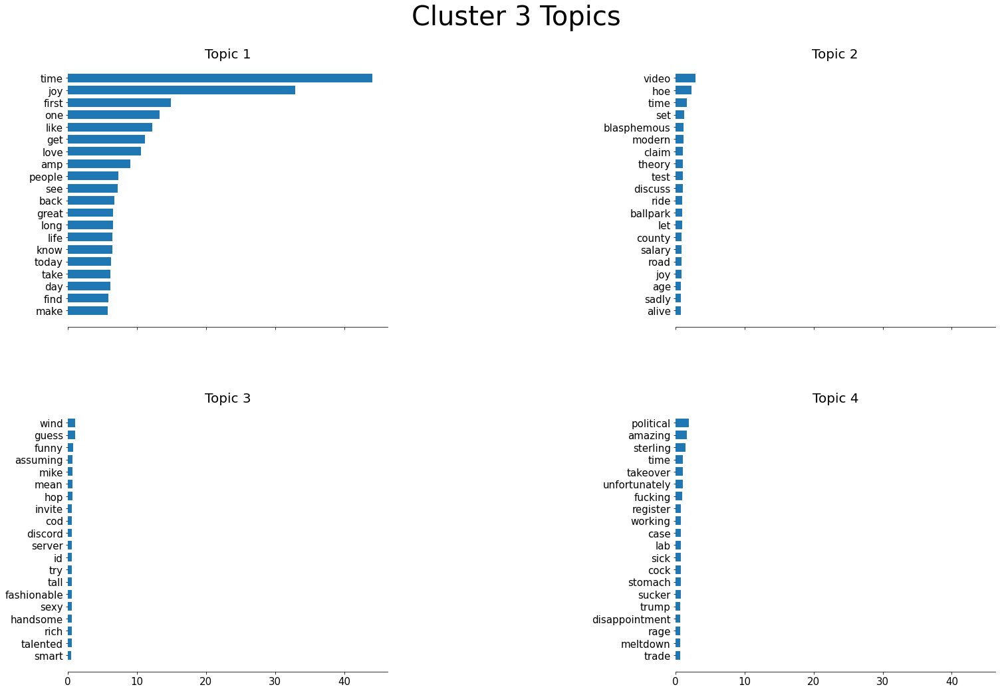

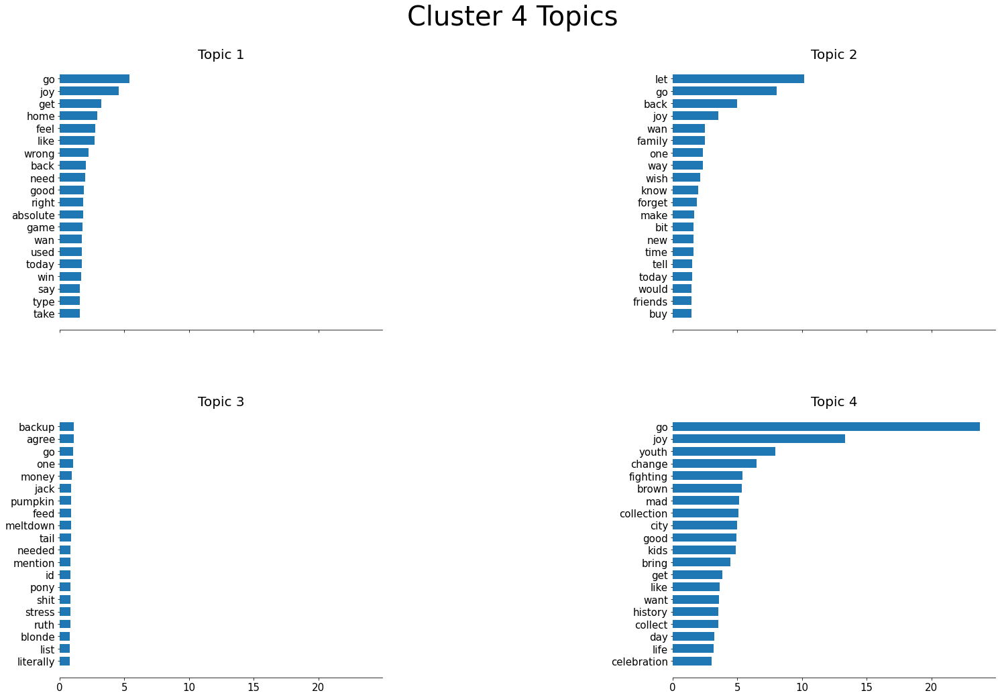

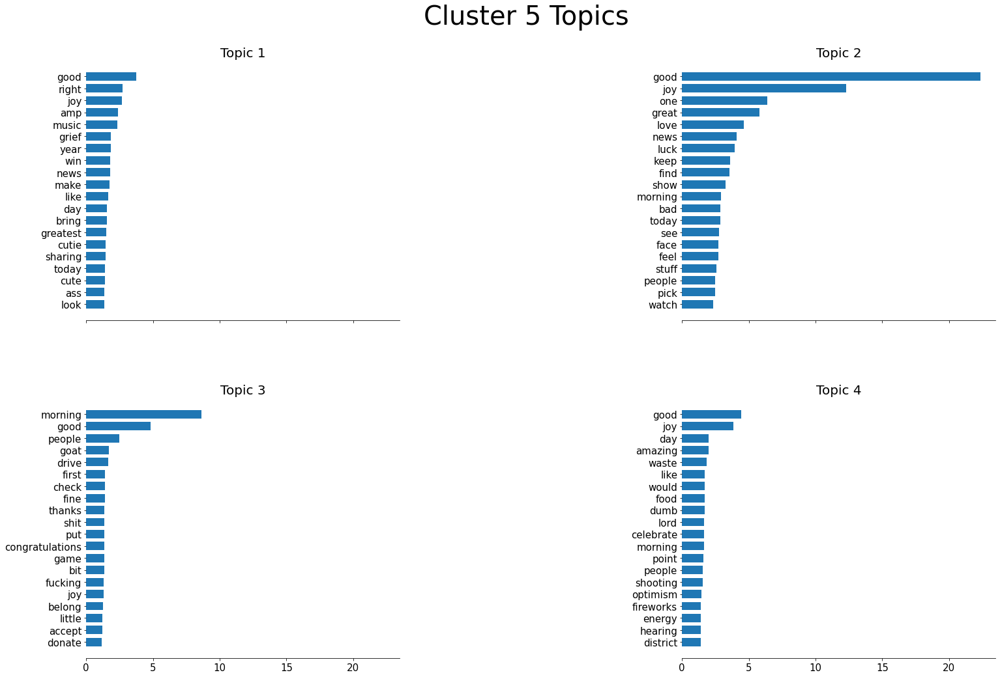

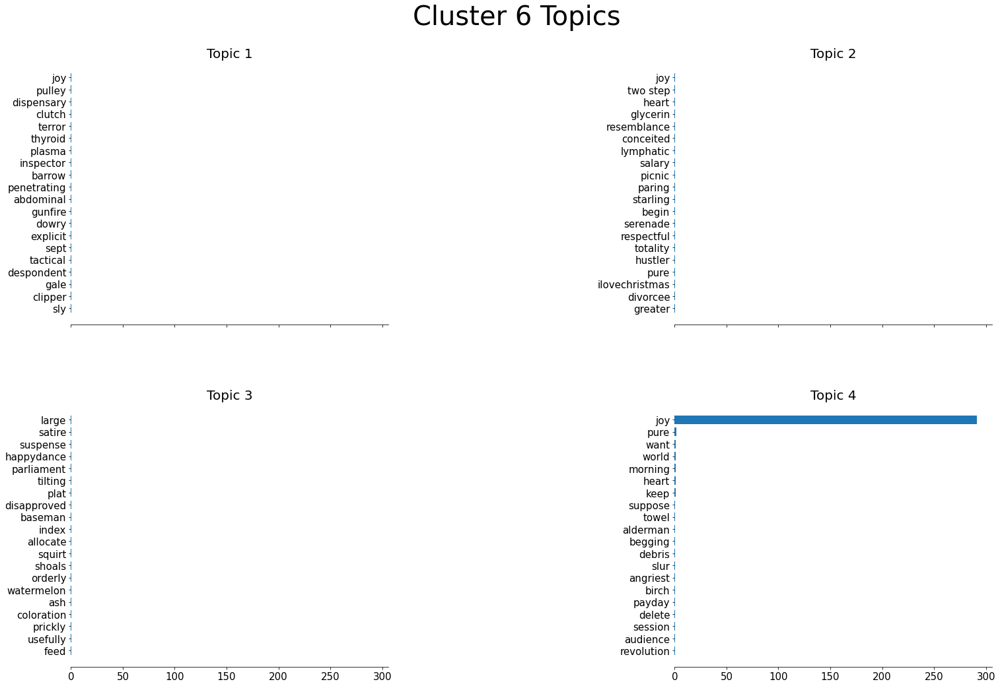

/opt/anaconda/miniconda3/envs/joy/lib/python3.8/site-packages/sklearn/decomposition/_lda.py:861: RuntimeWarning: overflow encountered in exp
  return np.exp(-1.0 * perword_bound)


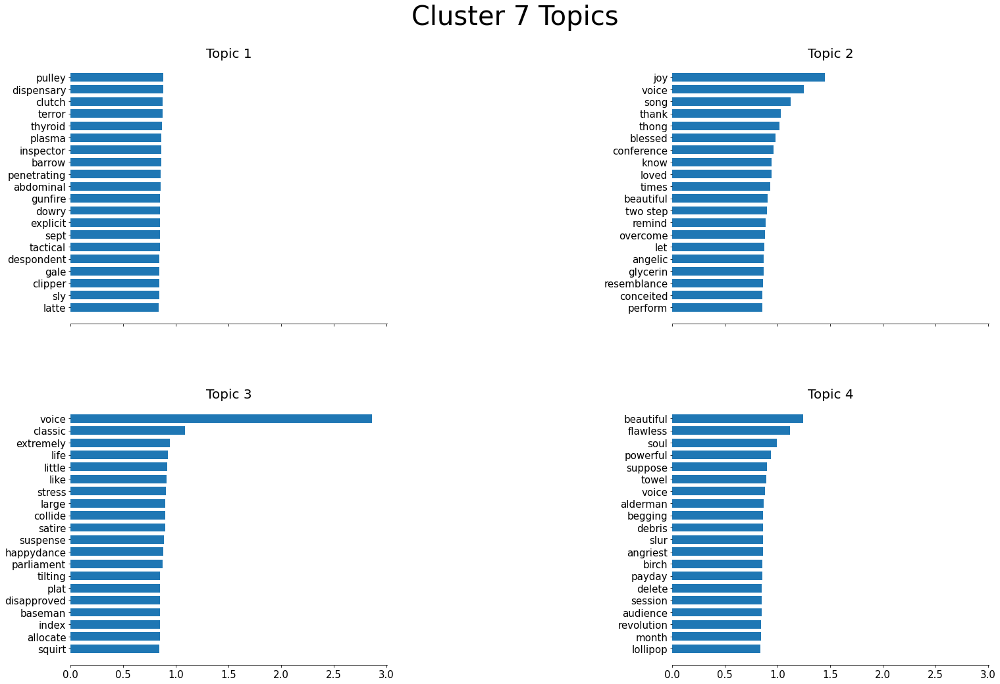

/opt/anaconda/miniconda3/envs/joy/lib/python3.8/site-packages/sklearn/decomposition/_lda.py:861: RuntimeWarning: overflow encountered in exp
  return np.exp(-1.0 * perword_bound)


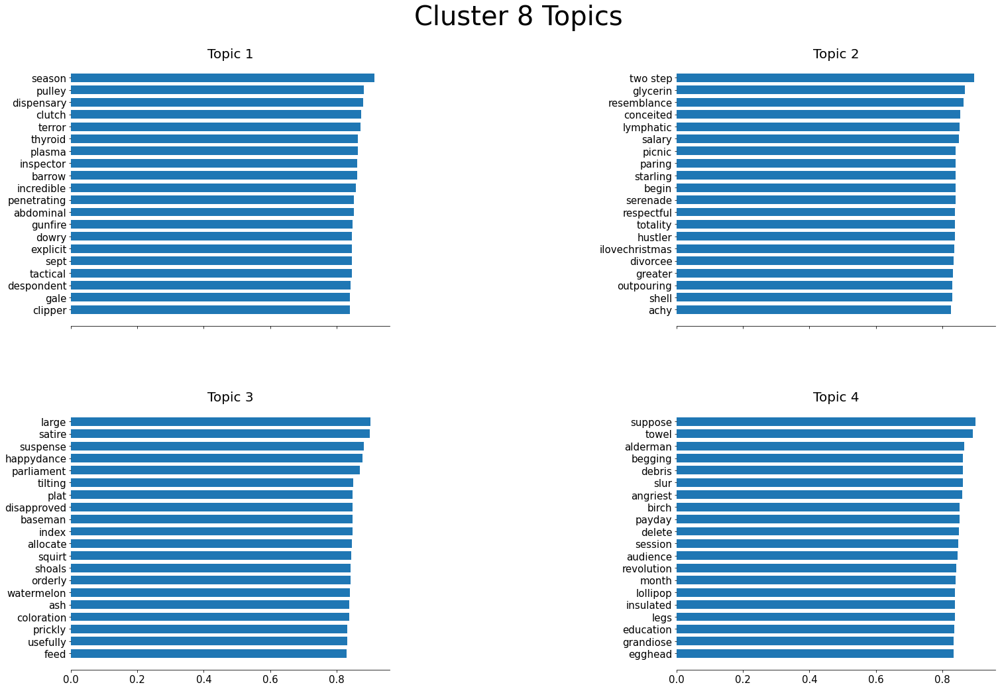

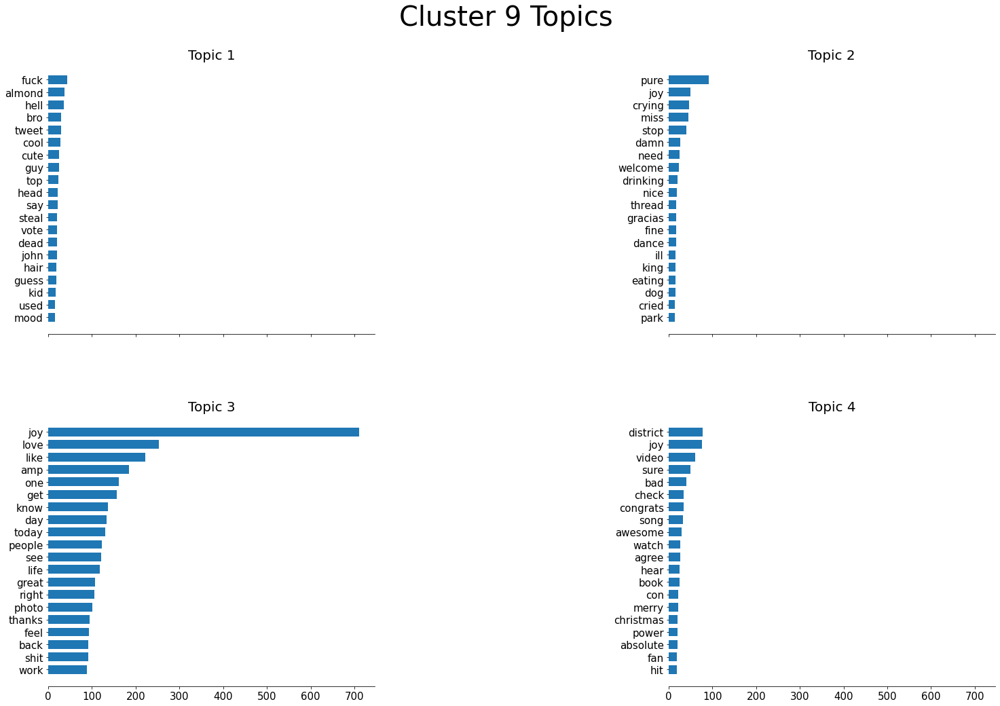

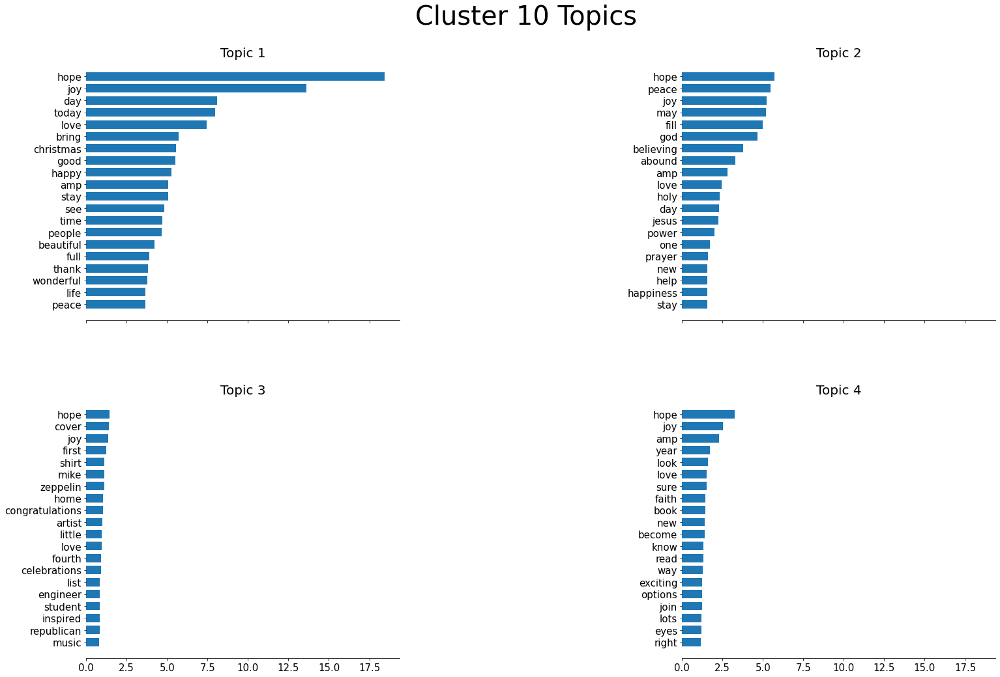

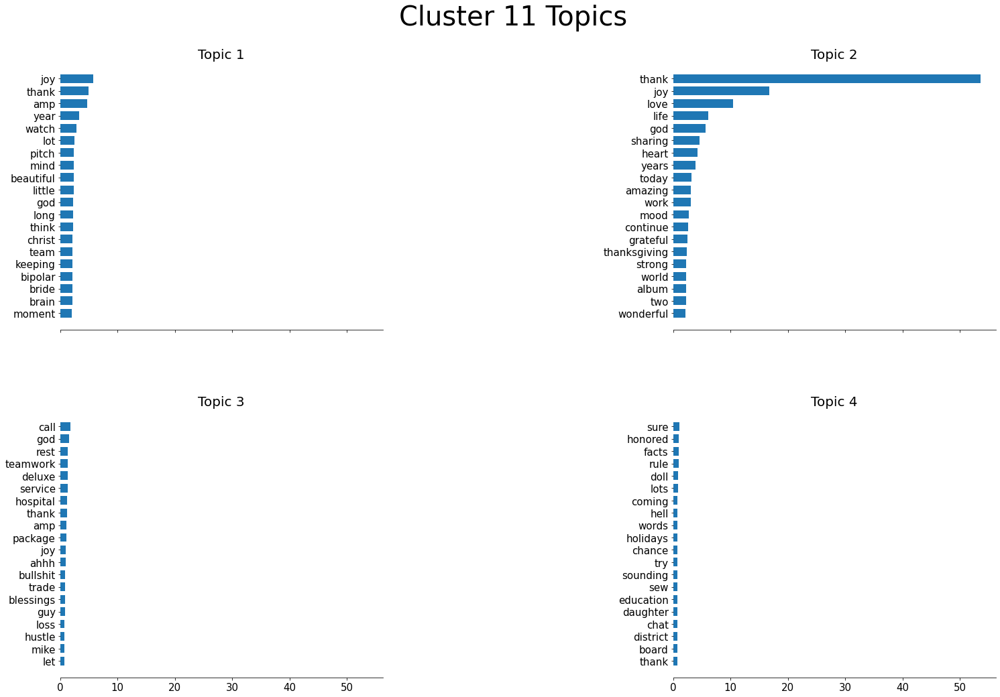

In [27]:
# Topic Modeling for tfidf vectors

result={'cluster':kmeans_vectors,'data':df['clean_tweet']}

result=pd.DataFrame(result)


for k in range(0,12):

    # extract a given cluster
    s=result[result.cluster==k]

    # perform topic modeling on a cluster
    vectorizer = TfidfVectorizer(vocabulary = terms, ngram_range=(1,2))
    vectors = vectorizer.fit_transform(s['data'].values.astype('U'))

    lda_model = LatentDirichletAllocation(
        n_components = 4,
        max_iter = 1000,
        learning_method = 'online',
        learning_offset = 50,
        random_state = 32
    )
    
    lda_vectors = lda_model.fit(vectors)
    
    n_top_words = 20
    feature_names = vectorizer.get_feature_names_out()
    
    title = "Cluster {} Topics".format(k)
    plot_top_words(lda_model, feature_names, n_top_words, title)
    

   

/tmp/ipykernel_183409/1762620162.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  full_df['month'] = months


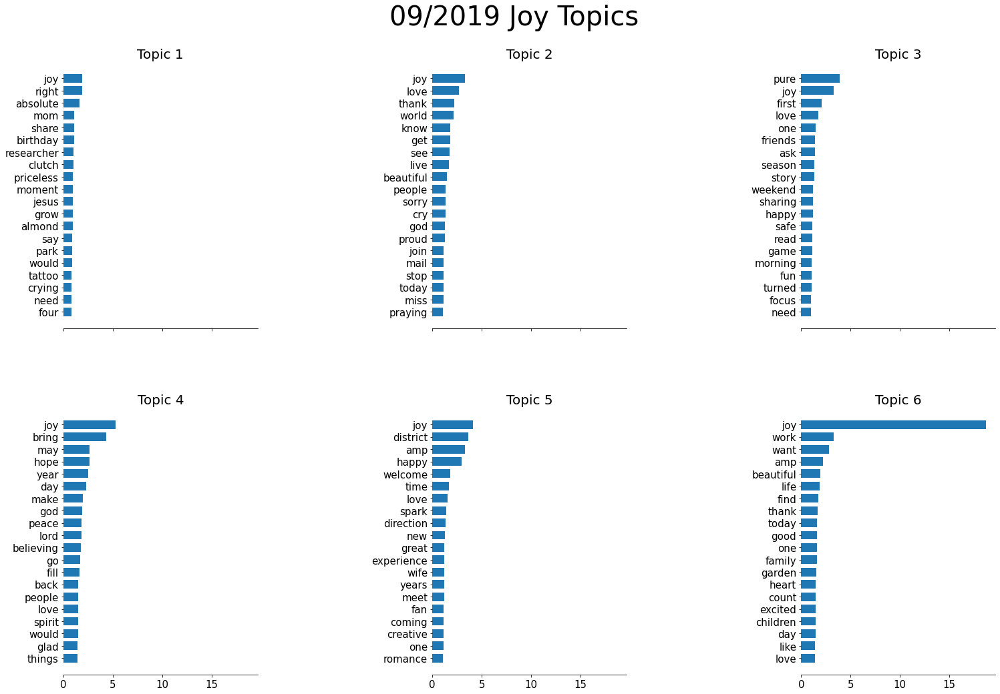

/tmp/ipykernel_183409/1762620162.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  full_df['month'] = months


<Figure size 432x288 with 0 Axes>

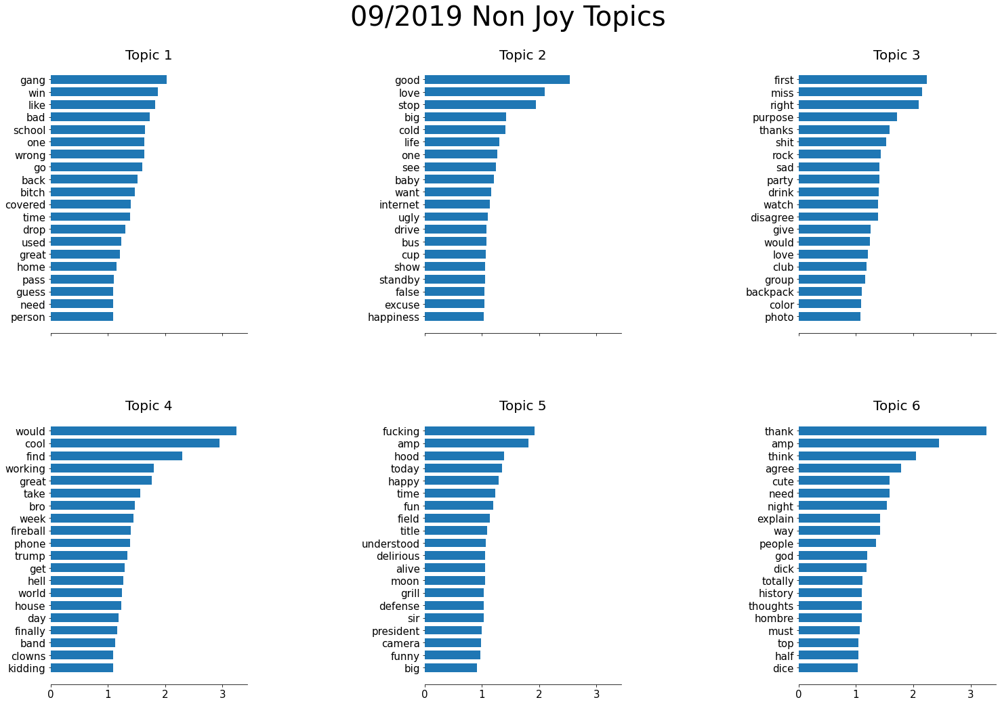

/tmp/ipykernel_183409/1762620162.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  full_df['month'] = months


<Figure size 432x288 with 0 Axes>

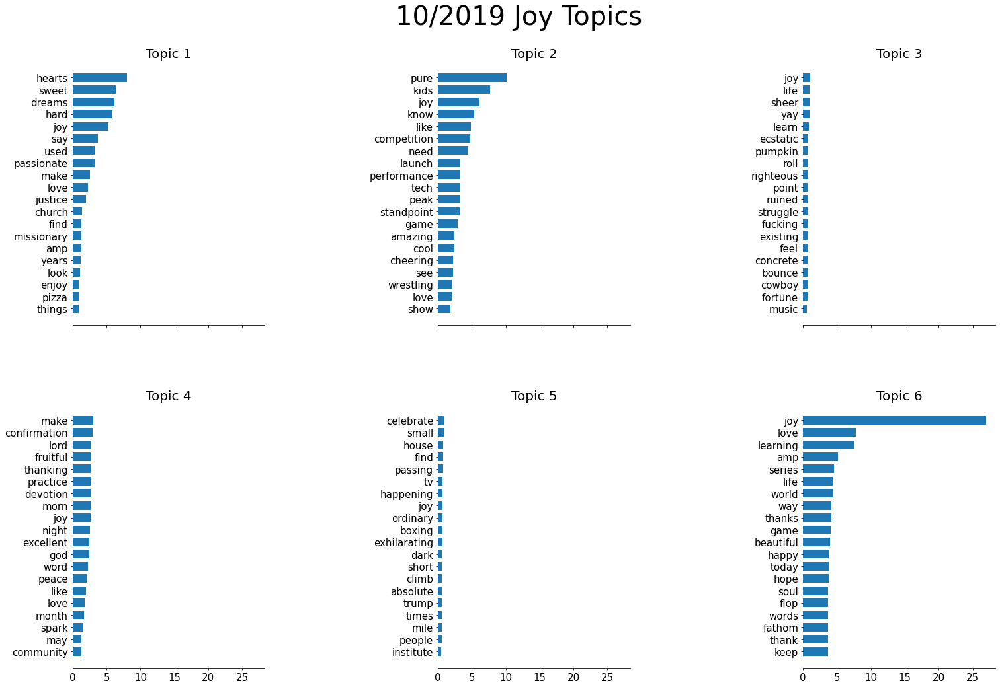

/tmp/ipykernel_183409/1762620162.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  full_df['month'] = months


<Figure size 432x288 with 0 Axes>

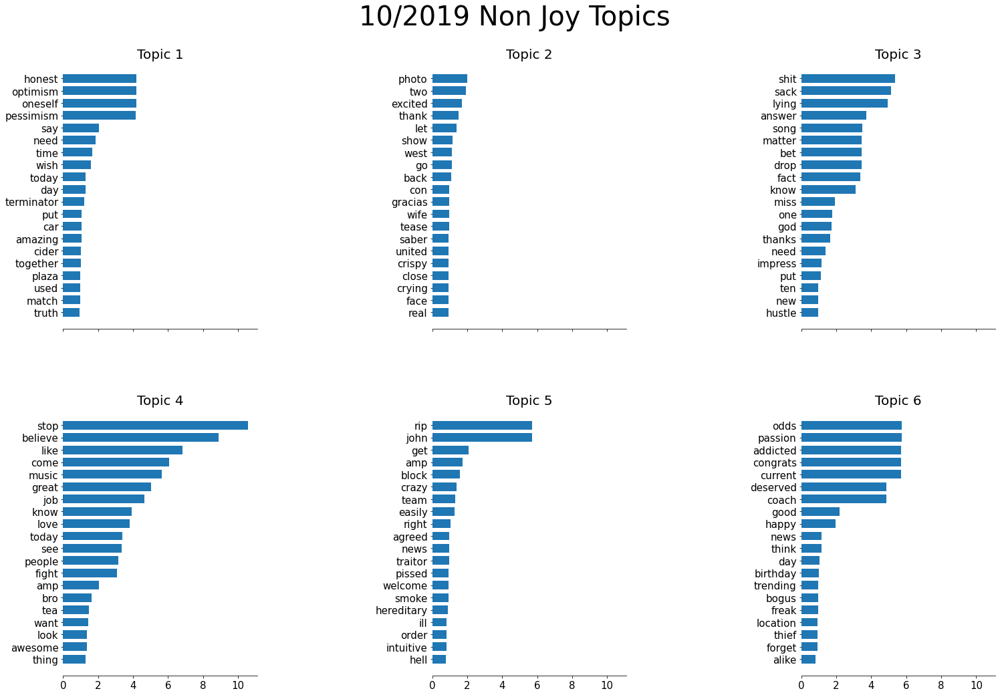

/tmp/ipykernel_183409/1762620162.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  full_df['month'] = months


<Figure size 432x288 with 0 Axes>

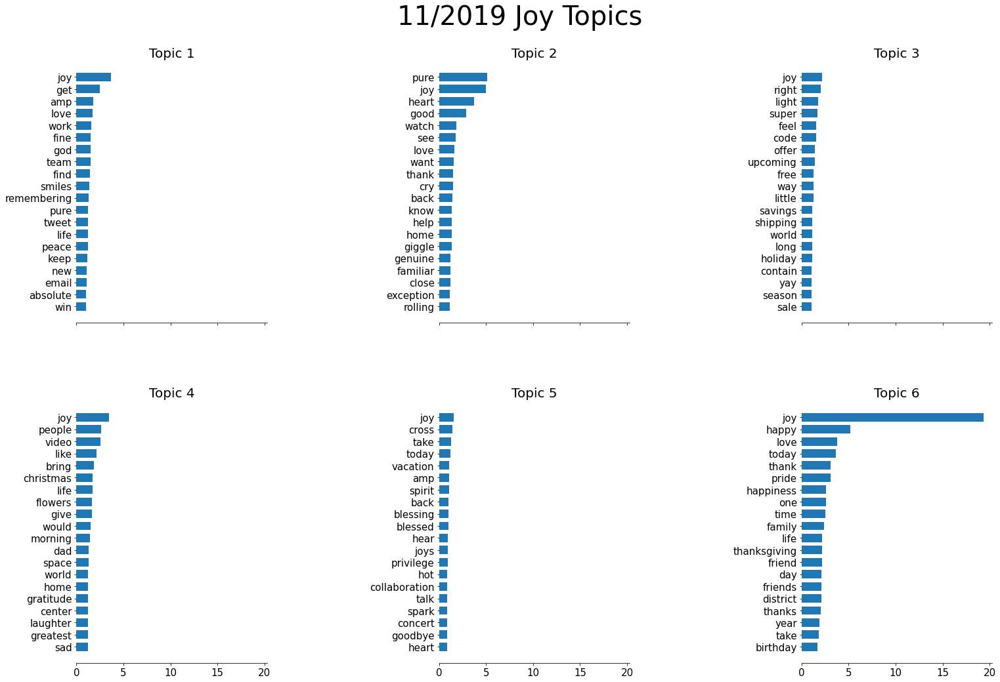

/tmp/ipykernel_183409/1762620162.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  full_df['month'] = months


<Figure size 432x288 with 0 Axes>

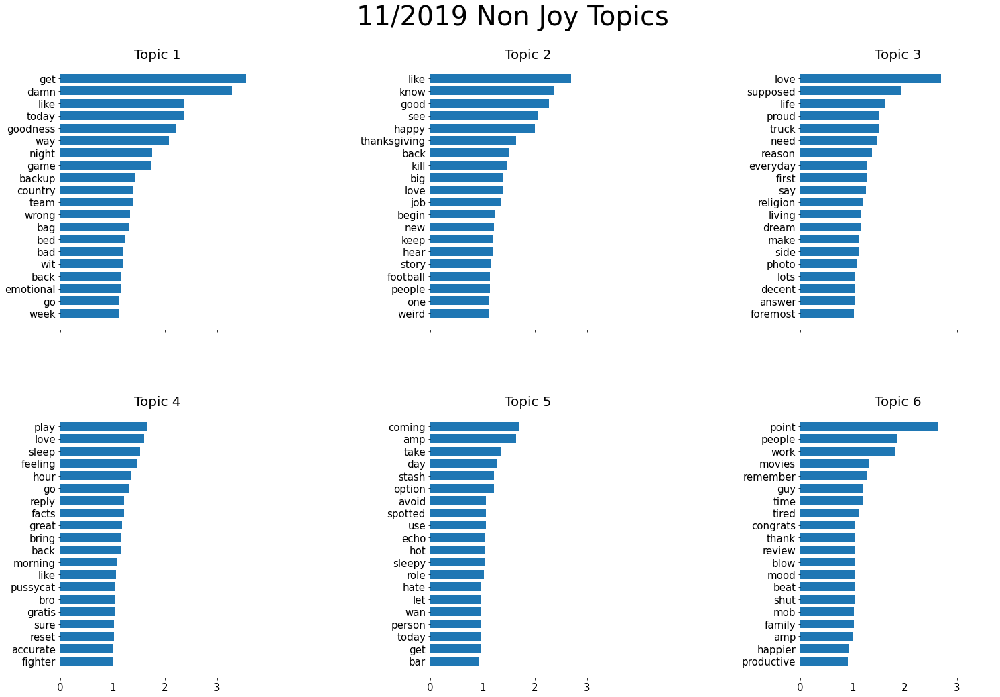

/tmp/ipykernel_183409/1762620162.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  full_df['month'] = months


<Figure size 432x288 with 0 Axes>

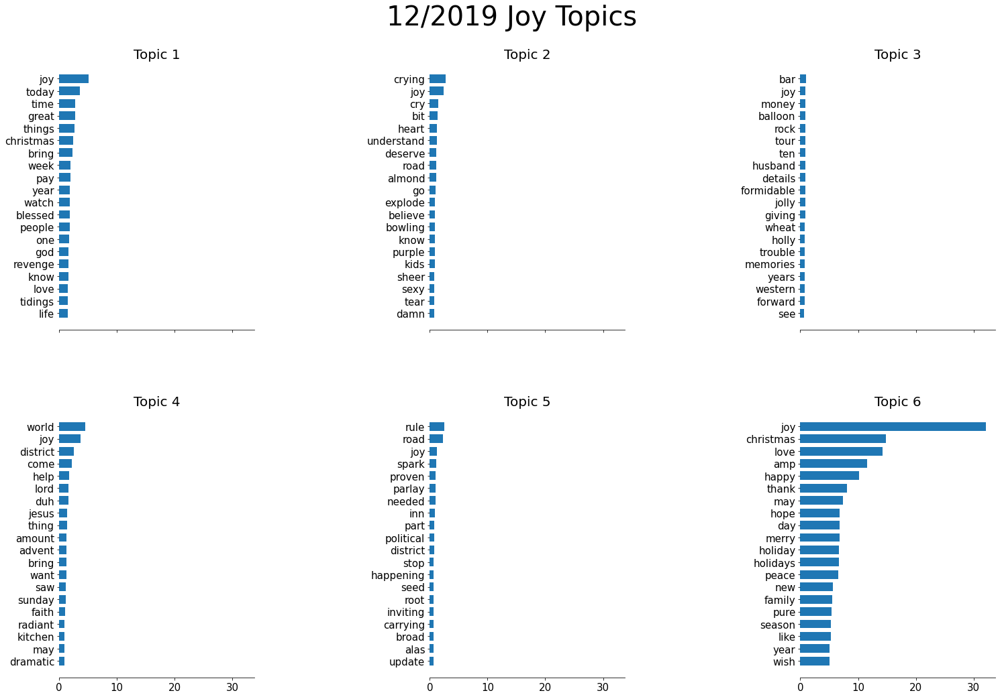

/tmp/ipykernel_183409/1762620162.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  full_df['month'] = months


<Figure size 432x288 with 0 Axes>

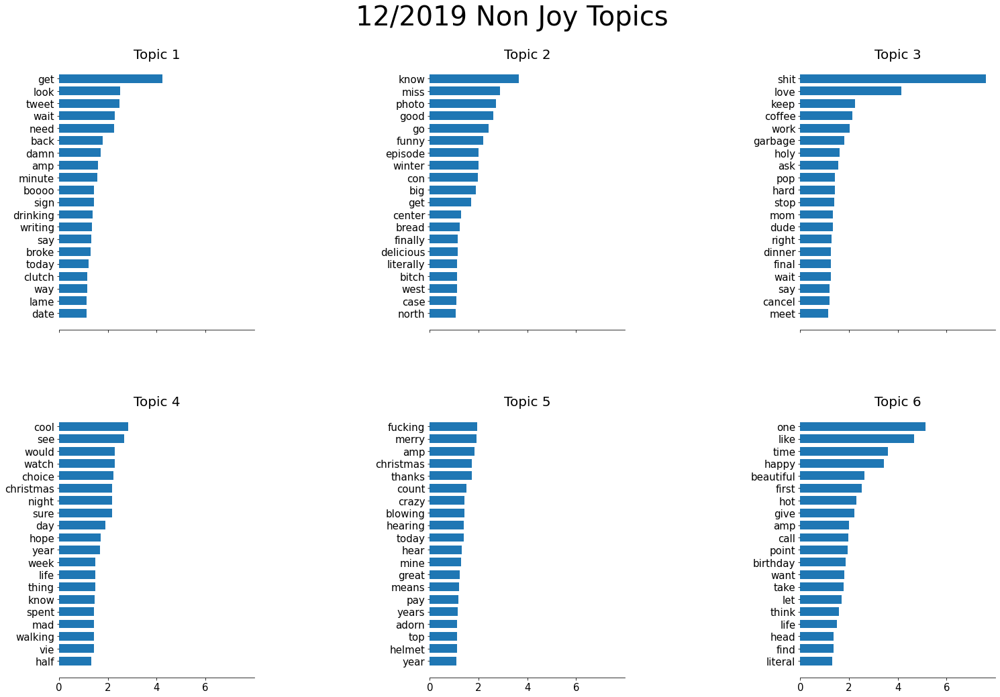

/tmp/ipykernel_183409/1762620162.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  full_df['month'] = months


<Figure size 432x288 with 0 Axes>

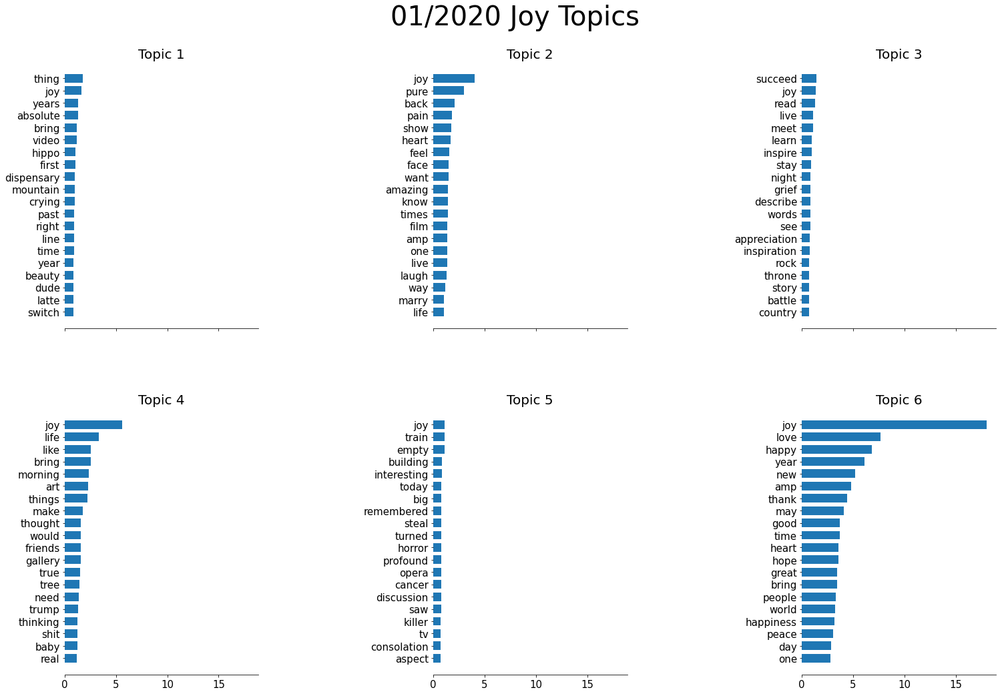

/tmp/ipykernel_183409/1762620162.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  full_df['month'] = months


<Figure size 432x288 with 0 Axes>

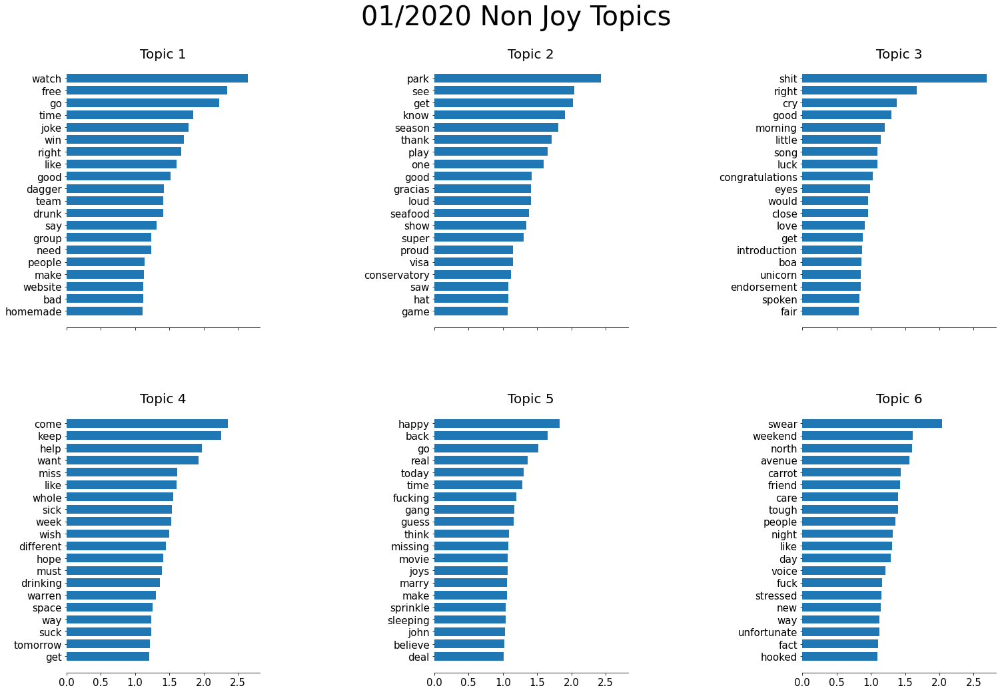

/tmp/ipykernel_183409/1762620162.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  full_df['month'] = months


<Figure size 432x288 with 0 Axes>

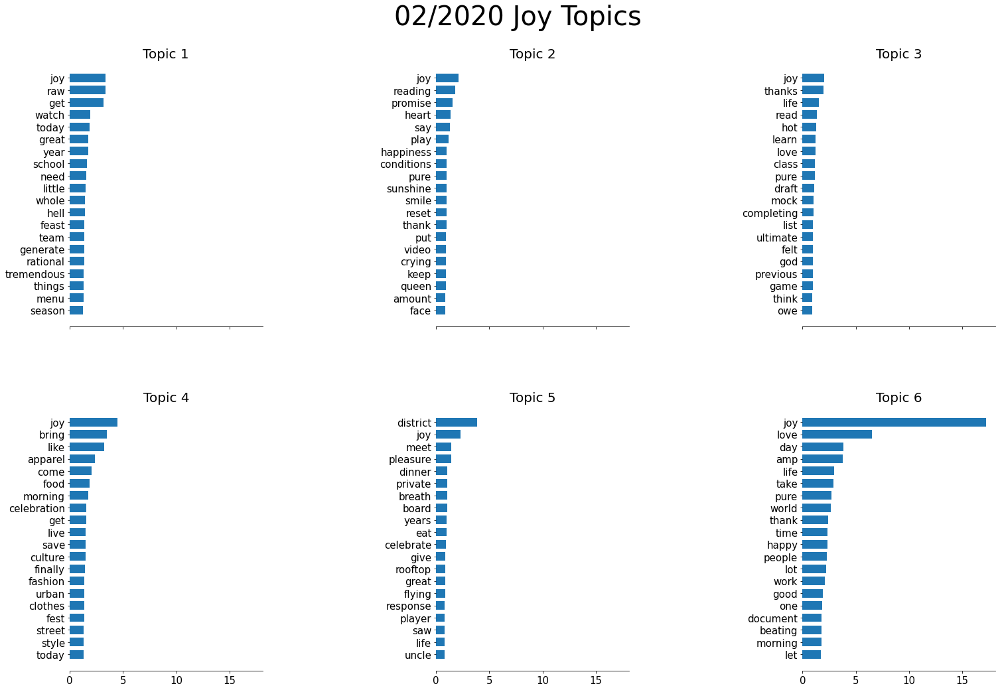

/tmp/ipykernel_183409/1762620162.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  full_df['month'] = months


<Figure size 432x288 with 0 Axes>

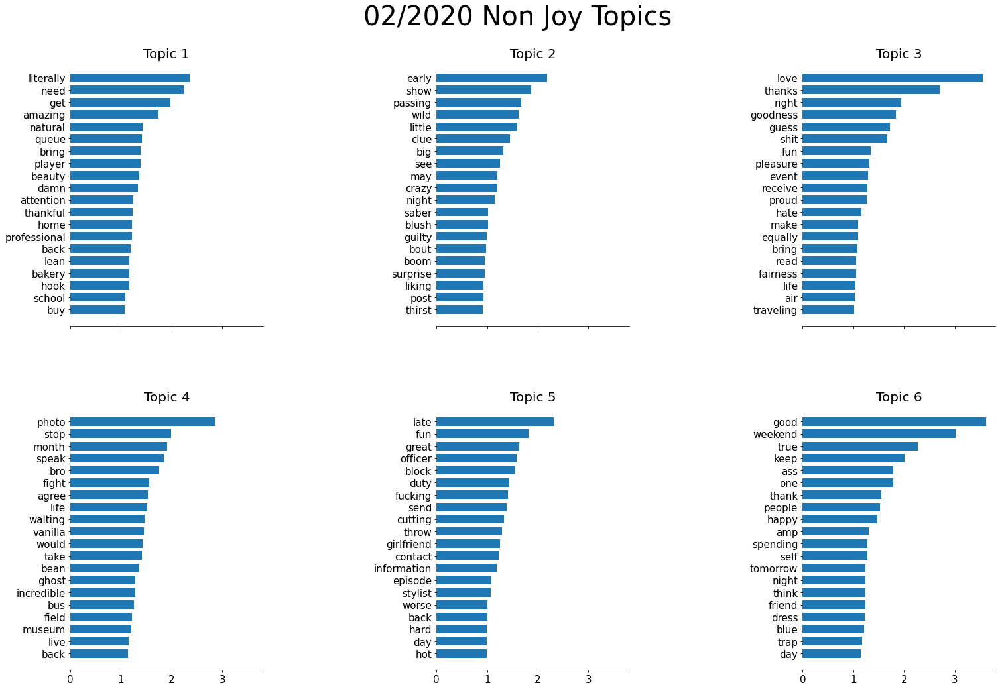

/tmp/ipykernel_183409/1762620162.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  full_df['month'] = months


<Figure size 432x288 with 0 Axes>

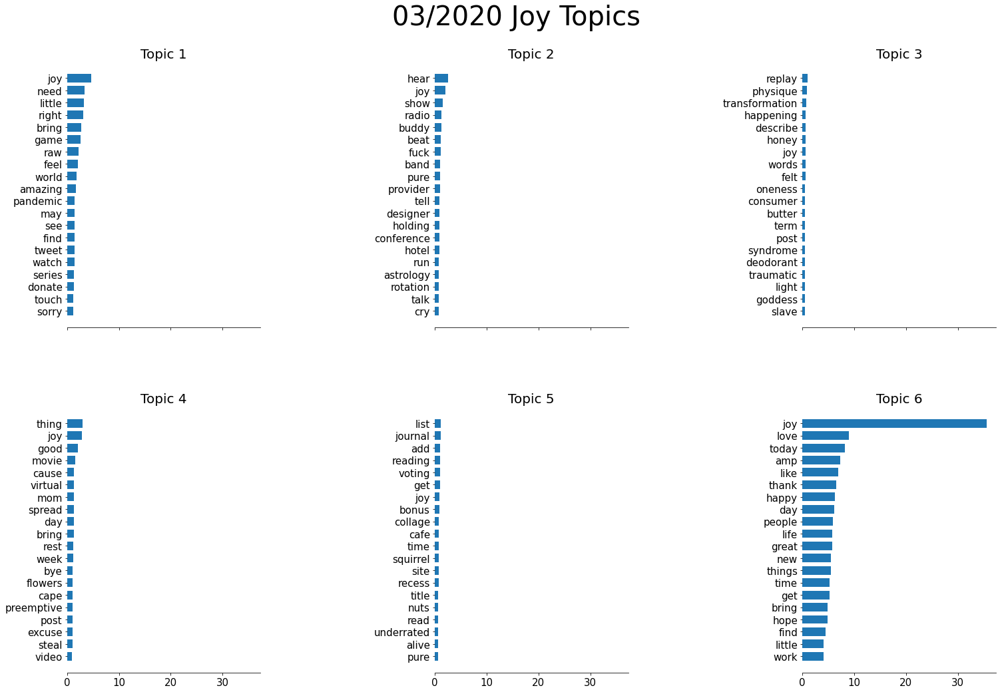

/tmp/ipykernel_183409/1762620162.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  full_df['month'] = months


<Figure size 432x288 with 0 Axes>

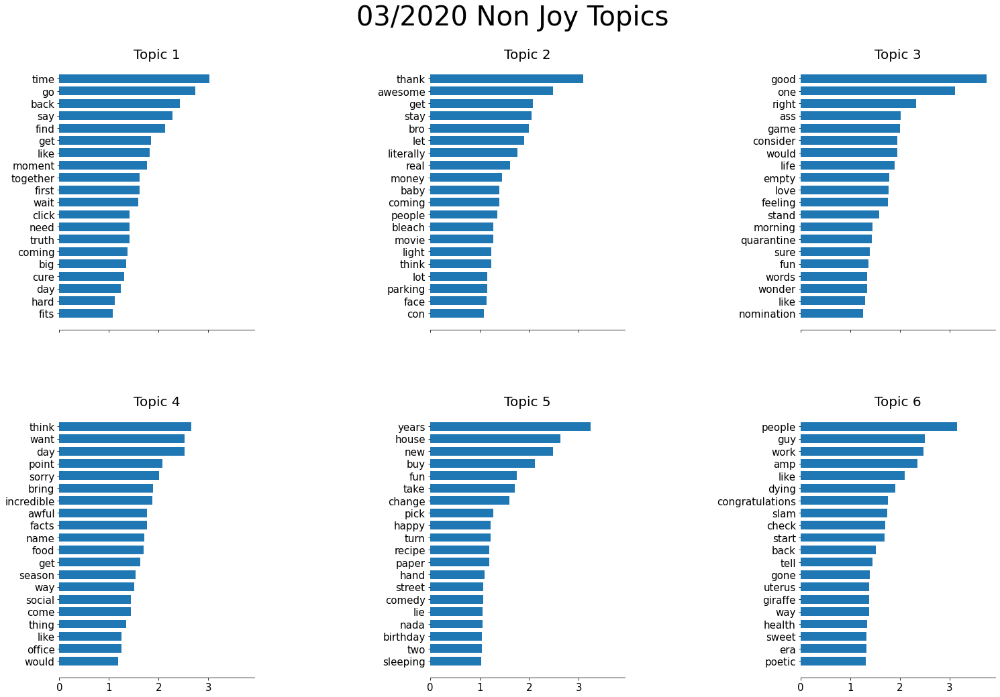

/tmp/ipykernel_183409/1762620162.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  full_df['month'] = months


<Figure size 432x288 with 0 Axes>

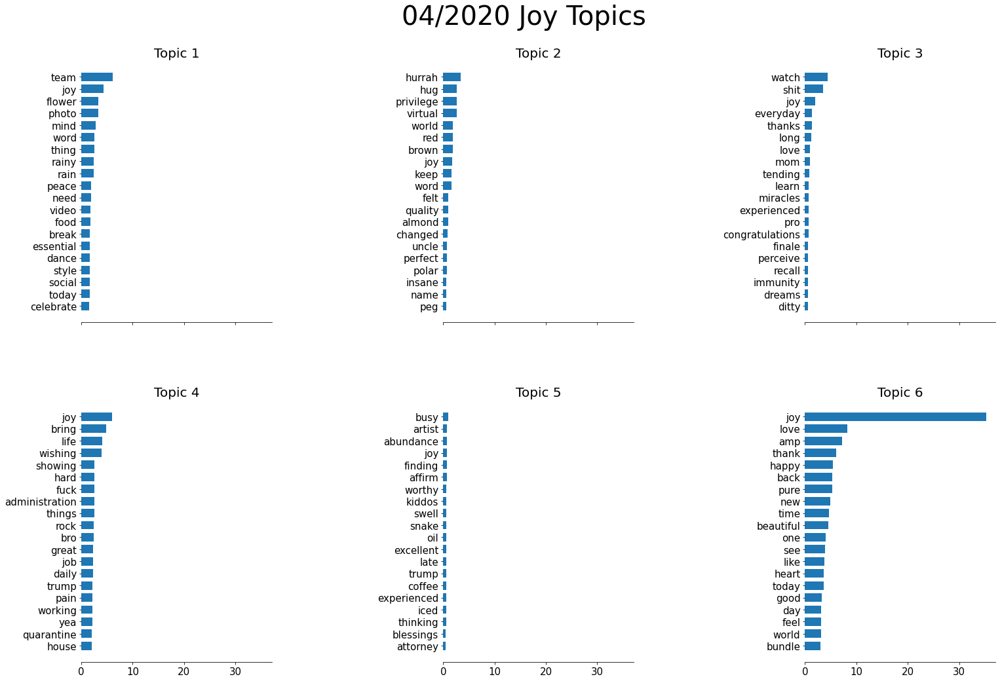

/tmp/ipykernel_183409/1762620162.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  full_df['month'] = months


<Figure size 432x288 with 0 Axes>

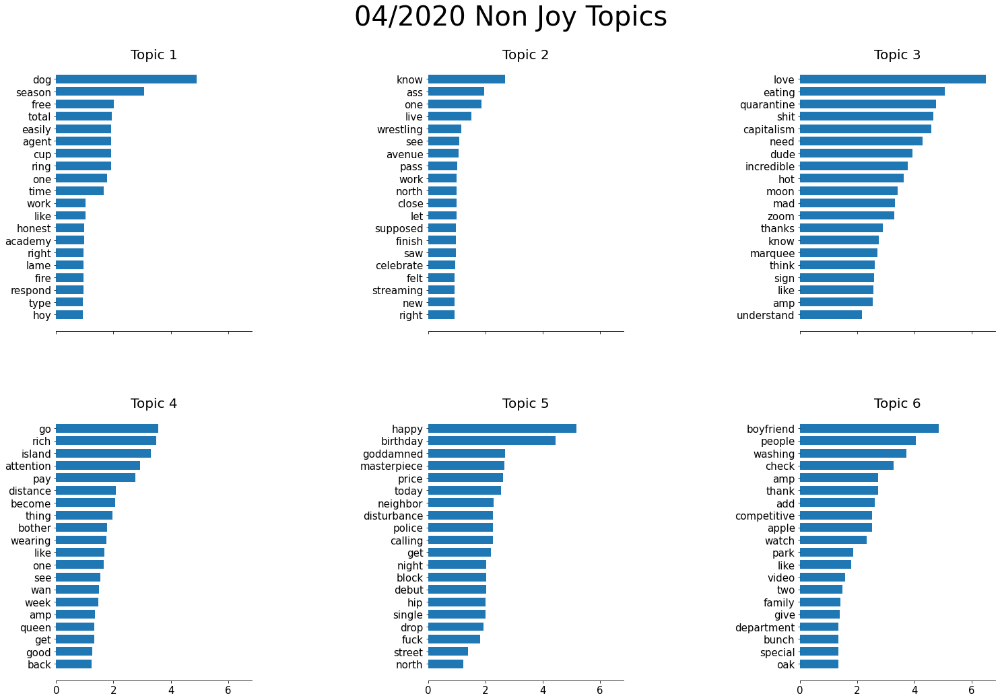

/tmp/ipykernel_183409/1762620162.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  full_df['month'] = months


<Figure size 432x288 with 0 Axes>

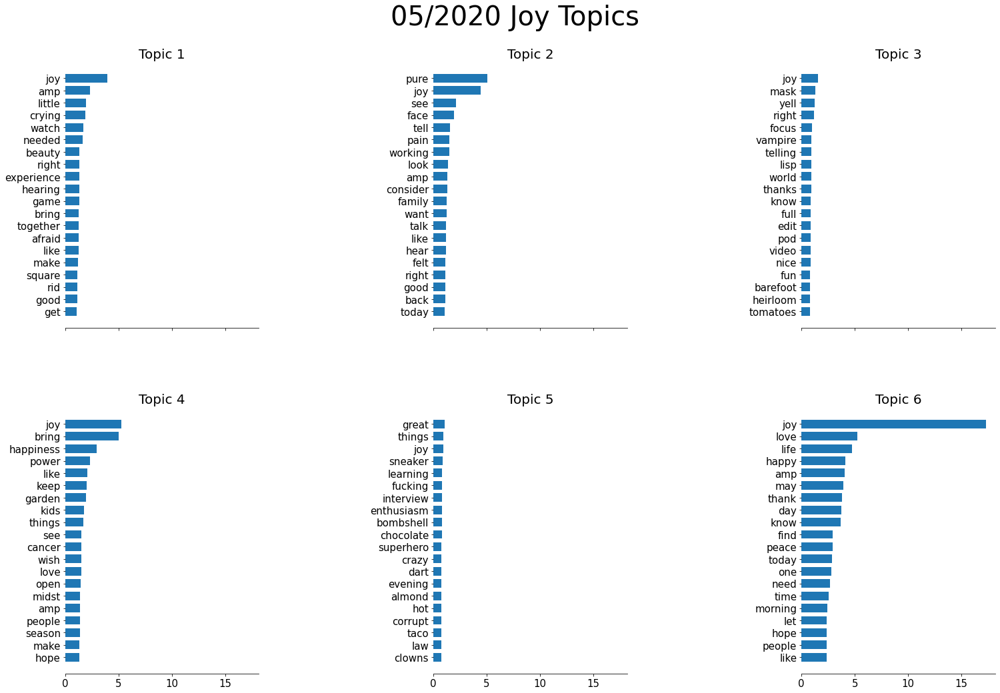

/tmp/ipykernel_183409/1762620162.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  full_df['month'] = months


<Figure size 432x288 with 0 Axes>

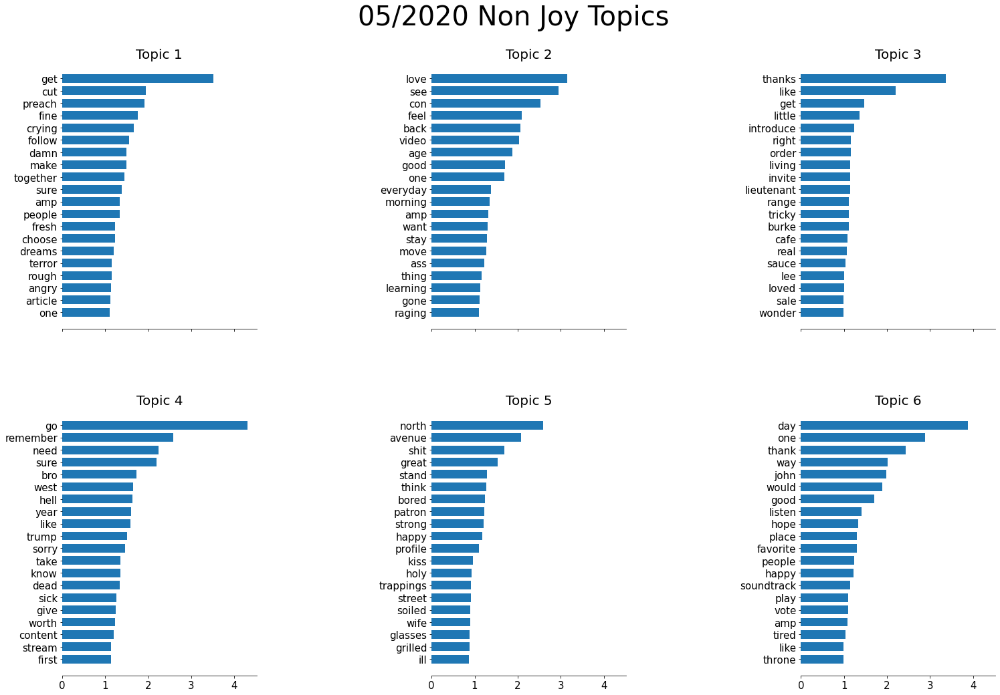

/tmp/ipykernel_183409/1762620162.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  full_df['month'] = months


<Figure size 432x288 with 0 Axes>

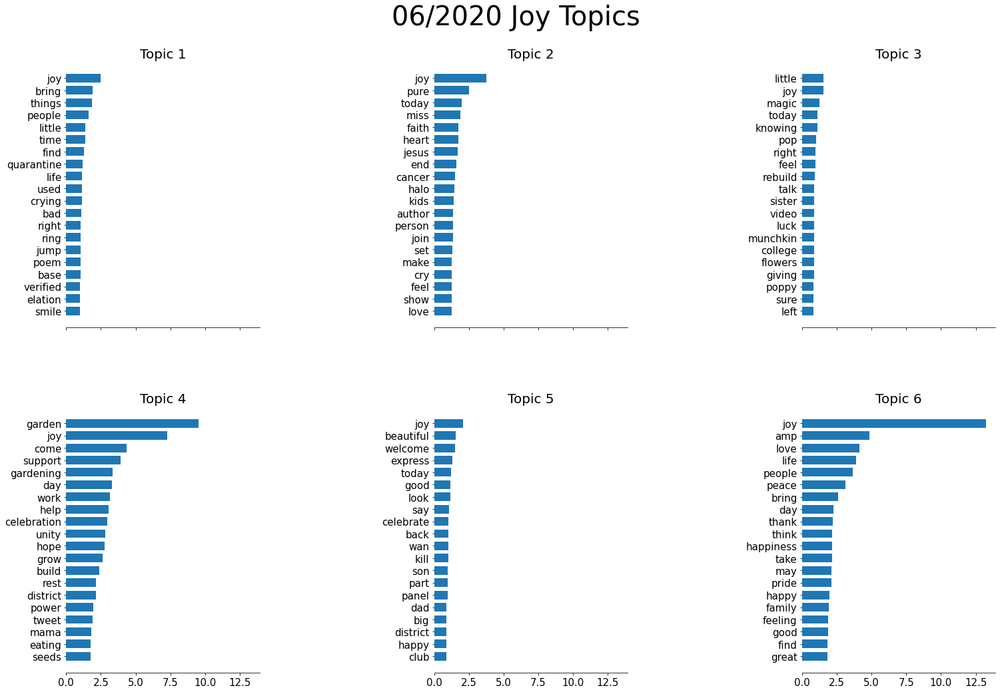

/tmp/ipykernel_183409/1762620162.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  full_df['month'] = months


<Figure size 432x288 with 0 Axes>

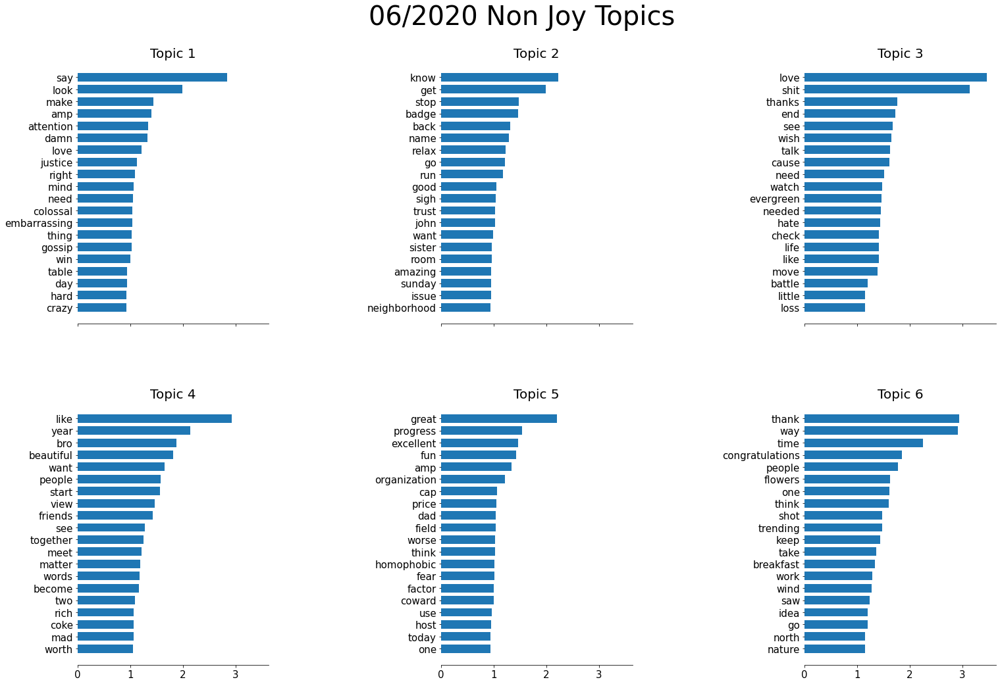

/tmp/ipykernel_183409/1762620162.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  full_df['month'] = months


<Figure size 432x288 with 0 Axes>

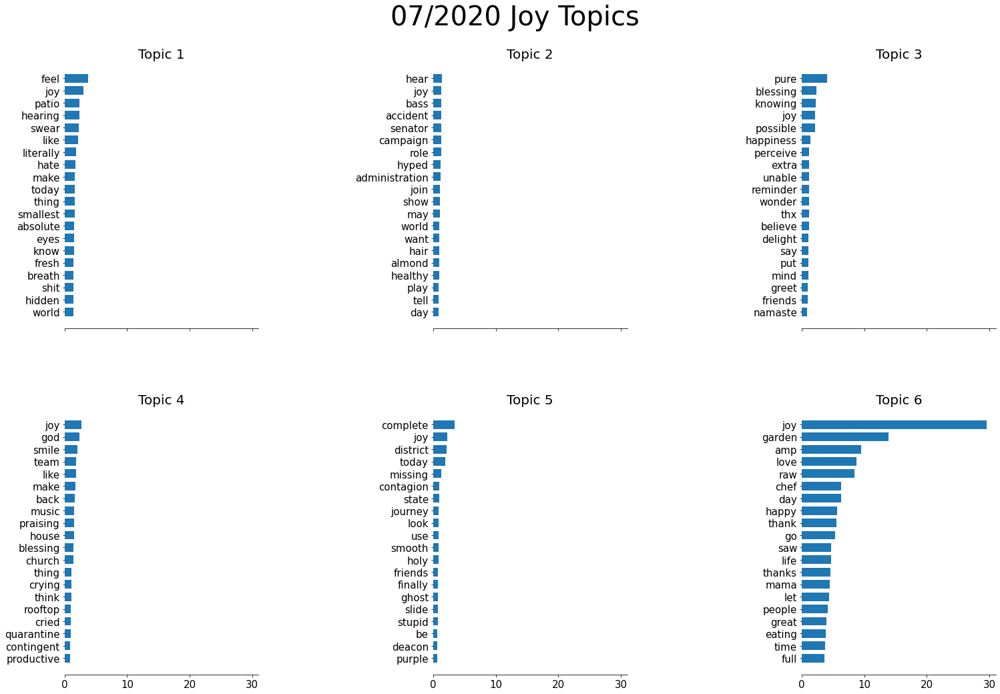

/tmp/ipykernel_183409/1762620162.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  full_df['month'] = months


<Figure size 432x288 with 0 Axes>

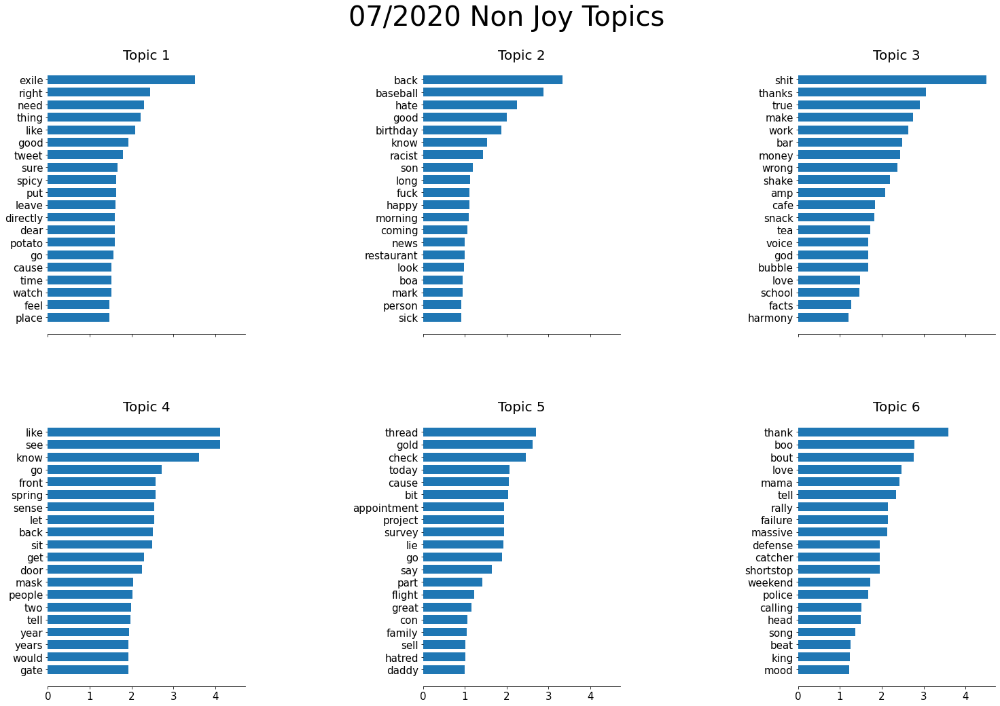

/tmp/ipykernel_183409/1762620162.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  full_df['month'] = months


<Figure size 432x288 with 0 Axes>

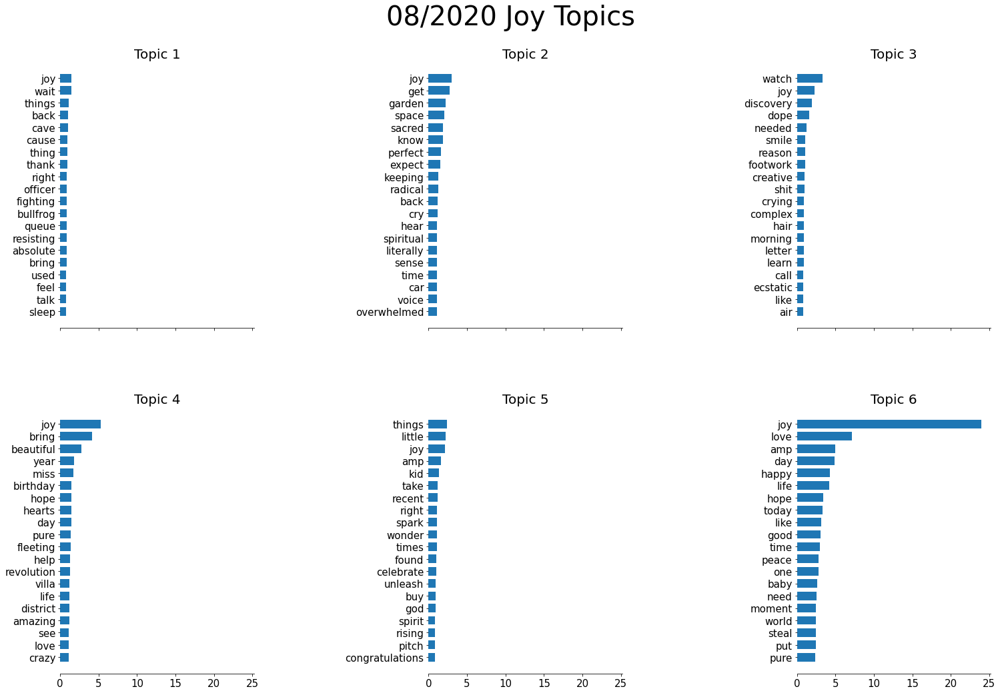

/tmp/ipykernel_183409/1762620162.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  full_df['month'] = months


<Figure size 432x288 with 0 Axes>

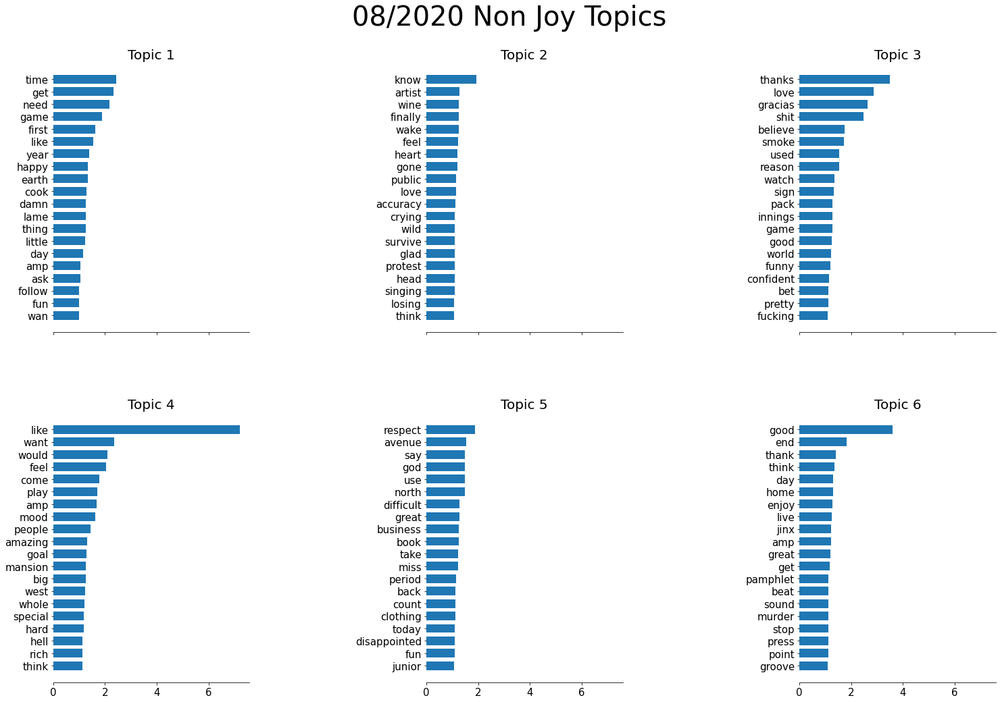

/tmp/ipykernel_183409/1762620162.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  full_df['month'] = months


<Figure size 432x288 with 0 Axes>

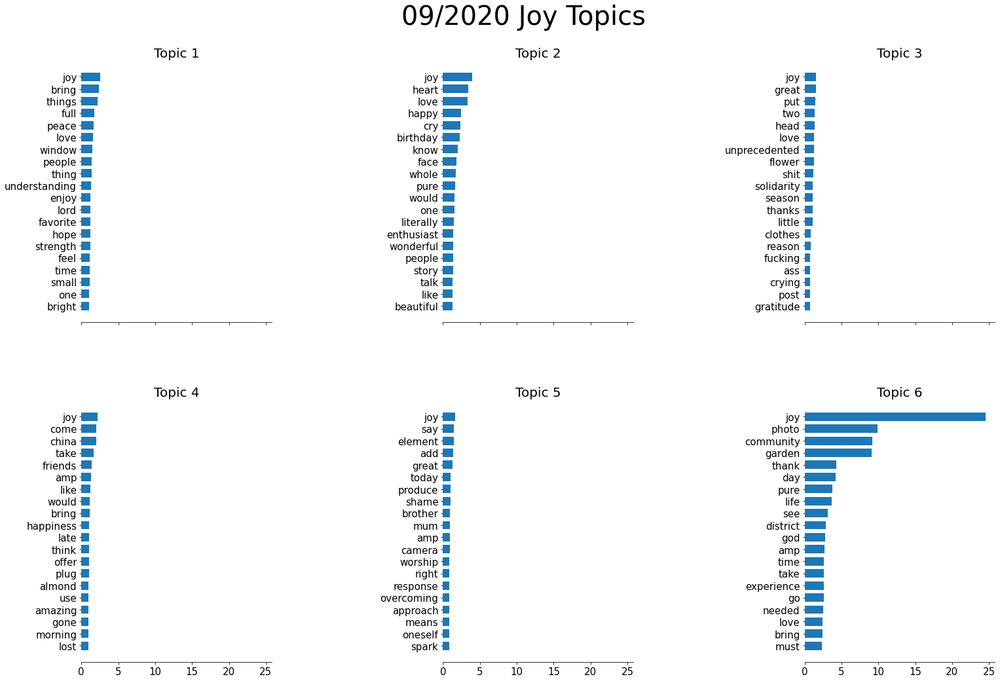

/tmp/ipykernel_183409/1762620162.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  full_df['month'] = months


<Figure size 432x288 with 0 Axes>

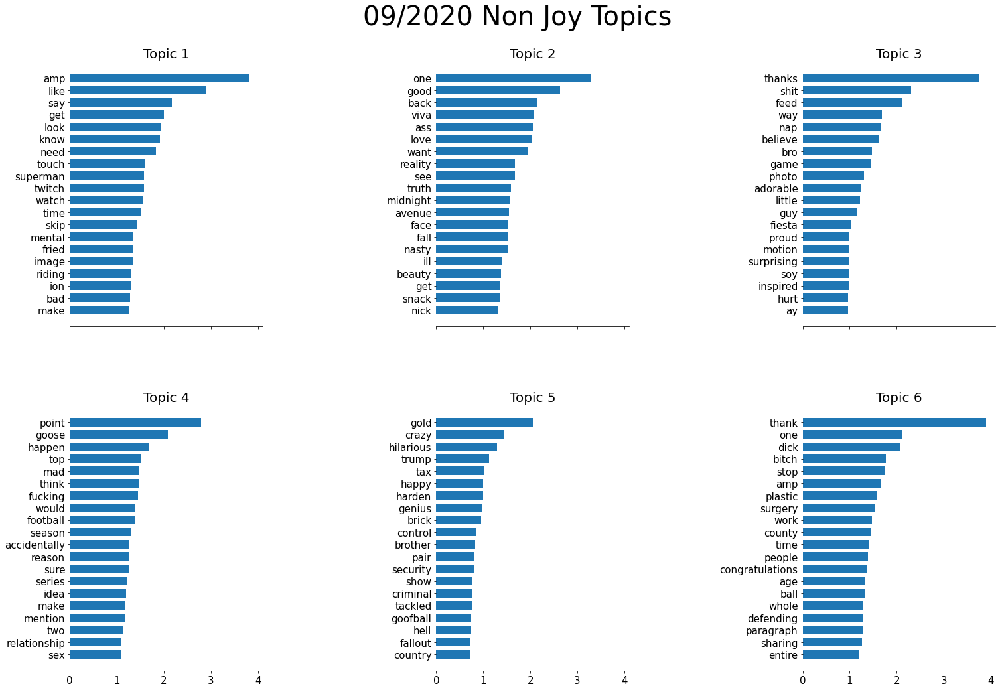

/tmp/ipykernel_183409/1762620162.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  full_df['month'] = months


<Figure size 432x288 with 0 Axes>

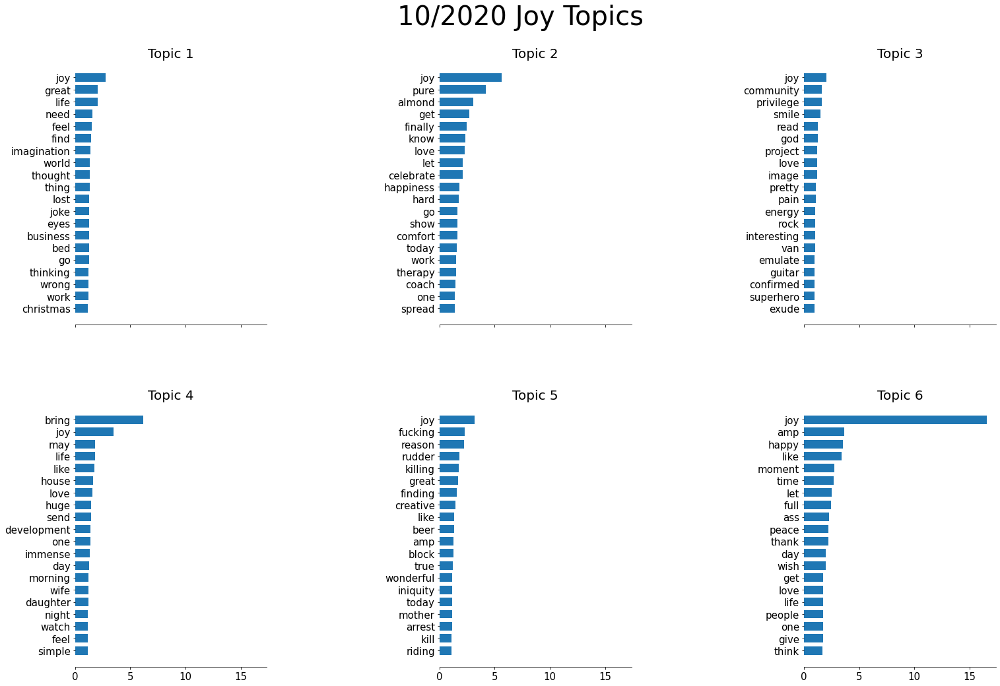

/tmp/ipykernel_183409/1762620162.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  full_df['month'] = months


<Figure size 432x288 with 0 Axes>

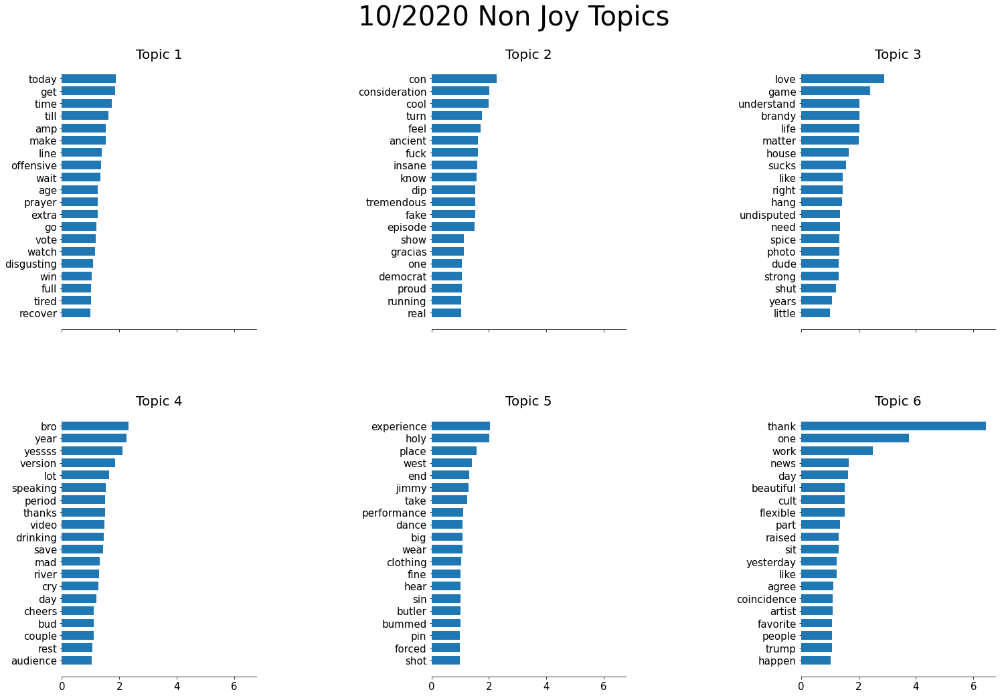

/tmp/ipykernel_183409/1762620162.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  full_df['month'] = months


<Figure size 432x288 with 0 Axes>

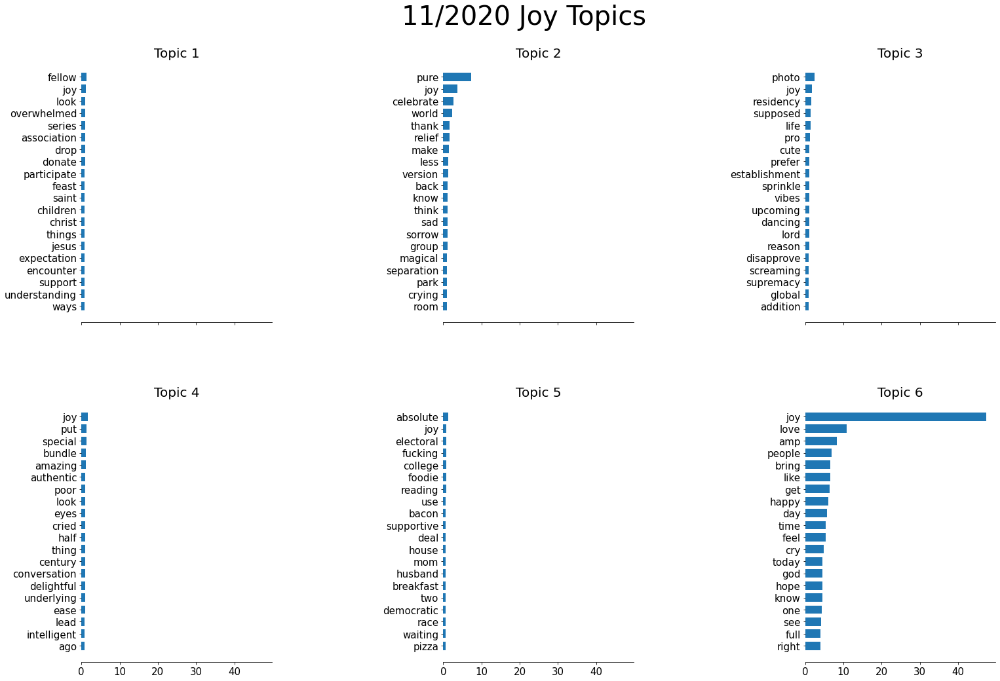

/tmp/ipykernel_183409/1762620162.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  full_df['month'] = months


<Figure size 432x288 with 0 Axes>

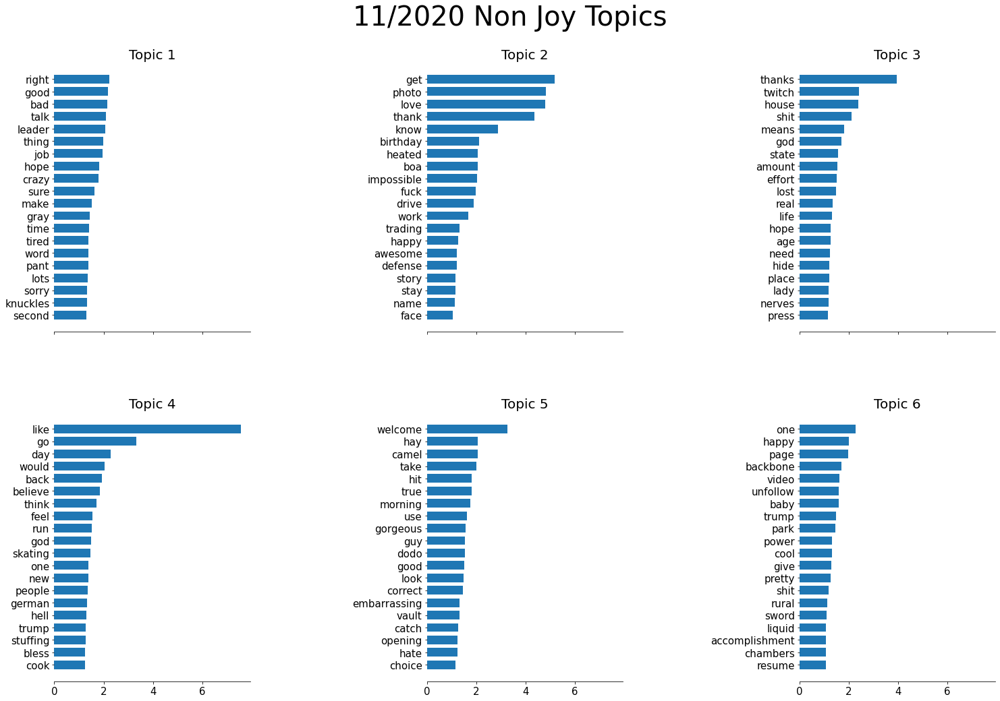

/tmp/ipykernel_183409/1762620162.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  full_df['month'] = months


<Figure size 432x288 with 0 Axes>

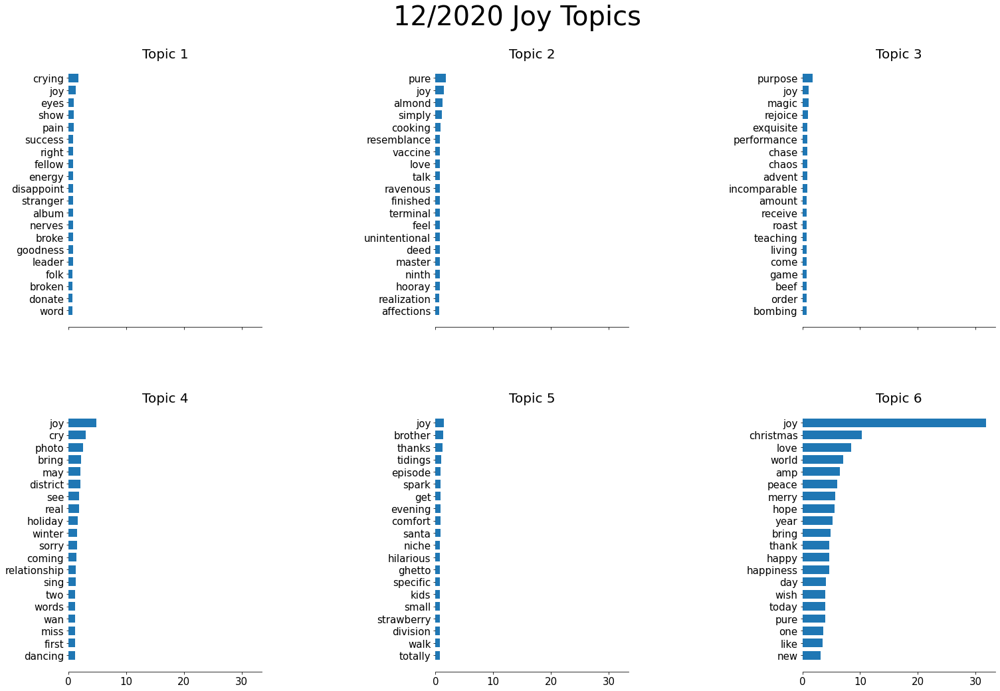

/tmp/ipykernel_183409/1762620162.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  full_df['month'] = months


<Figure size 432x288 with 0 Axes>

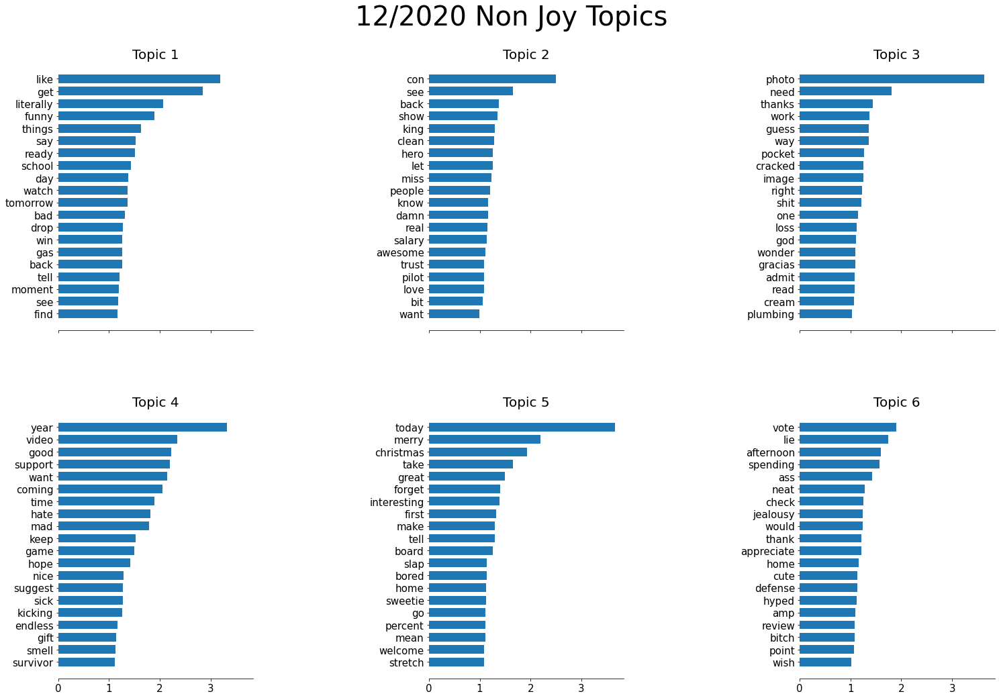

/tmp/ipykernel_183409/1762620162.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  full_df['month'] = months


<Figure size 432x288 with 0 Axes>

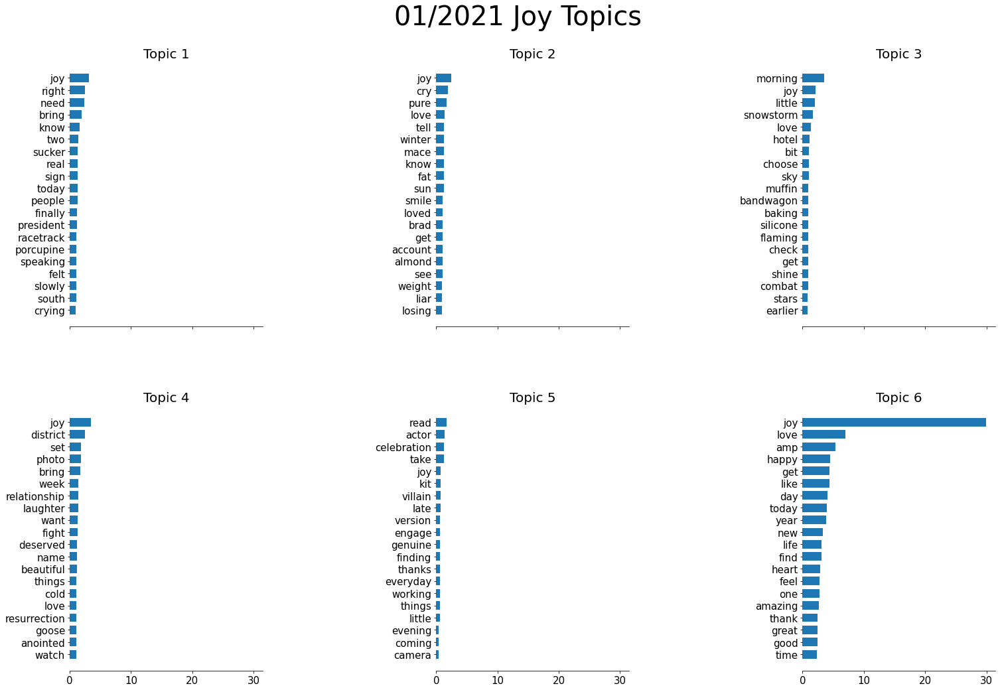

/tmp/ipykernel_183409/1762620162.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  full_df['month'] = months


<Figure size 432x288 with 0 Axes>

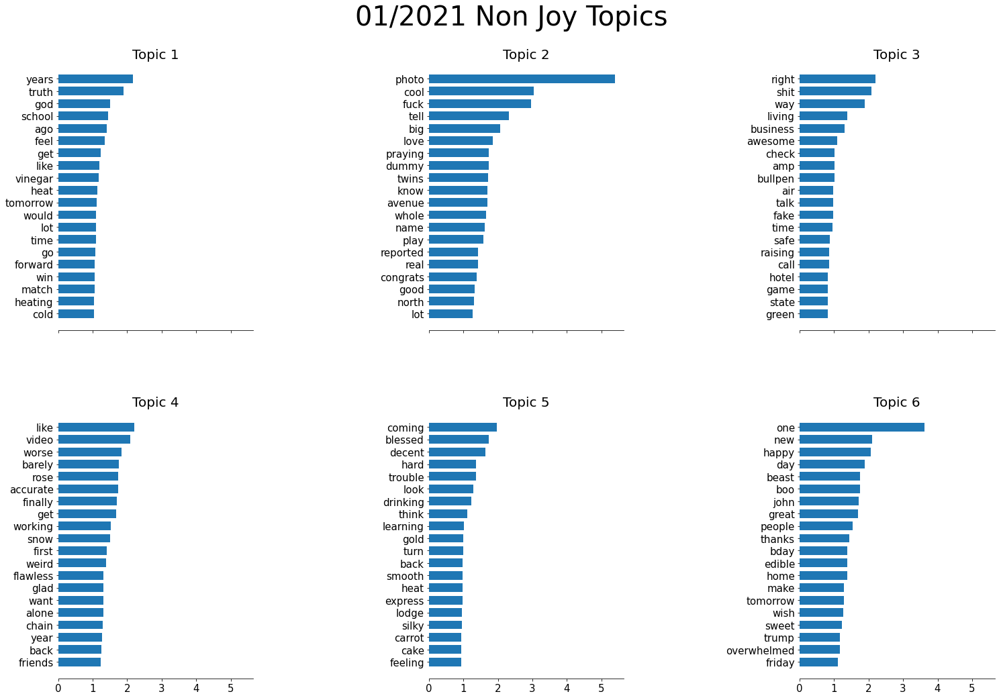

/tmp/ipykernel_183409/1762620162.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  full_df['month'] = months


<Figure size 432x288 with 0 Axes>

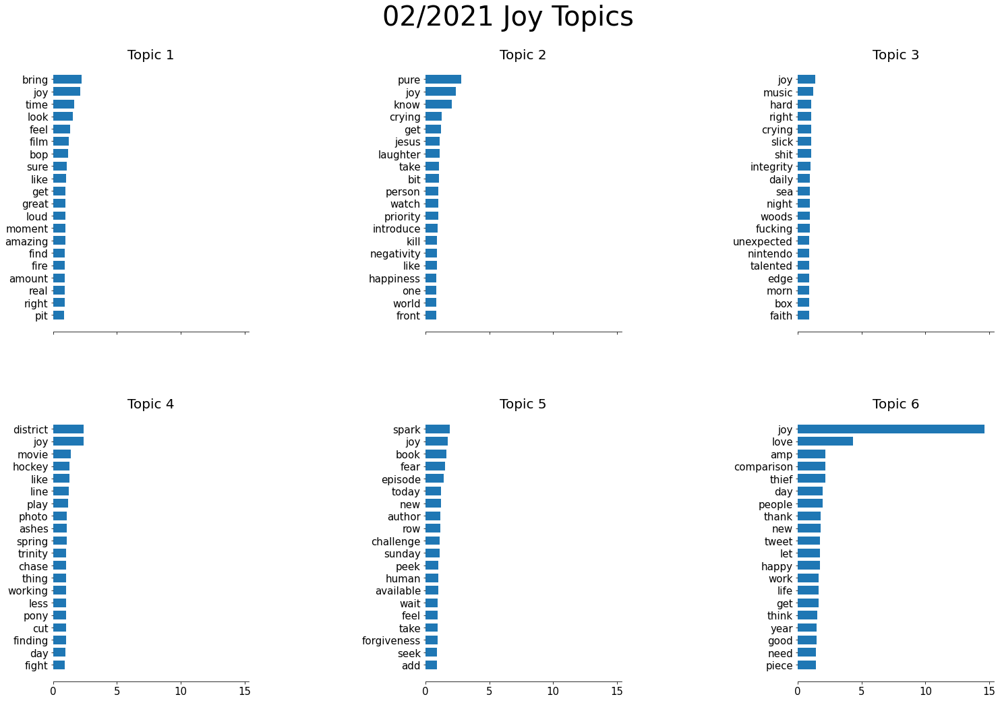

/tmp/ipykernel_183409/1762620162.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  full_df['month'] = months


<Figure size 432x288 with 0 Axes>

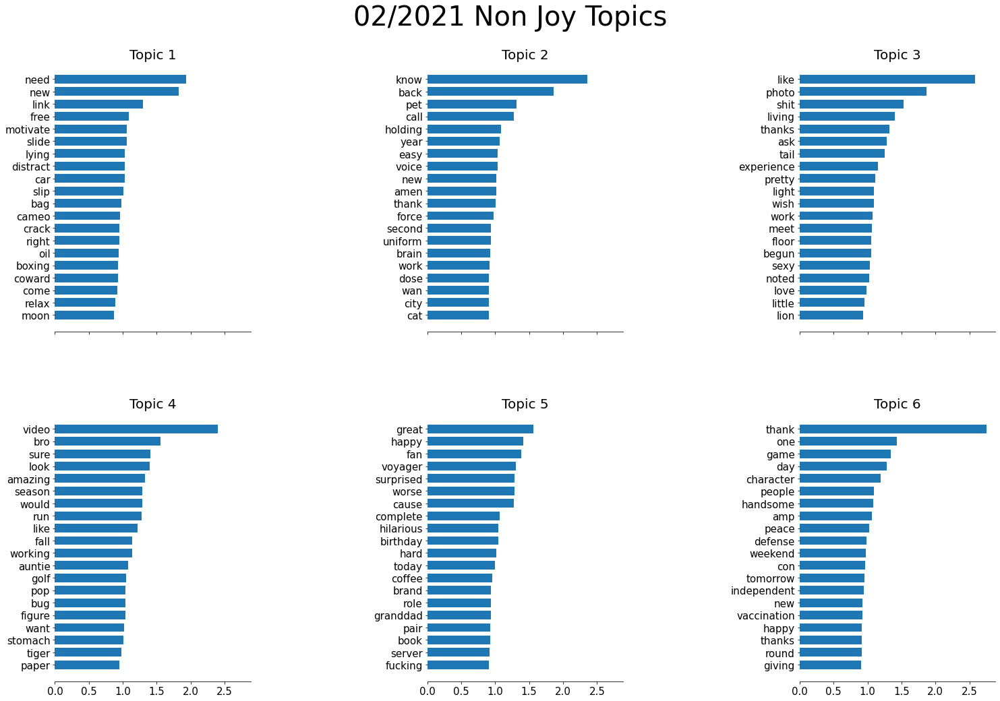

/tmp/ipykernel_183409/1762620162.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  full_df['month'] = months


<Figure size 432x288 with 0 Axes>

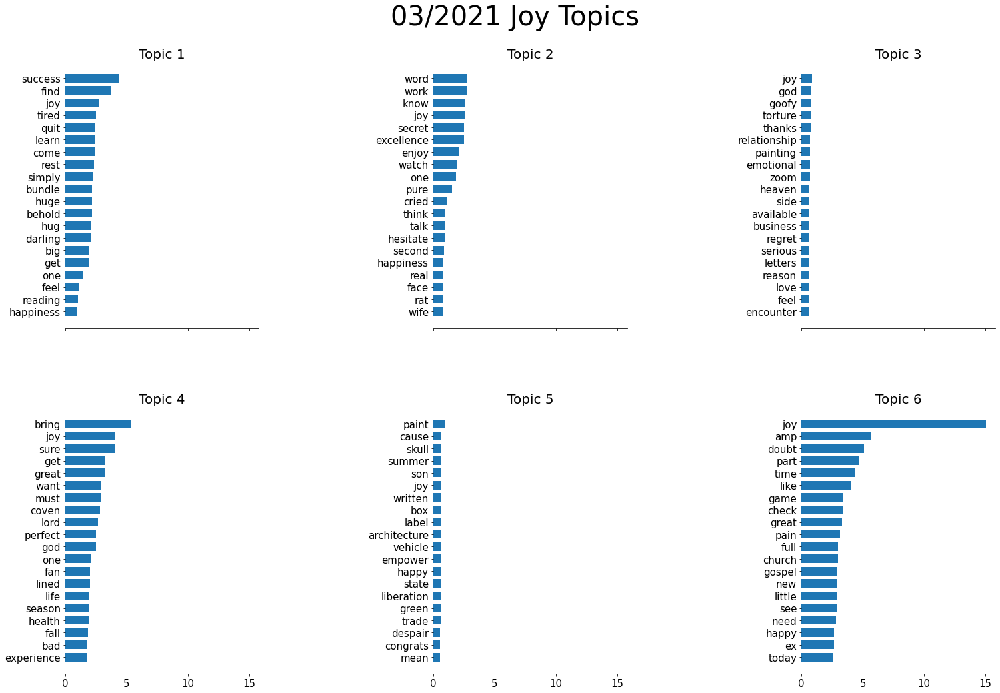

/tmp/ipykernel_183409/1762620162.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  full_df['month'] = months


<Figure size 432x288 with 0 Axes>

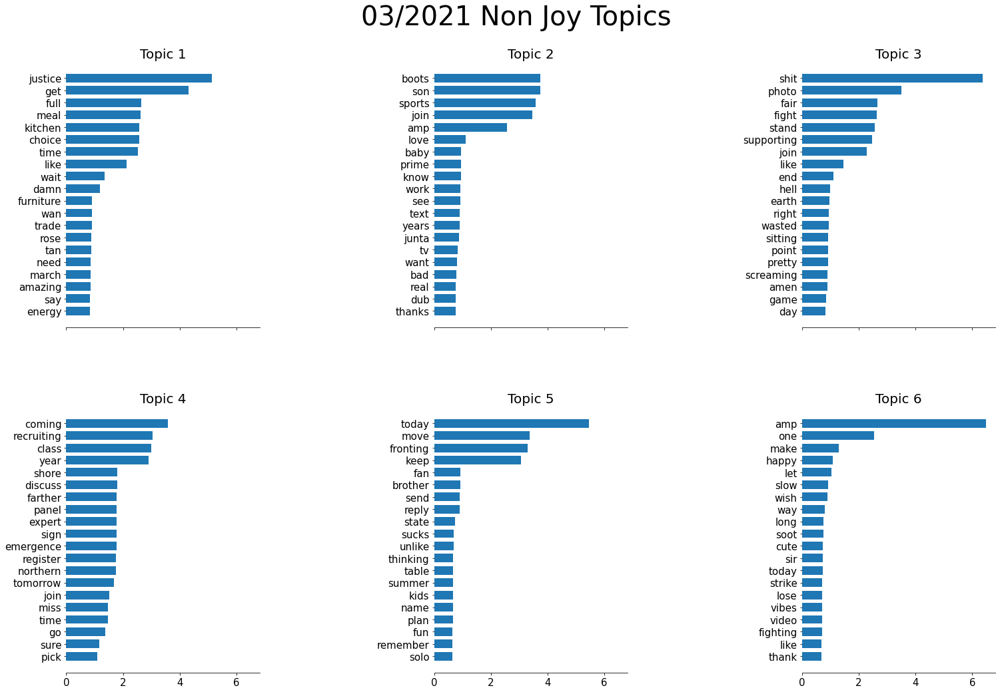

/tmp/ipykernel_183409/1762620162.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  full_df['month'] = months


<Figure size 432x288 with 0 Axes>

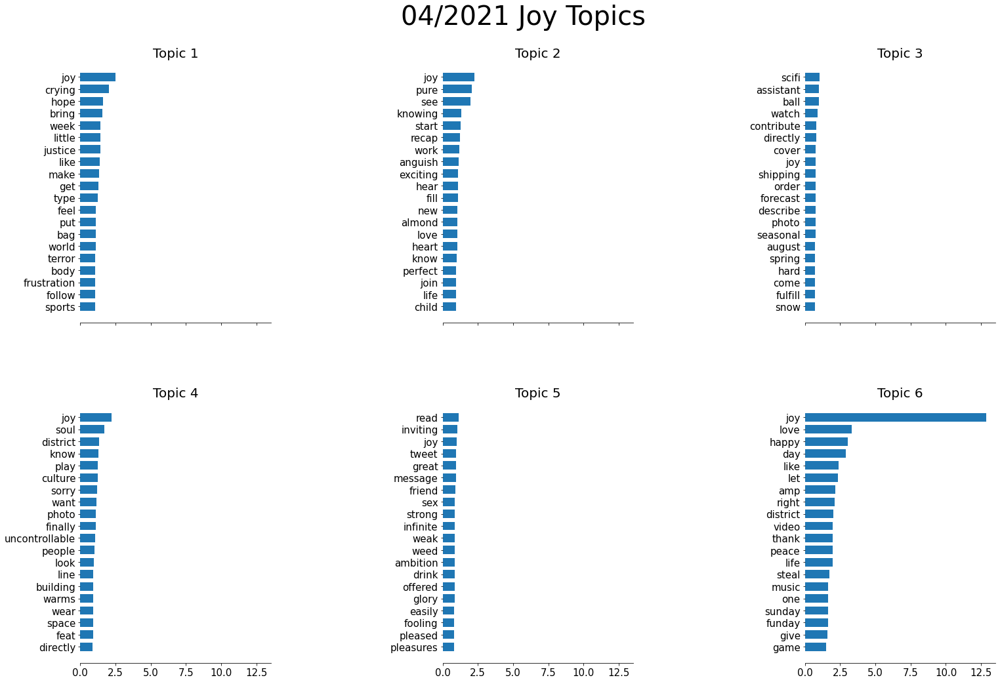

/tmp/ipykernel_183409/1762620162.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  full_df['month'] = months


<Figure size 432x288 with 0 Axes>

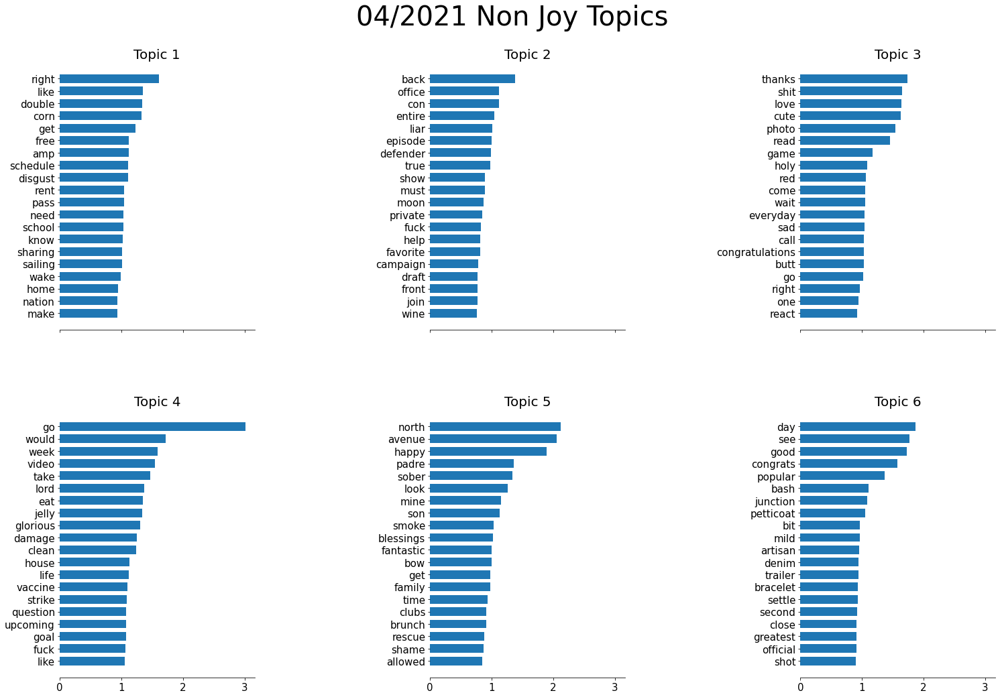

/tmp/ipykernel_183409/1762620162.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  full_df['month'] = months


<Figure size 432x288 with 0 Axes>

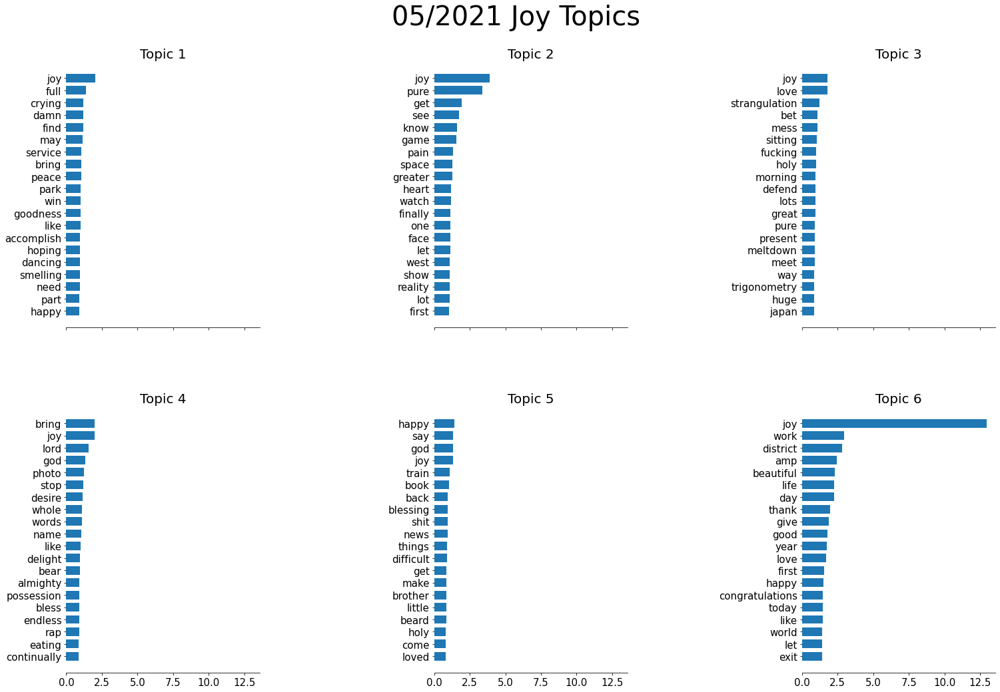

/tmp/ipykernel_183409/1762620162.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  full_df['month'] = months


<Figure size 432x288 with 0 Axes>

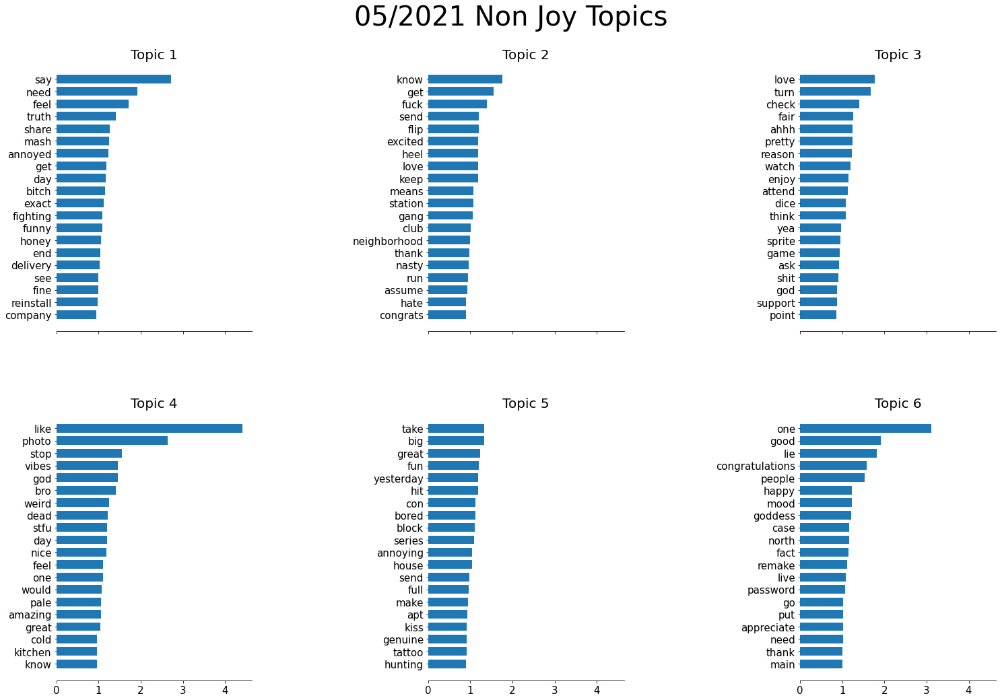

/tmp/ipykernel_183409/1762620162.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  full_df['month'] = months


<Figure size 432x288 with 0 Axes>

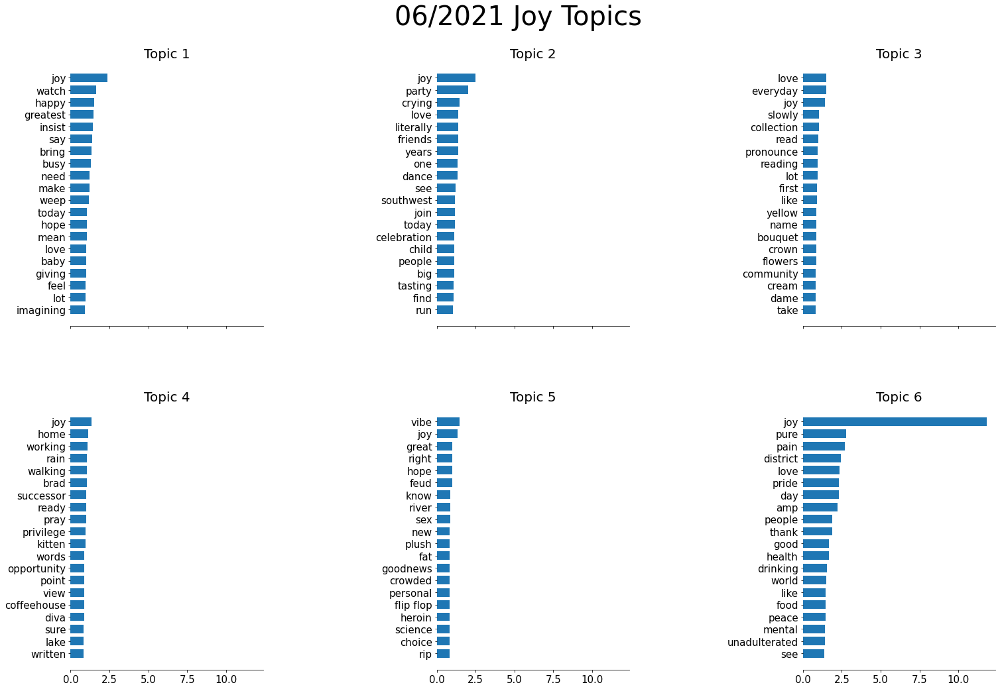

/tmp/ipykernel_183409/1762620162.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  full_df['month'] = months


<Figure size 432x288 with 0 Axes>

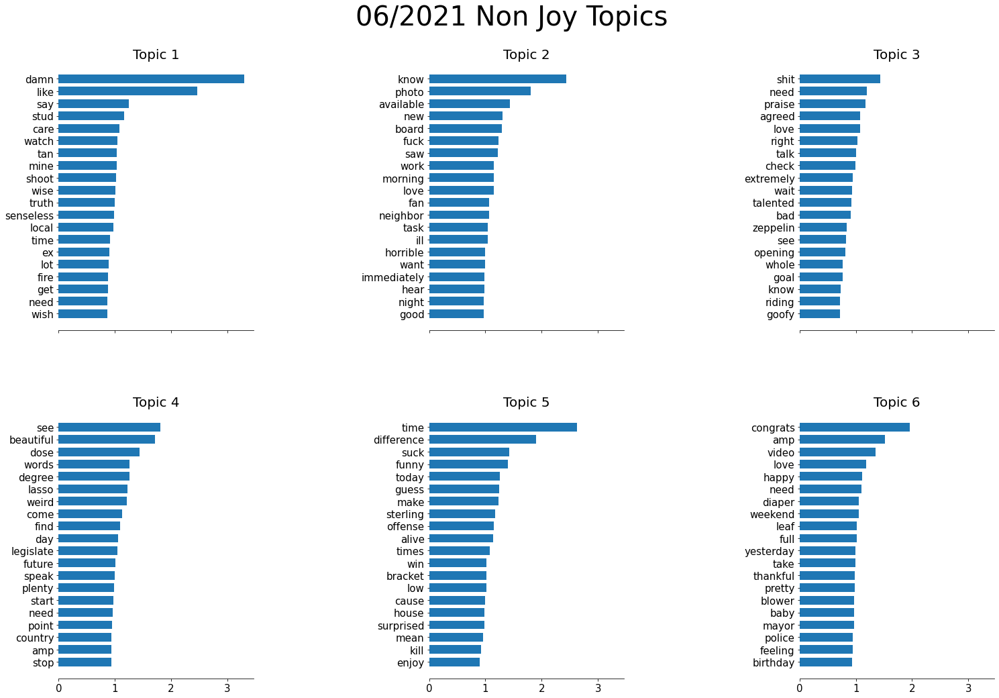

/tmp/ipykernel_183409/1762620162.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  full_df['month'] = months


<Figure size 432x288 with 0 Axes>

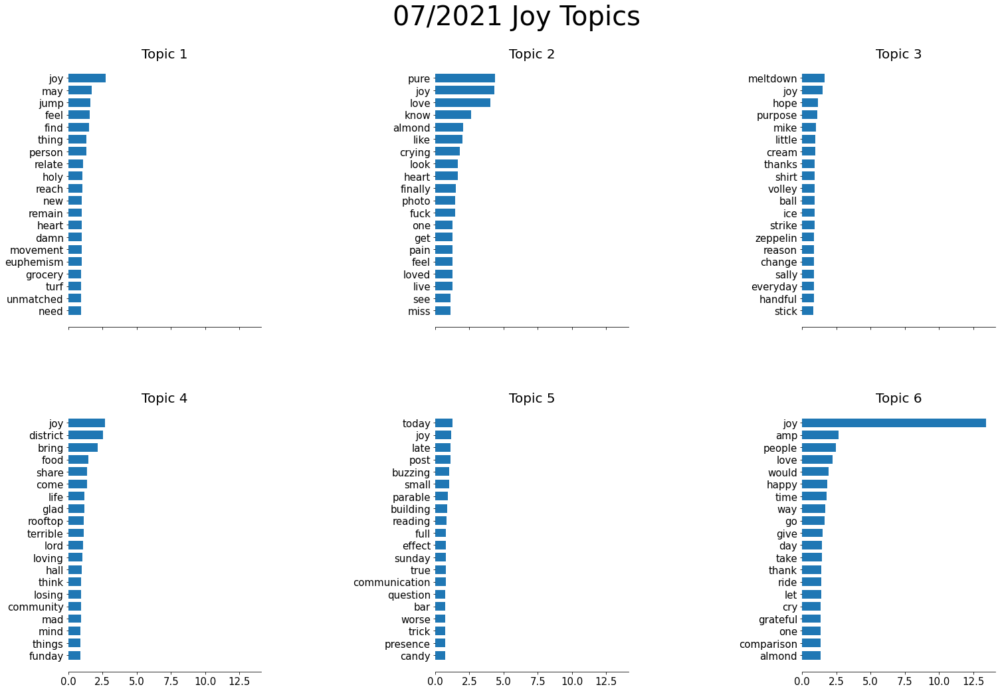

/tmp/ipykernel_183409/1762620162.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  full_df['month'] = months


<Figure size 432x288 with 0 Axes>

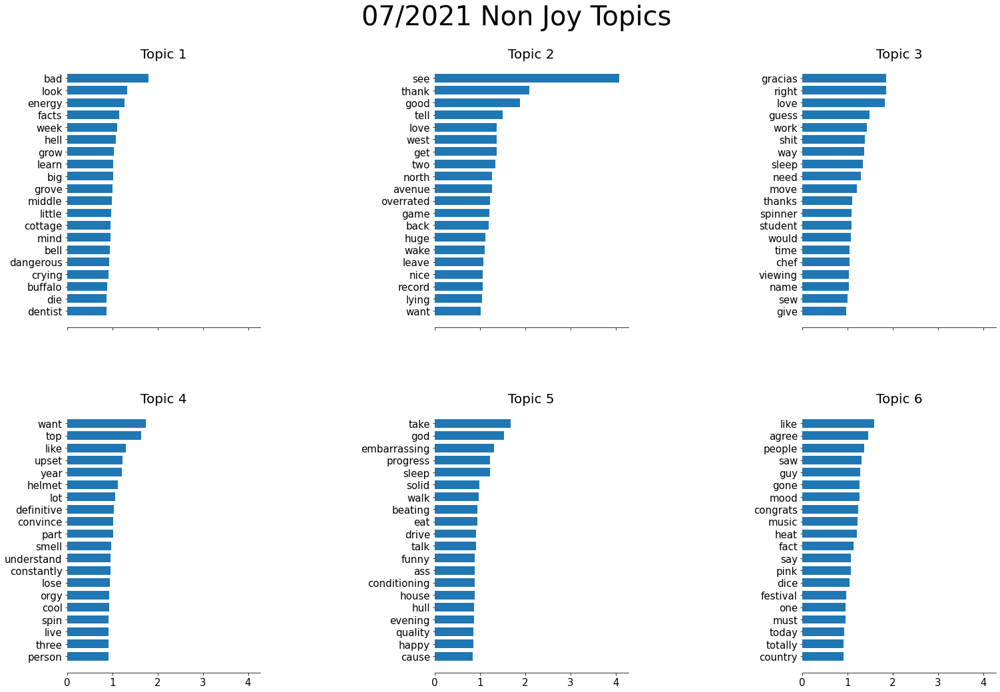

/tmp/ipykernel_183409/1762620162.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  full_df['month'] = months


<Figure size 432x288 with 0 Axes>

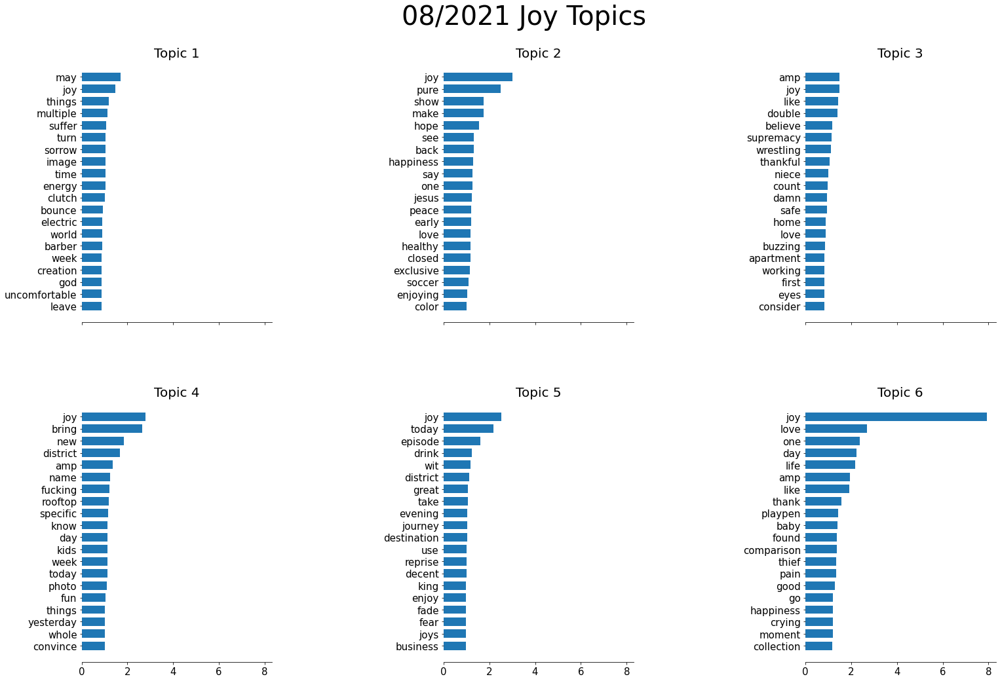

/tmp/ipykernel_183409/1762620162.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  full_df['month'] = months


<Figure size 432x288 with 0 Axes>

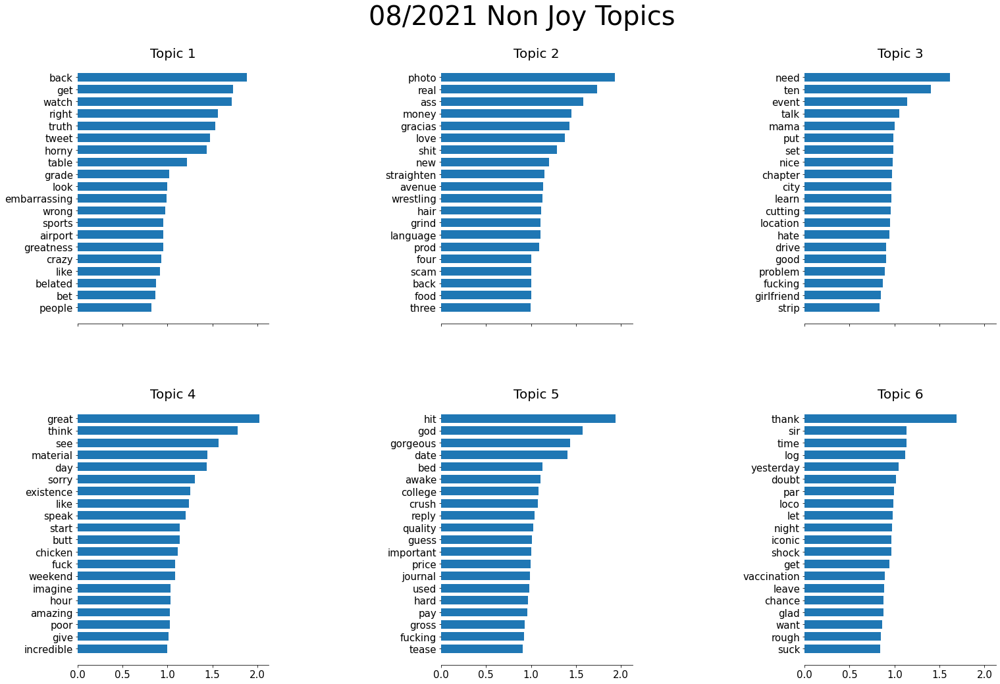

/tmp/ipykernel_183409/1762620162.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  full_df['month'] = months


<Figure size 432x288 with 0 Axes>

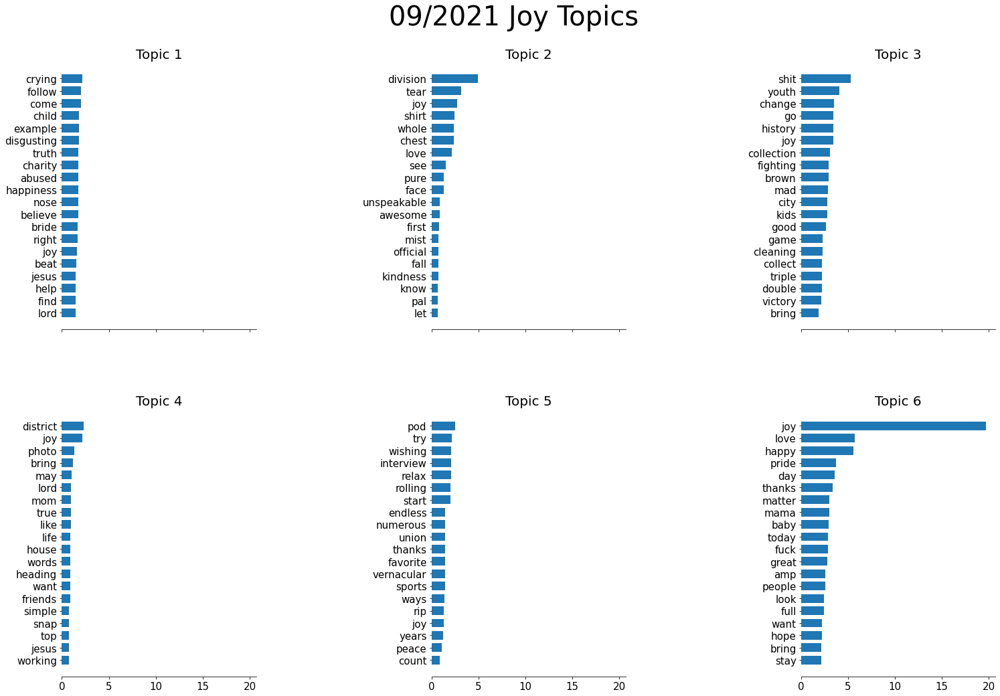

/tmp/ipykernel_183409/1762620162.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  full_df['month'] = months


<Figure size 432x288 with 0 Axes>

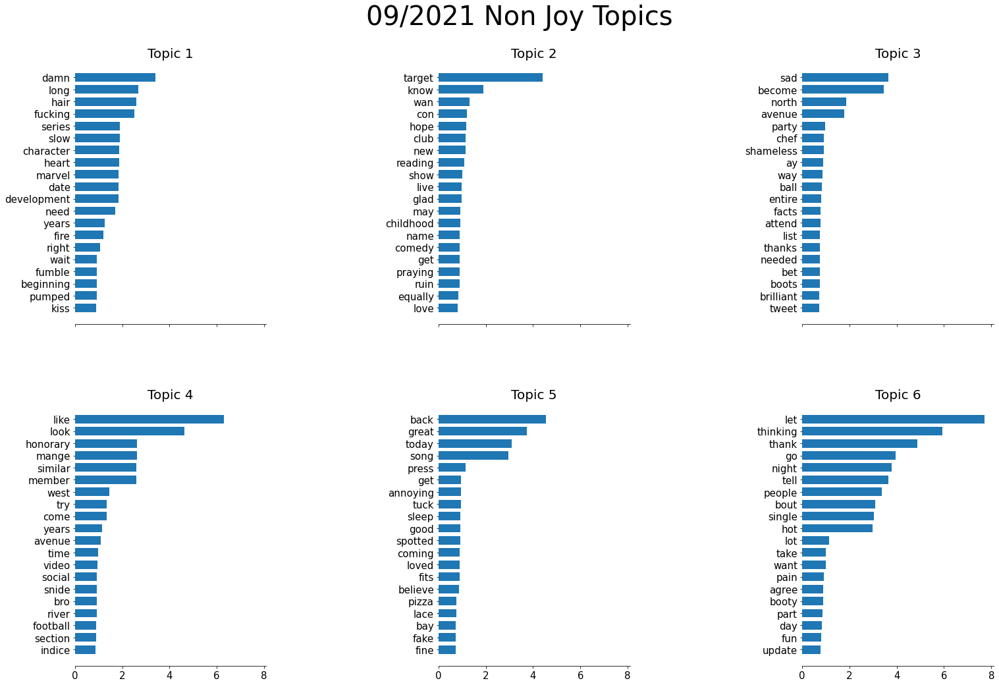

/tmp/ipykernel_183409/1762620162.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  full_df['month'] = months


<Figure size 432x288 with 0 Axes>

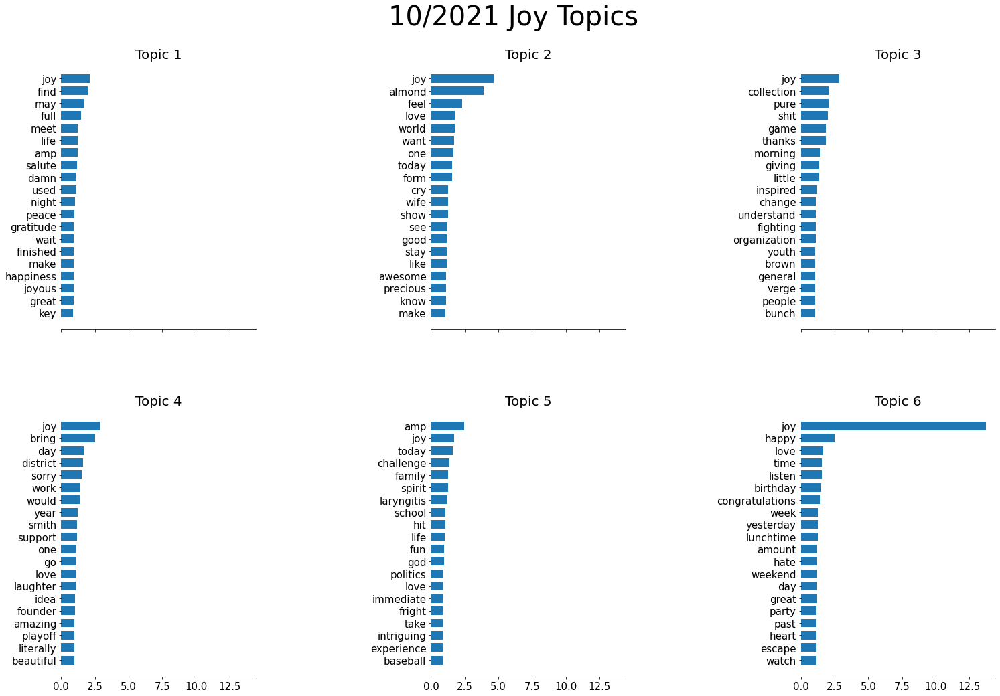

/tmp/ipykernel_183409/1762620162.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  full_df['month'] = months


<Figure size 432x288 with 0 Axes>

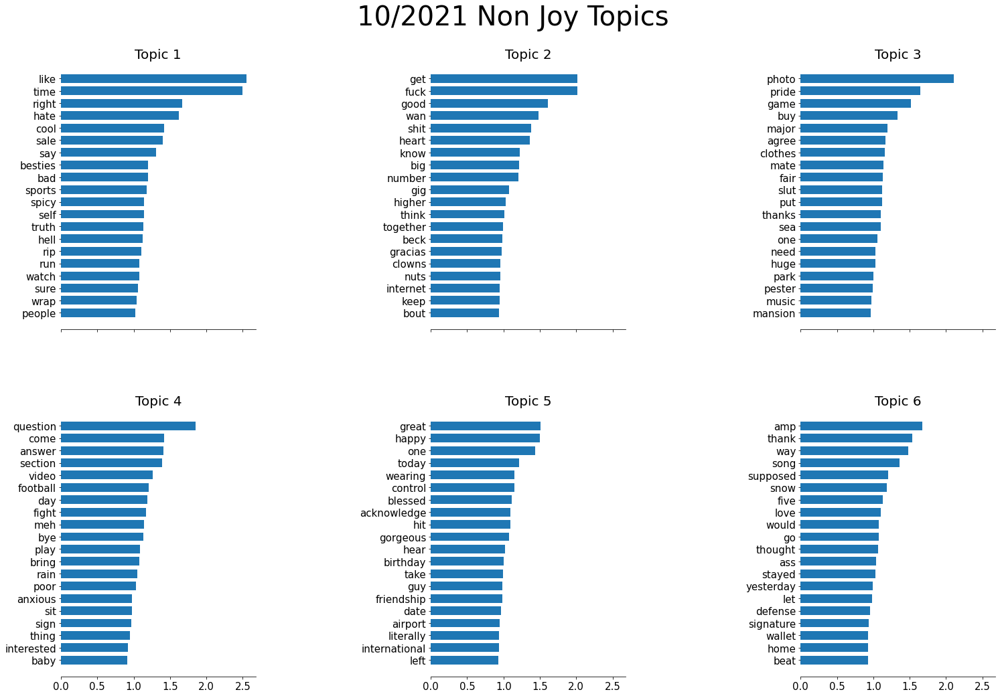

/tmp/ipykernel_183409/1762620162.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  full_df['month'] = months


<Figure size 432x288 with 0 Axes>

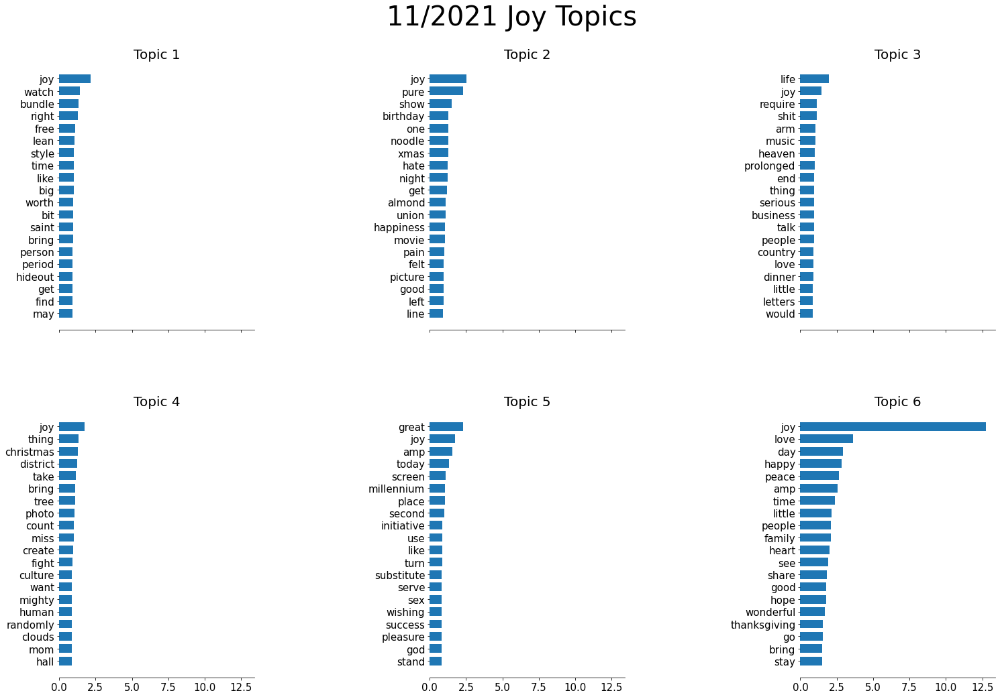

/tmp/ipykernel_183409/1762620162.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  full_df['month'] = months


<Figure size 432x288 with 0 Axes>

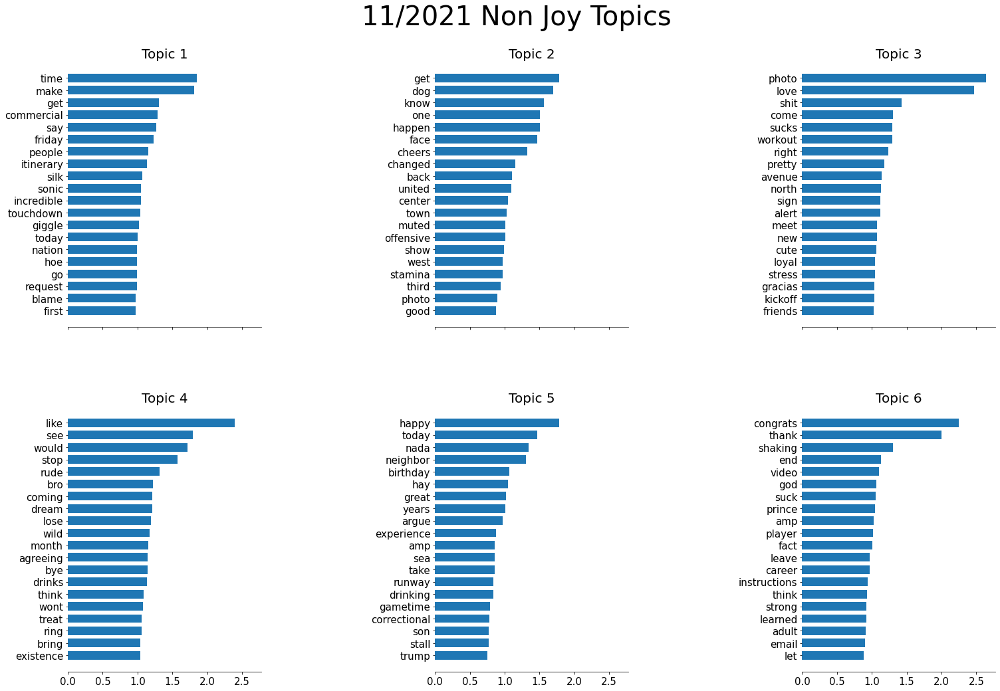

/tmp/ipykernel_183409/1762620162.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  full_df['month'] = months


<Figure size 432x288 with 0 Axes>

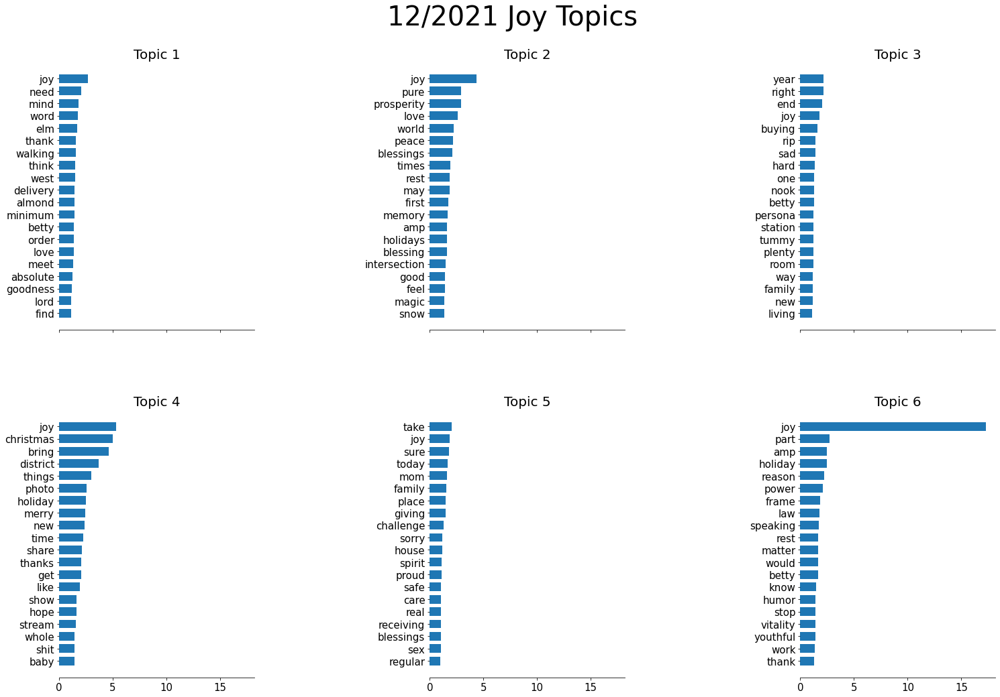

/tmp/ipykernel_183409/1762620162.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  full_df['month'] = months


<Figure size 432x288 with 0 Axes>

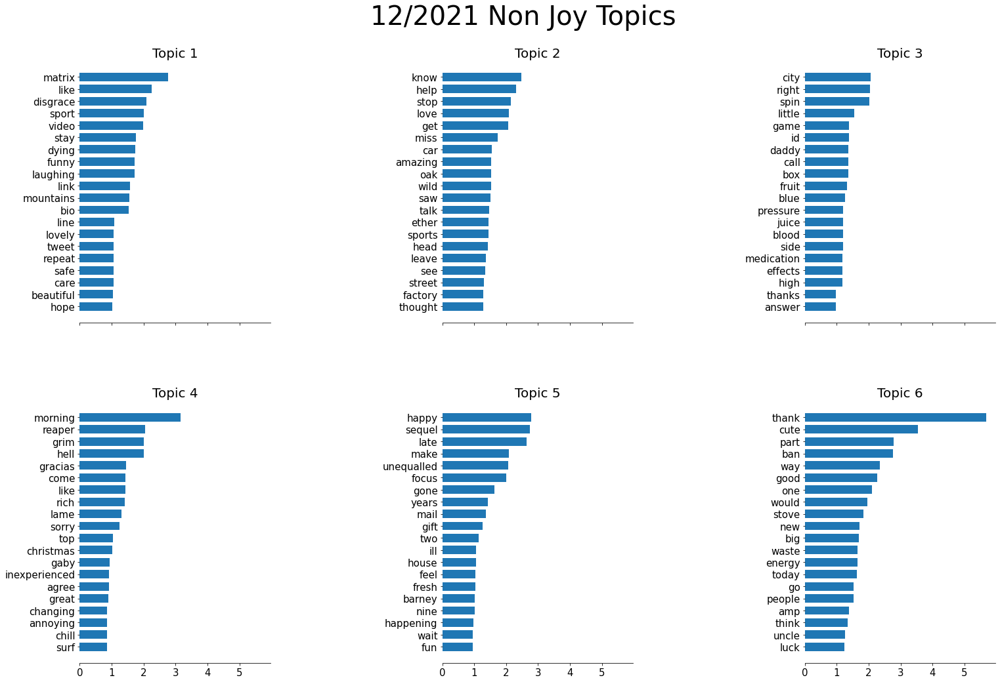

/tmp/ipykernel_183409/1762620162.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  full_df['month'] = months


<Figure size 432x288 with 0 Axes>

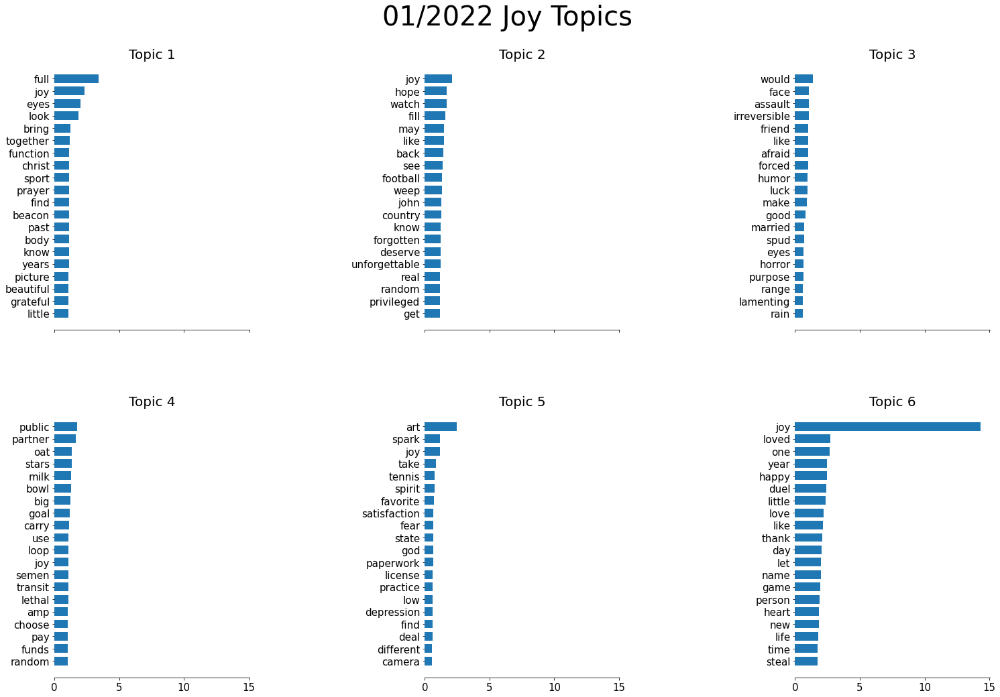

/tmp/ipykernel_183409/1762620162.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  full_df['month'] = months


<Figure size 432x288 with 0 Axes>

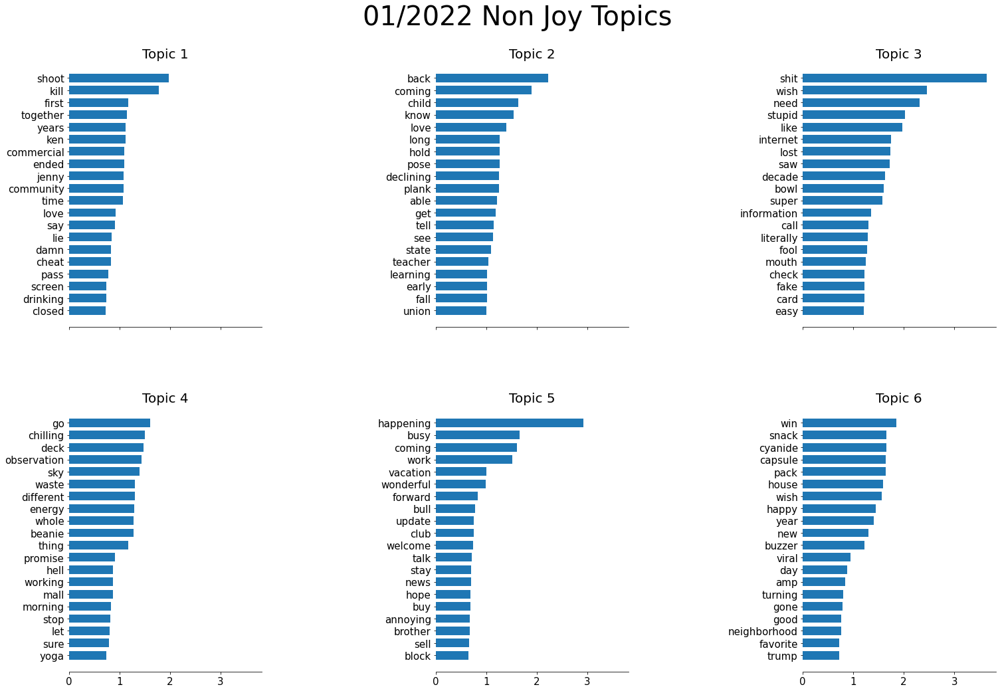

<Figure size 432x288 with 0 Axes>

In [44]:
# perform topic modeling on a given month    
def month_topic_modeling(month_list, full_df, topics_label):
    
    # create a month column for the full_df
    months = []
    for date in full_df['date']:
        month = str(date[5:7]) + '/' + str(date[0:4])
        months.append(month)
    full_df['month'] = months

    # subset the dataframe for only the given month
    month = str(month_list[0]) + '/' + str(month_list[1])
    df_month = full_df[full_df['month'] == month]


    vectorizer = TfidfVectorizer(vocabulary = terms, ngram_range=(1,2))
    vectors = vectorizer.fit_transform(df_month['clean_tweet'].values.astype('U'))


    lda_model = LatentDirichletAllocation(
        n_components = 6,
        max_iter = 10,
        learning_method = 'online',
        learning_offset = 50,
        random_state = 32
    )
    lda_vectors = lda_model.fit(vectors)
    
    n_top_words = 20
    feature_names = vectorizer.get_feature_names_out()
    
    title = month + topics_label
    plot_top_words(lda_model, feature_names, n_top_words, title)

        


# create a list of all months and their years we are interested in
dates = pd.date_range(start = '09/01/2019', end = '01/31/2022', freq = 'M')

list_months = []
for date in dates:
    date = str(date).split('-')
    year = date[0]
    month = date[1]
    list_months.append([month, year])
    
    
df_joy = df[df['ijoy'] == 1]
df_nojoy = df[df['ijoy'] == 0]


for month in list_months:
    month_topic_modeling(month, df_joy, " Joy Topics")
    month_topic_modeling(month, df_nojoy, " Non Joy Topics")


In [12]:
# count the number of features in the tweets that also appear in the valence/arousal dataset
vectorizer2 = CountVectorizer()
vectors = vectorizer2.fit_transform(df['clean_tweet'].values.astype('U'))
data_features = vectorizer2.get_feature_names_out()

count = 0
for word in data_features:
    if word in terms.keys():
        count += 1

# return as a percentage
print(count/len(data_features))

# count each occurrence of a word from the valence/arousal dataset in the tweets
all_tweets = ""
for tweet in df['clean_tweet']:
    all_tweets += str(tweet)
    all_tweets += " "
 
count2 = 0
for word in all_tweets.split(" "):
    if word in terms.keys():
        count2 += 1

# return as a percentage
print(count2/len(all_tweets.split(" ")))

0.20351605420583568
0.512655710349645


In [13]:
# check percentage of emojis in the data that are face emojis
face_emojis = 0
other_emojis = 0
for emojis in df['emoji_meanings']:
    emojis = emojis.strip('[')
    emojis = emojis.strip(']')
    emojis = emojis.strip("'")
    emojis = emojis.split(', ')
    if len(emojis) != 0:
        for emoji in value:
            
        for meaning in emojis:
            if "face" in meaning:
                face_emojis += 1
            else:
                other_emojis += 1

total = face_emojis + other_emojis
print(face_emojis/total)
print(other_emojis/total)
print(total)


0.15587915845367875
0.8441208415463213
24859


In [8]:
import emot

emot_obj = emot.core.emot()

emojis_count = 0
included_emojis = []

for tweet in df['clean_tweet']:  
    emojis = emot_obj.emoji(tweet) 
    for emoji in emojis['value']:
        if emoji in terms.keys():
            emojis_count += 1
            if emoji not in included_emojis:
                included_emojis.append(emoji)
    
# total number of times an emoji in the dataset was used in a tweet
print(emojis_count)
# number of unique emojis that show up in both datasets
# 183 actually recognized and contain nonzeros in the vectors
print(len(included_emojis))
# list of emojis in the dataset included in the tweets
print(included_emojis)

7841
383
['😎', '💞', '💙', '🐻', '⬇', '😢', '😭', '💀', '👊', '✨', '💜', '💕', '❤', '🎶', '🌈', '💥', '🎂', '🌒', '🌓', '🌔', '🌙', '🌹', '📷', '😮', '🏁', '😁', '🏈', '😍', '😘', '👏', '👍', '😃', '🍅', '😋', '😊', '🌺', '🐝', '🌱', '👶', '🍼', '🔥', '🍺', '❗', '😅', '😂', '🎁', '🍁', '🙏', '👎', '😏', '🏆', '👑', '💃', '🙌', '😀', '😫', '🌞', '😬', '🌟', '💖', '👗', '😉', '😱', '😔', '⚡', '🍯', '🍎', '💯', '💋', '💔', '⏳', '☺', '👀', '💪', '🍀', '🍑', '😪', '🚨', '🚀', '😒', '😳', '📻', '😈', '☀', '🙊', '💤', '🌻', '😹', '😑', '😝', '💉', '☹', '😌', '🎃', '😡', '♥', '😥', '▪', '🌿', '😩', '💦', '🎈', '🎊', '🎉', '💝', '📖', '⚽', '😓', '🌸', '⛄', '☕', '🎼', '🎹', '🎸', '😻', '🎡', '💗', '💫', '🌎', '🍻', '🍷', '🍹', '®', '📚', '🍰', '😤', '✌', '🐈', '💛', '🌳', '🌲', '🎭', '😇', '❄', '🎥', '🌊', '👻', '✔', '💎', '🔒', '🐖', '😕', '🐲', '🏉', '💩', '🍊', '👌', '😶', '🐧', '🐼', '🐶', '🐱', '💒', '💚', '💍', '🎀', '😛', '🍆', '😠', '☮', '🙀', '🐂', '🍚', '🍛', '⭐', '💐', '🆓', '⬅', '⬆', '🍂', '👫', '💌', '🏀', '🚬', '🗽', '✅', '😄', '✏', '✈', '😴', '💓', '♌', '🍒', '🎧', '🍃', '👉', '🌚', '😆', '😞', '🐘', '⚪', '🍪', '🍫', '🍭', '🎄', '🎅', '☝', '😜', 